In [1]:
import tensorflow as tf

In [2]:
tf.__version__

'2.14.0'

In [3]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
from tensorflow.keras.initializers import RandomNormal
import time

from IPython import display

In [4]:
(train_images, train_labels), (_, _) = tf.keras.datasets.cifar10.load_data()
# cat only
train_images = train_images[train_labels.flatten() == 3]

170498071/170498071 [==============================] - 2s 0us/step


In [5]:
train_images = train_images.reshape(train_images.shape[0], 32, 32, 3).astype('float32')
train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

In [6]:
train_images.shape

(5000, 32, 32, 3)

In [7]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [8]:
# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [22]:
def make_generator_model(z_dim=100, n_filter=64):

    init = RandomNormal(stddev=0.02)

    G = tf.keras.Sequential()
    G.add(layers.Dense(2*2*n_filter*8, input_shape=(z_dim,), use_bias=True, kernel_initializer=init))

    # 2*2*512
    G.add(layers.Reshape((2, 2, n_filter*8)))
    G.add(layers.BatchNormalization())
    G.add(layers.LeakyReLU(0.2))

    # Additional layers can be added here as needed
    # Example: G.add(SomeLayer(...))

    # 4*4*256
    G.add(layers.Conv2DTranspose(n_filter*4, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    G.add(layers.BatchNormalization())
    G.add(layers.LeakyReLU(0.2))

    # 8*8*128
    G.add(layers.Conv2DTranspose(n_filter*2, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    G.add(layers.BatchNormalization())
    G.add(layers.LeakyReLU(0.2))

    # 16*16*64
    G.add(layers.Conv2DTranspose(n_filter, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    G.add(layers.BatchNormalization())
    G.add(layers.LeakyReLU(0.2))

    # 32*32*3
    G.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    G.add(layers.BatchNormalization())
    G.add(layers.Activation('tanh'))


    return G


In [23]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
print(generated_image.shape)
print(generated_image)
#plt.imshow(generated_image[0])

(1, 32, 32, 3)
tf.Tensor(
[[[[ 3.5205972e-04  7.0541387e-04  1.0644564e-04]
   [-9.1251633e-05 -9.0002205e-04 -1.1769220e-03]
   [-1.0238998e-03  1.7880204e-03 -1.7283071e-04]
   ...
   [ 1.0863406e-04  3.6722279e-04 -7.9282123e-04]
   [ 4.3697277e-04  2.2375456e-03 -9.7861257e-04]
   [-9.3415007e-04  3.6081957e-04  1.7669774e-04]]

  [[ 6.7279185e-04 -5.0812901e-04  2.5796713e-04]
   [ 1.8389983e-03  1.0222116e-03 -5.8435759e-04]
   [-1.2669767e-03 -1.3349531e-03 -1.0160160e-03]
   ...
   [-2.2809654e-03  3.8125971e-03 -3.7951772e-03]
   [ 6.9263281e-04 -1.7531842e-03 -7.9373666e-04]
   [-3.3759570e-03 -1.4694900e-03  3.4074741e-04]]

  [[ 8.8977517e-04  2.1729755e-04  7.1811088e-04]
   [-6.8599090e-04  6.5337354e-04  2.5744952e-04]
   [ 3.9684409e-04  2.0496342e-03  1.3506553e-03]
   ...
   [-2.0718270e-03  3.6660822e-03  1.1840338e-03]
   [ 3.0319609e-03  2.7391319e-03 -1.9860684e-03]
   [-6.6966627e-04 -7.5769512e-04 -8.4632257e-04]]

  ...

  [[-1.4216205e-03 -4.0828768e-04 -9.149

In [24]:
def make_discriminator_model(input_shape=(32, 32, 3), n_filter=64):

    init = RandomNormal(stddev=0.02)

    D = tf.keras.Sequential()

    # 16*16*64
    D.add(layers.Conv2D(n_filter, input_shape=input_shape, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    D.add(layers.LeakyReLU(0.2))

    # 8*8*128
    D.add(layers.Conv2D(n_filter * 2, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    D.add(layers.BatchNormalization())
    D.add(layers.LeakyReLU(0.2))

    # 4*4*256
    D.add(layers.Conv2D(n_filter * 4, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    D.add(layers.BatchNormalization())
    D.add(layers.LeakyReLU(0.2))

    # 2*2*512
    D.add(layers.Conv2D(n_filter * 8, kernel_size=(5, 5), strides=2, padding='same', use_bias=True, kernel_initializer=init))
    D.add(layers.BatchNormalization())
    D.add(layers.LeakyReLU(0.2))

    D.add(layers.Flatten())
    D.add(layers.Dense(1, kernel_initializer=init))

    return D


In [25]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[-9.996846e-06]], shape=(1, 1), dtype=float32)


In [26]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [27]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [28]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [29]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [30]:
EPOCHS = 300
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [31]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [32]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow((predictions[i, :, :, :] + 1.0) / 2.0)
      plt.axis('off')

  plt.show()

In [33]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    #display.clear_output(wait=True)
    if (epoch % 20) == 0:
        generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  #display.clear_output(wait=True)
  #generate_and_save_images(generator, epochs, seed)

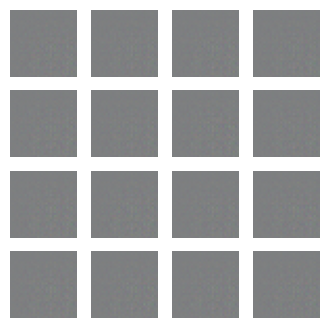

Time for epoch 1 is 9.392758846282959 sec
Time for epoch 2 is 3.4420039653778076 sec
Time for epoch 3 is 3.612619161605835 sec
Time for epoch 4 is 3.6373045444488525 sec
Time for epoch 5 is 3.695951223373413 sec
Time for epoch 6 is 3.717515230178833 sec
Time for epoch 7 is 3.7862887382507324 sec
Time for epoch 8 is 3.817746877670288 sec
Time for epoch 9 is 3.8255491256713867 sec
Time for epoch 10 is 3.8104050159454346 sec
Time for epoch 11 is 3.7774646282196045 sec
Time for epoch 12 is 3.7242517471313477 sec
Time for epoch 13 is 3.6927192211151123 sec
Time for epoch 14 is 3.6567413806915283 sec
Time for epoch 15 is 3.621265411376953 sec
Time for epoch 16 is 3.6384530067443848 sec
Time for epoch 17 is 3.616886615753174 sec
Time for epoch 18 is 3.594169855117798 sec
Time for epoch 19 is 3.5757217407226562 sec
Time for epoch 20 is 3.580413818359375 sec


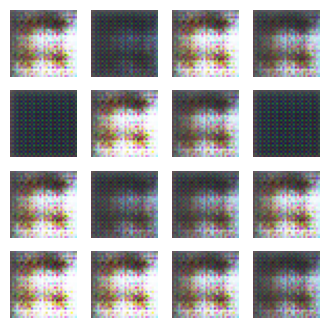

Time for epoch 21 is 4.483474254608154 sec
Time for epoch 22 is 3.469287633895874 sec
Time for epoch 23 is 3.578195333480835 sec
Time for epoch 24 is 3.598079204559326 sec
Time for epoch 25 is 3.6096622943878174 sec
Time for epoch 26 is 3.6322009563446045 sec
Time for epoch 27 is 3.6305325031280518 sec
Time for epoch 28 is 3.6504414081573486 sec
Time for epoch 29 is 3.6701438426971436 sec
Time for epoch 30 is 3.6871113777160645 sec
Time for epoch 31 is 3.690131902694702 sec
Time for epoch 32 is 3.698525905609131 sec
Time for epoch 33 is 3.7014269828796387 sec
Time for epoch 34 is 3.697277307510376 sec
Time for epoch 35 is 3.691675901412964 sec
Time for epoch 36 is 3.6757586002349854 sec
Time for epoch 37 is 3.677347421646118 sec
Time for epoch 38 is 3.658210515975952 sec
Time for epoch 39 is 3.627387046813965 sec
Time for epoch 40 is 3.6247684955596924 sec


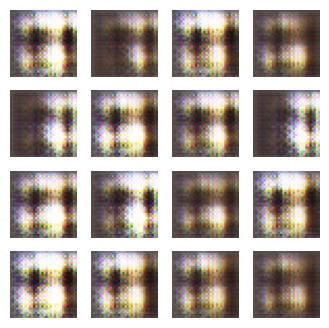

Time for epoch 41 is 4.181391954421997 sec
Time for epoch 42 is 3.4865214824676514 sec
Time for epoch 43 is 3.6274235248565674 sec
Time for epoch 44 is 3.624349594116211 sec
Time for epoch 45 is 3.6278600692749023 sec
Time for epoch 46 is 3.624148368835449 sec
Time for epoch 47 is 3.6199562549591064 sec
Time for epoch 48 is 3.6563918590545654 sec
Time for epoch 49 is 3.5957987308502197 sec
Time for epoch 50 is 3.6344377994537354 sec
Time for epoch 51 is 3.627837896347046 sec
Time for epoch 52 is 3.657299041748047 sec
Time for epoch 53 is 3.650002956390381 sec
Time for epoch 54 is 3.6625092029571533 sec
Time for epoch 55 is 3.6560935974121094 sec
Time for epoch 56 is 3.6942410469055176 sec
Time for epoch 57 is 3.6292402744293213 sec
Time for epoch 58 is 3.6656458377838135 sec
Time for epoch 59 is 3.654705047607422 sec
Time for epoch 60 is 3.653073787689209 sec


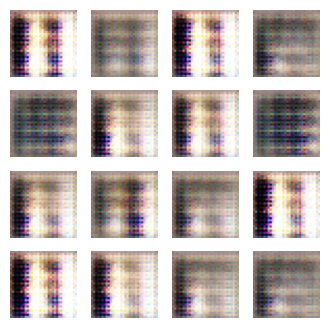

Time for epoch 61 is 4.426437854766846 sec
Time for epoch 62 is 3.5040476322174072 sec
Time for epoch 63 is 3.6313540935516357 sec
Time for epoch 64 is 3.6370983123779297 sec
Time for epoch 65 is 3.6244194507598877 sec
Time for epoch 66 is 3.6558008193969727 sec
Time for epoch 67 is 3.6051254272460938 sec
Time for epoch 68 is 3.624497175216675 sec
Time for epoch 69 is 3.6242265701293945 sec
Time for epoch 70 is 3.6235876083374023 sec
Time for epoch 71 is 3.621513843536377 sec
Time for epoch 72 is 3.6185224056243896 sec
Time for epoch 73 is 3.620929718017578 sec
Time for epoch 74 is 3.623922824859619 sec
Time for epoch 75 is 3.6201553344726562 sec
Time for epoch 76 is 3.6300389766693115 sec
Time for epoch 77 is 3.6261212825775146 sec
Time for epoch 78 is 3.6230013370513916 sec
Time for epoch 79 is 3.6249492168426514 sec
Time for epoch 80 is 3.6208136081695557 sec


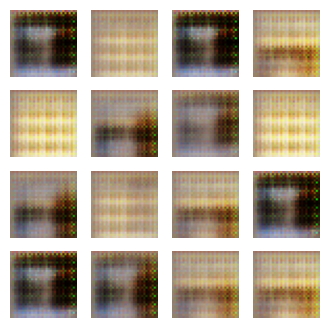

Time for epoch 81 is 4.292078018188477 sec
Time for epoch 82 is 3.4939653873443604 sec
Time for epoch 83 is 3.6197915077209473 sec
Time for epoch 84 is 3.621446132659912 sec
Time for epoch 85 is 3.62247371673584 sec
Time for epoch 86 is 3.6197316646575928 sec
Time for epoch 87 is 3.6218411922454834 sec
Time for epoch 88 is 3.6206212043762207 sec
Time for epoch 89 is 3.6259043216705322 sec
Time for epoch 90 is 3.618340492248535 sec
Time for epoch 91 is 3.620856761932373 sec
Time for epoch 92 is 3.622702121734619 sec
Time for epoch 93 is 3.6224610805511475 sec
Time for epoch 94 is 3.6250007152557373 sec
Time for epoch 95 is 3.623979330062866 sec
Time for epoch 96 is 3.6250410079956055 sec
Time for epoch 97 is 3.621795892715454 sec
Time for epoch 98 is 3.624823570251465 sec
Time for epoch 99 is 3.620429754257202 sec
Time for epoch 100 is 3.6227738857269287 sec


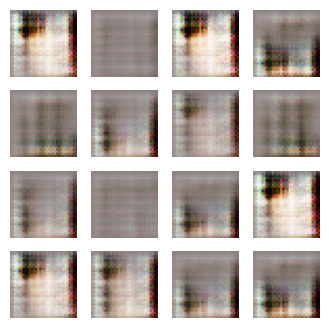

Time for epoch 101 is 4.174263000488281 sec
Time for epoch 102 is 3.541508674621582 sec
Time for epoch 103 is 3.5958445072174072 sec
Time for epoch 104 is 3.618739128112793 sec
Time for epoch 105 is 3.6227128505706787 sec
Time for epoch 106 is 3.622478485107422 sec
Time for epoch 107 is 3.626124143600464 sec
Time for epoch 108 is 3.6171536445617676 sec
Time for epoch 109 is 3.6233201026916504 sec
Time for epoch 110 is 3.6191885471343994 sec
Time for epoch 111 is 3.633080244064331 sec
Time for epoch 112 is 3.635154962539673 sec
Time for epoch 113 is 3.622621536254883 sec
Time for epoch 114 is 3.6265509128570557 sec
Time for epoch 115 is 3.645371913909912 sec
Time for epoch 116 is 3.603780746459961 sec
Time for epoch 117 is 3.6405208110809326 sec
Time for epoch 118 is 3.6287660598754883 sec
Time for epoch 119 is 3.6201210021972656 sec
Time for epoch 120 is 3.6208653450012207 sec


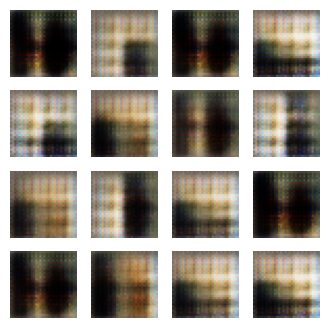

Time for epoch 121 is 4.150420665740967 sec
Time for epoch 122 is 3.4989376068115234 sec
Time for epoch 123 is 3.626551866531372 sec
Time for epoch 124 is 3.6258625984191895 sec
Time for epoch 125 is 3.6386396884918213 sec
Time for epoch 126 is 3.6653964519500732 sec
Time for epoch 127 is 3.617276191711426 sec
Time for epoch 128 is 3.638819932937622 sec
Time for epoch 129 is 3.6528122425079346 sec
Time for epoch 130 is 3.6238040924072266 sec
Time for epoch 131 is 3.6456410884857178 sec
Time for epoch 132 is 3.644371509552002 sec
Time for epoch 133 is 3.648117780685425 sec
Time for epoch 134 is 3.646754741668701 sec
Time for epoch 135 is 3.651301383972168 sec
Time for epoch 136 is 3.6567416191101074 sec
Time for epoch 137 is 3.654569625854492 sec
Time for epoch 138 is 3.6581060886383057 sec
Time for epoch 139 is 3.682739019393921 sec
Time for epoch 140 is 3.6250531673431396 sec


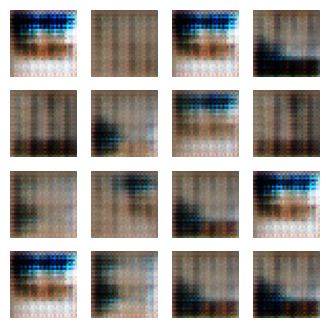

Time for epoch 141 is 4.186080455780029 sec
Time for epoch 142 is 3.494553565979004 sec
Time for epoch 143 is 3.644683837890625 sec
Time for epoch 144 is 3.647953510284424 sec
Time for epoch 145 is 3.641957998275757 sec
Time for epoch 146 is 3.6363282203674316 sec
Time for epoch 147 is 3.648451328277588 sec
Time for epoch 148 is 3.6546614170074463 sec
Time for epoch 149 is 3.650282859802246 sec
Time for epoch 150 is 3.6495912075042725 sec
Time for epoch 151 is 3.6481266021728516 sec
Time for epoch 152 is 3.6285746097564697 sec
Time for epoch 153 is 3.6459779739379883 sec
Time for epoch 154 is 3.6434566974639893 sec
Time for epoch 155 is 3.645763874053955 sec
Time for epoch 156 is 3.6400251388549805 sec
Time for epoch 157 is 3.64212703704834 sec
Time for epoch 158 is 3.646467447280884 sec
Time for epoch 159 is 3.652299404144287 sec
Time for epoch 160 is 3.6527249813079834 sec


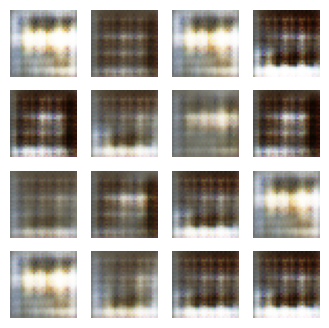

Time for epoch 161 is 4.47920823097229 sec
Time for epoch 162 is 3.538670301437378 sec
Time for epoch 163 is 5.102459907531738 sec
Time for epoch 164 is 3.4825007915496826 sec
Time for epoch 165 is 3.6217029094696045 sec
Time for epoch 166 is 3.657836437225342 sec
Time for epoch 167 is 3.592127561569214 sec
Time for epoch 168 is 3.627666711807251 sec
Time for epoch 169 is 3.627779722213745 sec
Time for epoch 170 is 3.622316837310791 sec
Time for epoch 171 is 3.646489381790161 sec
Time for epoch 172 is 3.6467788219451904 sec
Time for epoch 173 is 3.621562957763672 sec
Time for epoch 174 is 3.6421144008636475 sec
Time for epoch 175 is 3.6281557083129883 sec
Time for epoch 176 is 3.6638190746307373 sec
Time for epoch 177 is 3.6380584239959717 sec
Time for epoch 178 is 3.6180334091186523 sec
Time for epoch 179 is 3.6367406845092773 sec
Time for epoch 180 is 3.6543519496917725 sec


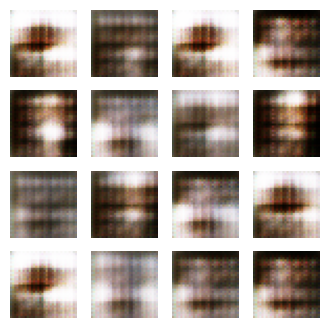

Time for epoch 181 is 4.3666369915008545 sec
Time for epoch 182 is 3.5027732849121094 sec
Time for epoch 183 is 3.641021728515625 sec
Time for epoch 184 is 3.6252968311309814 sec
Time for epoch 185 is 3.6359782218933105 sec
Time for epoch 186 is 3.640841007232666 sec
Time for epoch 187 is 3.655578136444092 sec
Time for epoch 188 is 3.641930341720581 sec
Time for epoch 189 is 3.66229248046875 sec
Time for epoch 190 is 3.65865159034729 sec
Time for epoch 191 is 3.6430599689483643 sec
Time for epoch 192 is 3.649384021759033 sec
Time for epoch 193 is 3.6557068824768066 sec
Time for epoch 194 is 3.649277448654175 sec
Time for epoch 195 is 3.647017002105713 sec
Time for epoch 196 is 3.6464972496032715 sec
Time for epoch 197 is 3.6754684448242188 sec
Time for epoch 198 is 3.602198362350464 sec
Time for epoch 199 is 3.627175807952881 sec
Time for epoch 200 is 3.6408026218414307 sec


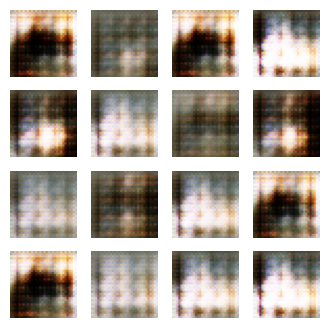

Time for epoch 201 is 4.150971174240112 sec
Time for epoch 202 is 3.50787615776062 sec
Time for epoch 203 is 3.645826816558838 sec
Time for epoch 204 is 3.59269118309021 sec
Time for epoch 205 is 3.625051736831665 sec
Time for epoch 206 is 3.6586670875549316 sec
Time for epoch 207 is 3.591554641723633 sec
Time for epoch 208 is 3.622694730758667 sec
Time for epoch 209 is 3.6230275630950928 sec
Time for epoch 210 is 3.618227005004883 sec
Time for epoch 211 is 3.6217281818389893 sec
Time for epoch 212 is 3.6414244174957275 sec
Time for epoch 213 is 3.623364210128784 sec
Time for epoch 214 is 3.6232686042785645 sec
Time for epoch 215 is 3.6186439990997314 sec
Time for epoch 216 is 3.619753122329712 sec
Time for epoch 217 is 3.621203660964966 sec
Time for epoch 218 is 3.6562161445617676 sec
Time for epoch 219 is 3.5852935314178467 sec
Time for epoch 220 is 3.6199097633361816 sec


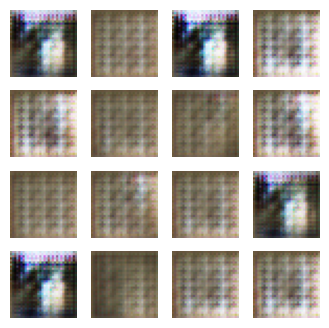

Time for epoch 221 is 4.34420108795166 sec
Time for epoch 222 is 3.5043232440948486 sec
Time for epoch 223 is 3.627239465713501 sec
Time for epoch 224 is 3.6239559650421143 sec
Time for epoch 225 is 3.6654751300811768 sec
Time for epoch 226 is 3.5853164196014404 sec
Time for epoch 227 is 3.6223533153533936 sec
Time for epoch 228 is 3.621829032897949 sec
Time for epoch 229 is 3.6227755546569824 sec
Time for epoch 230 is 3.6189775466918945 sec
Time for epoch 231 is 3.621602773666382 sec
Time for epoch 232 is 3.6192049980163574 sec
Time for epoch 233 is 3.6187801361083984 sec
Time for epoch 234 is 3.6227927207946777 sec
Time for epoch 235 is 3.620203733444214 sec
Time for epoch 236 is 3.6221773624420166 sec
Time for epoch 237 is 3.6202750205993652 sec
Time for epoch 238 is 3.62221097946167 sec
Time for epoch 239 is 3.620915651321411 sec
Time for epoch 240 is 3.625312089920044 sec


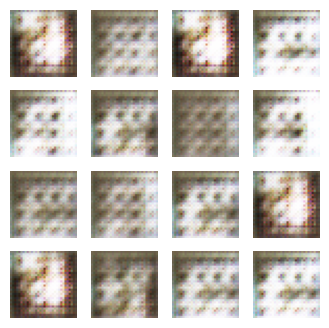

Time for epoch 241 is 4.434050798416138 sec
Time for epoch 242 is 3.4727866649627686 sec
Time for epoch 243 is 3.661839485168457 sec
Time for epoch 244 is 3.5918006896972656 sec
Time for epoch 245 is 3.6266040802001953 sec
Time for epoch 246 is 3.616088390350342 sec
Time for epoch 247 is 3.6221847534179688 sec
Time for epoch 248 is 3.6203818321228027 sec
Time for epoch 249 is 3.6245272159576416 sec
Time for epoch 250 is 3.6261518001556396 sec
Time for epoch 251 is 3.632023334503174 sec
Time for epoch 252 is 3.6435129642486572 sec
Time for epoch 253 is 3.6496846675872803 sec
Time for epoch 254 is 3.6501457691192627 sec
Time for epoch 255 is 3.6796834468841553 sec
Time for epoch 256 is 3.618516445159912 sec
Time for epoch 257 is 3.650970220565796 sec
Time for epoch 258 is 3.6451005935668945 sec
Time for epoch 259 is 3.642671823501587 sec
Time for epoch 260 is 3.649484872817993 sec


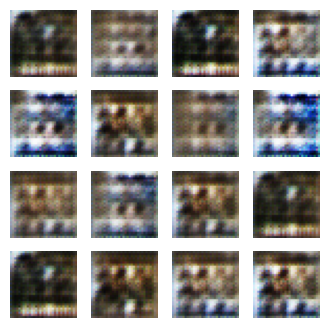

Time for epoch 261 is 4.189712285995483 sec
Time for epoch 262 is 3.5608019828796387 sec
Time for epoch 263 is 3.59352970123291 sec
Time for epoch 264 is 3.6450634002685547 sec
Time for epoch 265 is 3.642134666442871 sec
Time for epoch 266 is 3.6447794437408447 sec
Time for epoch 267 is 3.6446850299835205 sec
Time for epoch 268 is 3.6567111015319824 sec
Time for epoch 269 is 3.6782004833221436 sec
Time for epoch 270 is 3.608722448348999 sec
Time for epoch 271 is 3.6453235149383545 sec
Time for epoch 272 is 3.644157886505127 sec
Time for epoch 273 is 3.648961305618286 sec
Time for epoch 274 is 3.645409345626831 sec
Time for epoch 275 is 3.651477336883545 sec
Time for epoch 276 is 3.634634494781494 sec
Time for epoch 277 is 3.6477315425872803 sec
Time for epoch 278 is 3.636997699737549 sec
Time for epoch 279 is 3.6276071071624756 sec
Time for epoch 280 is 3.64509916305542 sec


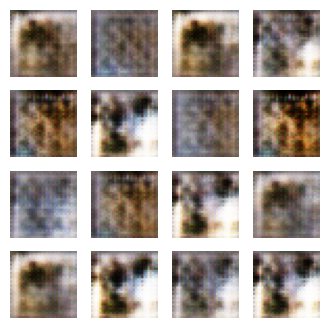

Time for epoch 281 is 4.169223308563232 sec
Time for epoch 282 is 3.513836622238159 sec
Time for epoch 283 is 3.6309478282928467 sec
Time for epoch 284 is 3.648940086364746 sec
Time for epoch 285 is 3.6421091556549072 sec
Time for epoch 286 is 3.6400485038757324 sec
Time for epoch 287 is 3.6222517490386963 sec
Time for epoch 288 is 3.6477036476135254 sec
Time for epoch 289 is 3.62138032913208 sec
Time for epoch 290 is 3.640547513961792 sec
Time for epoch 291 is 3.6785624027252197 sec
Time for epoch 292 is 3.594075918197632 sec
Time for epoch 293 is 3.6547906398773193 sec
Time for epoch 294 is 3.6423141956329346 sec
Time for epoch 295 is 3.626636505126953 sec
Time for epoch 296 is 3.63791561126709 sec
Time for epoch 297 is 3.63089919090271 sec
Time for epoch 298 is 3.6281349658966064 sec
Time for epoch 299 is 3.6311967372894287 sec
Time for epoch 300 is 3.6231436729431152 sec


In [34]:
train(train_dataset, EPOCHS)

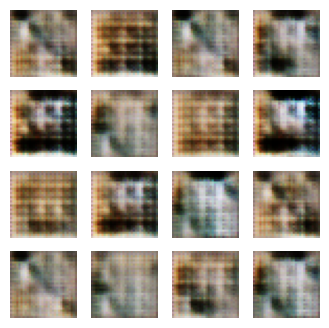

Time for epoch 1 is 4.125647068023682 sec
Time for epoch 2 is 3.4612669944763184 sec
Time for epoch 3 is 3.6201062202453613 sec
Time for epoch 4 is 3.7022292613983154 sec
Time for epoch 5 is 3.6729164123535156 sec
Time for epoch 6 is 3.7506747245788574 sec
Time for epoch 7 is 3.7974307537078857 sec
Time for epoch 8 is 3.821072816848755 sec
Time for epoch 9 is 3.8189709186553955 sec
Time for epoch 10 is 3.814546823501587 sec
Time for epoch 11 is 3.7545218467712402 sec
Time for epoch 12 is 3.713261604309082 sec
Time for epoch 13 is 3.6782753467559814 sec
Time for epoch 14 is 3.650465488433838 sec
Time for epoch 15 is 3.621030330657959 sec
Time for epoch 16 is 3.62086820602417 sec
Time for epoch 17 is 3.6348536014556885 sec
Time for epoch 18 is 3.563142776489258 sec
Time for epoch 19 is 3.5896124839782715 sec
Time for epoch 20 is 3.5803139209747314 sec


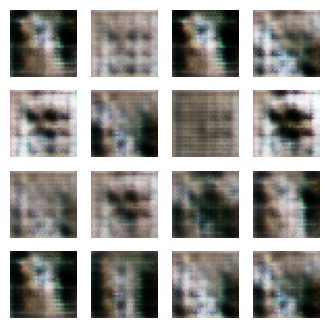

Time for epoch 21 is 4.136970520019531 sec
Time for epoch 22 is 3.4449212551116943 sec
Time for epoch 23 is 3.6222081184387207 sec
Time for epoch 24 is 3.5741384029388428 sec
Time for epoch 25 is 3.620396852493286 sec
Time for epoch 26 is 3.6340532302856445 sec
Time for epoch 27 is 3.62681245803833 sec
Time for epoch 28 is 3.6646218299865723 sec
Time for epoch 29 is 3.6772818565368652 sec
Time for epoch 30 is 3.721198797225952 sec
Time for epoch 31 is 3.6580662727355957 sec
Time for epoch 32 is 3.7011101245880127 sec
Time for epoch 33 is 3.701699733734131 sec
Time for epoch 34 is 3.701636552810669 sec
Time for epoch 35 is 3.6846089363098145 sec
Time for epoch 36 is 3.6807150840759277 sec
Time for epoch 37 is 3.6729960441589355 sec
Time for epoch 38 is 3.6528244018554688 sec
Time for epoch 39 is 3.624647378921509 sec
Time for epoch 40 is 3.626061201095581 sec


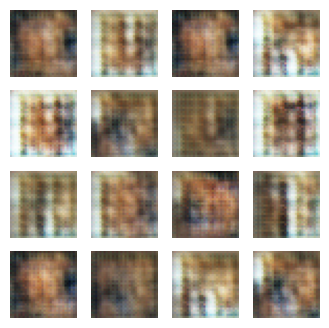

Time for epoch 41 is 4.688873052597046 sec
Time for epoch 42 is 3.4642422199249268 sec
Time for epoch 43 is 3.6210787296295166 sec
Time for epoch 44 is 3.622929573059082 sec
Time for epoch 45 is 3.6229965686798096 sec
Time for epoch 46 is 3.6227638721466064 sec
Time for epoch 47 is 3.6221179962158203 sec
Time for epoch 48 is 3.6268820762634277 sec
Time for epoch 49 is 3.6192731857299805 sec
Time for epoch 50 is 3.6432290077209473 sec
Time for epoch 51 is 3.660120964050293 sec
Time for epoch 52 is 3.6584131717681885 sec
Time for epoch 53 is 3.6653945446014404 sec
Time for epoch 54 is 3.6651084423065186 sec
Time for epoch 55 is 3.666855812072754 sec
Time for epoch 56 is 3.66737961769104 sec
Time for epoch 57 is 3.6644234657287598 sec
Time for epoch 58 is 3.6535675525665283 sec
Time for epoch 59 is 3.646111488342285 sec
Time for epoch 60 is 3.653630018234253 sec


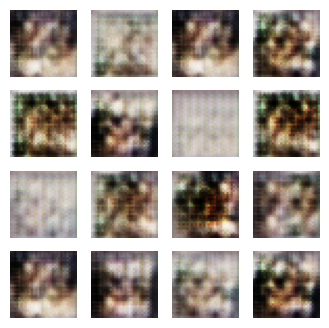

Time for epoch 61 is 4.180333137512207 sec
Time for epoch 62 is 3.5016305446624756 sec
Time for epoch 63 is 3.622291088104248 sec
Time for epoch 64 is 3.620357036590576 sec
Time for epoch 65 is 3.6230037212371826 sec
Time for epoch 66 is 3.621715784072876 sec
Time for epoch 67 is 3.6224617958068848 sec
Time for epoch 68 is 3.6195693016052246 sec
Time for epoch 69 is 3.6203696727752686 sec
Time for epoch 70 is 3.658952236175537 sec
Time for epoch 71 is 3.5834527015686035 sec
Time for epoch 72 is 3.6198227405548096 sec
Time for epoch 73 is 3.621833324432373 sec
Time for epoch 74 is 3.6530134677886963 sec
Time for epoch 75 is 3.5929694175720215 sec
Time for epoch 76 is 3.625274419784546 sec
Time for epoch 77 is 3.625455617904663 sec
Time for epoch 78 is 3.6263177394866943 sec
Time for epoch 79 is 3.622546434402466 sec
Time for epoch 80 is 3.621352195739746 sec


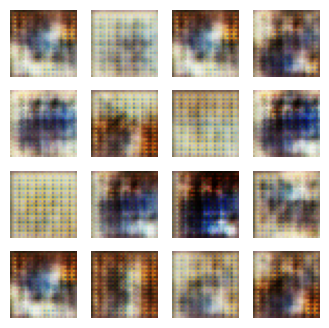

Time for epoch 81 is 4.238678932189941 sec
Time for epoch 82 is 3.486345052719116 sec
Time for epoch 83 is 3.6207470893859863 sec
Time for epoch 84 is 3.6115992069244385 sec
Time for epoch 85 is 3.6381454467773438 sec
Time for epoch 86 is 3.6197004318237305 sec
Time for epoch 87 is 3.621727228164673 sec
Time for epoch 88 is 3.6218507289886475 sec
Time for epoch 89 is 3.6252622604370117 sec
Time for epoch 90 is 3.620626926422119 sec
Time for epoch 91 is 3.6225876808166504 sec
Time for epoch 92 is 3.622035264968872 sec
Time for epoch 93 is 3.6358940601348877 sec
Time for epoch 94 is 3.634230613708496 sec
Time for epoch 95 is 3.6244430541992188 sec
Time for epoch 96 is 3.6263041496276855 sec
Time for epoch 97 is 3.6498019695281982 sec
Time for epoch 98 is 3.5970516204833984 sec
Time for epoch 99 is 3.6214287281036377 sec
Time for epoch 100 is 3.6258413791656494 sec


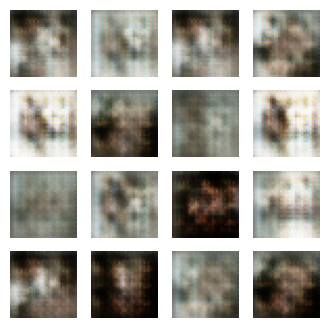

Time for epoch 101 is 4.155359506607056 sec
Time for epoch 102 is 3.5069420337677 sec
Time for epoch 103 is 3.6225478649139404 sec
Time for epoch 104 is 3.6237573623657227 sec
Time for epoch 105 is 3.6191518306732178 sec
Time for epoch 106 is 3.623486042022705 sec
Time for epoch 107 is 3.6234097480773926 sec
Time for epoch 108 is 3.6216466426849365 sec
Time for epoch 109 is 3.640305519104004 sec
Time for epoch 110 is 3.6181366443634033 sec
Time for epoch 111 is 5.102539777755737 sec
Time for epoch 112 is 3.4878461360931396 sec
Time for epoch 113 is 3.6327524185180664 sec
Time for epoch 114 is 3.6620850563049316 sec
Time for epoch 115 is 3.590902328491211 sec
Time for epoch 116 is 3.6254332065582275 sec
Time for epoch 117 is 3.621978521347046 sec
Time for epoch 118 is 3.6251718997955322 sec
Time for epoch 119 is 5.102810859680176 sec
Time for epoch 120 is 3.482003927230835 sec


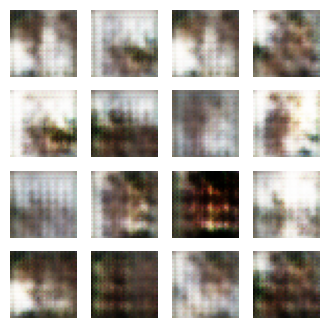

Time for epoch 121 is 4.695748805999756 sec
Time for epoch 122 is 3.4913716316223145 sec
Time for epoch 123 is 3.6224780082702637 sec
Time for epoch 124 is 3.6217868328094482 sec
Time for epoch 125 is 3.6587209701538086 sec
Time for epoch 126 is 3.589124917984009 sec
Time for epoch 127 is 3.629305601119995 sec
Time for epoch 128 is 3.6386139392852783 sec
Time for epoch 129 is 3.6292073726654053 sec
Time for epoch 130 is 3.623271942138672 sec
Time for epoch 131 is 3.646023988723755 sec
Time for epoch 132 is 3.649885654449463 sec
Time for epoch 133 is 3.647014617919922 sec
Time for epoch 134 is 3.664379835128784 sec
Time for epoch 135 is 3.6585352420806885 sec
Time for epoch 136 is 5.101284980773926 sec
Time for epoch 137 is 3.494152069091797 sec
Time for epoch 138 is 3.6434547901153564 sec
Time for epoch 139 is 3.6454923152923584 sec
Time for epoch 140 is 3.6431477069854736 sec


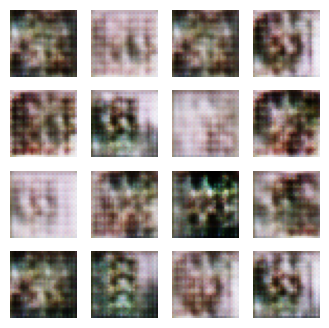

Time for epoch 141 is 4.167557954788208 sec
Time for epoch 142 is 3.503706693649292 sec
Time for epoch 143 is 3.638845920562744 sec
Time for epoch 144 is 3.6396055221557617 sec
Time for epoch 145 is 3.6279547214508057 sec
Time for epoch 146 is 3.646223545074463 sec
Time for epoch 147 is 3.6492795944213867 sec
Time for epoch 148 is 3.6489815711975098 sec
Time for epoch 149 is 3.657775402069092 sec
Time for epoch 150 is 3.632241725921631 sec
Time for epoch 151 is 3.6421959400177 sec
Time for epoch 152 is 3.6486079692840576 sec
Time for epoch 153 is 3.655479669570923 sec
Time for epoch 154 is 3.658850908279419 sec
Time for epoch 155 is 3.659950017929077 sec
Time for epoch 156 is 3.6610491275787354 sec
Time for epoch 157 is 3.6646416187286377 sec
Time for epoch 158 is 3.657872200012207 sec
Time for epoch 159 is 3.665884256362915 sec
Time for epoch 160 is 3.6621313095092773 sec


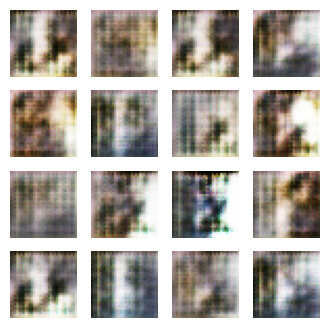

Time for epoch 161 is 4.382089138031006 sec
Time for epoch 162 is 3.5229275226593018 sec
Time for epoch 163 is 3.65632700920105 sec
Time for epoch 164 is 3.6578831672668457 sec
Time for epoch 165 is 3.6540756225585938 sec
Time for epoch 166 is 3.656035900115967 sec
Time for epoch 167 is 3.6478655338287354 sec
Time for epoch 168 is 3.6495039463043213 sec
Time for epoch 169 is 3.6610617637634277 sec
Time for epoch 170 is 3.643895387649536 sec
Time for epoch 171 is 3.64589786529541 sec
Time for epoch 172 is 3.6552734375 sec
Time for epoch 173 is 3.6494719982147217 sec
Time for epoch 174 is 3.6416497230529785 sec
Time for epoch 175 is 3.640533685684204 sec
Time for epoch 176 is 3.6572940349578857 sec
Time for epoch 177 is 3.6557259559631348 sec
Time for epoch 178 is 3.670517683029175 sec
Time for epoch 179 is 3.615471839904785 sec
Time for epoch 180 is 3.6600048542022705 sec


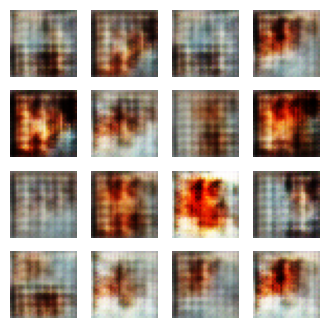

Time for epoch 181 is 4.187645673751831 sec
Time for epoch 182 is 3.5165982246398926 sec
Time for epoch 183 is 3.627358913421631 sec
Time for epoch 184 is 3.622879981994629 sec
Time for epoch 185 is 3.625102996826172 sec
Time for epoch 186 is 3.624300956726074 sec
Time for epoch 187 is 3.629150867462158 sec
Time for epoch 188 is 3.626958131790161 sec
Time for epoch 189 is 3.62616229057312 sec
Time for epoch 190 is 3.6399474143981934 sec
Time for epoch 191 is 3.624089241027832 sec
Time for epoch 192 is 3.642409086227417 sec
Time for epoch 193 is 3.642071485519409 sec
Time for epoch 194 is 3.6274759769439697 sec
Time for epoch 195 is 3.619647264480591 sec
Time for epoch 196 is 3.6367928981781006 sec
Time for epoch 197 is 3.6346845626831055 sec
Time for epoch 198 is 3.6692819595336914 sec
Time for epoch 199 is 3.630817174911499 sec
Time for epoch 200 is 3.604459762573242 sec


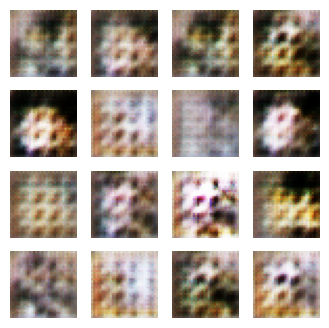

Time for epoch 201 is 4.14282751083374 sec
Time for epoch 202 is 3.5415492057800293 sec
Time for epoch 203 is 3.5885889530181885 sec
Time for epoch 204 is 3.6255054473876953 sec
Time for epoch 205 is 3.627089738845825 sec
Time for epoch 206 is 3.623991012573242 sec
Time for epoch 207 is 3.626640796661377 sec
Time for epoch 208 is 3.6308107376098633 sec
Time for epoch 209 is 3.637491464614868 sec
Time for epoch 210 is 3.643261194229126 sec
Time for epoch 211 is 3.633324146270752 sec
Time for epoch 212 is 3.6552958488464355 sec
Time for epoch 213 is 3.6545801162719727 sec
Time for epoch 214 is 3.6271815299987793 sec
Time for epoch 215 is 3.6483163833618164 sec
Time for epoch 216 is 3.6507601737976074 sec
Time for epoch 217 is 3.654827833175659 sec
Time for epoch 218 is 3.6427416801452637 sec
Time for epoch 219 is 3.640667200088501 sec
Time for epoch 220 is 3.6797738075256348 sec


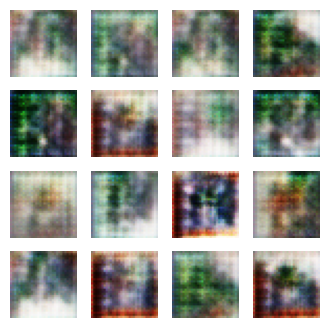

Time for epoch 221 is 4.424834728240967 sec
Time for epoch 222 is 3.4706380367279053 sec
Time for epoch 223 is 3.6290760040283203 sec
Time for epoch 224 is 5.102899789810181 sec
Time for epoch 225 is 3.4955387115478516 sec
Time for epoch 226 is 3.6215600967407227 sec
Time for epoch 227 is 3.627584934234619 sec
Time for epoch 228 is 3.6377975940704346 sec
Time for epoch 229 is 3.6430201530456543 sec
Time for epoch 230 is 3.6373417377471924 sec
Time for epoch 231 is 3.6475939750671387 sec
Time for epoch 232 is 3.6430985927581787 sec
Time for epoch 233 is 3.6417689323425293 sec
Time for epoch 234 is 3.6450698375701904 sec
Time for epoch 235 is 3.6416828632354736 sec
Time for epoch 236 is 3.6286845207214355 sec
Time for epoch 237 is 3.652566909790039 sec
Time for epoch 238 is 3.659182548522949 sec
Time for epoch 239 is 3.636303186416626 sec
Time for epoch 240 is 3.6558027267456055 sec


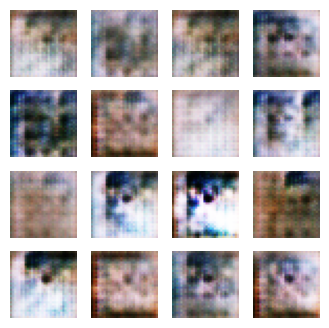

Time for epoch 241 is 4.186296224594116 sec
Time for epoch 242 is 3.5307271480560303 sec
Time for epoch 243 is 3.6447033882141113 sec
Time for epoch 244 is 3.653994560241699 sec
Time for epoch 245 is 3.6502888202667236 sec
Time for epoch 246 is 3.6568987369537354 sec
Time for epoch 247 is 3.6547837257385254 sec
Time for epoch 248 is 3.6543781757354736 sec
Time for epoch 249 is 3.6846532821655273 sec
Time for epoch 250 is 3.631139039993286 sec
Time for epoch 251 is 3.6612250804901123 sec
Time for epoch 252 is 3.656332015991211 sec
Time for epoch 253 is 3.671637773513794 sec
Time for epoch 254 is 3.667598247528076 sec
Time for epoch 255 is 3.6490817070007324 sec
Time for epoch 256 is 3.659377098083496 sec
Time for epoch 257 is 3.657182455062866 sec
Time for epoch 258 is 3.661482334136963 sec
Time for epoch 259 is 3.6517226696014404 sec
Time for epoch 260 is 3.649998188018799 sec


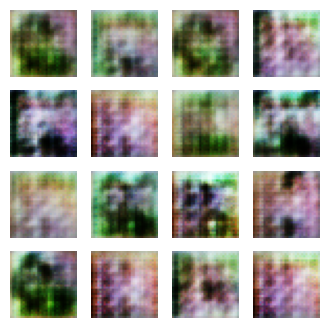

Time for epoch 261 is 4.185340404510498 sec
Time for epoch 262 is 3.5066945552825928 sec
Time for epoch 263 is 3.6846940517425537 sec
Time for epoch 264 is 3.6142749786376953 sec
Time for epoch 265 is 3.640970230102539 sec
Time for epoch 266 is 3.6419382095336914 sec
Time for epoch 267 is 3.6295158863067627 sec
Time for epoch 268 is 3.651479482650757 sec
Time for epoch 269 is 3.639249563217163 sec
Time for epoch 270 is 3.6471035480499268 sec
Time for epoch 271 is 3.66748046875 sec
Time for epoch 272 is 3.6071856021881104 sec
Time for epoch 273 is 3.643972396850586 sec
Time for epoch 274 is 3.626296281814575 sec
Time for epoch 275 is 3.6228606700897217 sec
Time for epoch 276 is 3.62375545501709 sec
Time for epoch 277 is 3.6230051517486572 sec
Time for epoch 278 is 3.6488964557647705 sec
Time for epoch 279 is 3.622701644897461 sec
Time for epoch 280 is 3.6444859504699707 sec


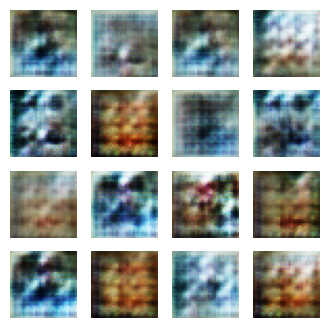

Time for epoch 281 is 4.180120468139648 sec
Time for epoch 282 is 3.508152484893799 sec
Time for epoch 283 is 3.621835708618164 sec
Time for epoch 284 is 3.634542226791382 sec
Time for epoch 285 is 3.6156389713287354 sec
Time for epoch 286 is 3.626263380050659 sec
Time for epoch 287 is 3.6210711002349854 sec
Time for epoch 288 is 3.6226918697357178 sec
Time for epoch 289 is 3.6538543701171875 sec
Time for epoch 290 is 3.595834970474243 sec
Time for epoch 291 is 3.6276304721832275 sec
Time for epoch 292 is 3.635011911392212 sec
Time for epoch 293 is 3.641404151916504 sec
Time for epoch 294 is 3.6211612224578857 sec
Time for epoch 295 is 3.6240434646606445 sec
Time for epoch 296 is 3.6262998580932617 sec
Time for epoch 297 is 3.6301183700561523 sec
Time for epoch 298 is 3.6238036155700684 sec
Time for epoch 299 is 3.6266186237335205 sec
Time for epoch 300 is 3.6208865642547607 sec


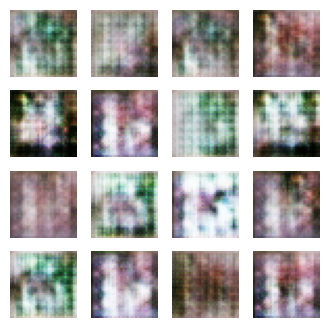

Time for epoch 301 is 4.353280067443848 sec
Time for epoch 302 is 3.495349168777466 sec
Time for epoch 303 is 3.62016224861145 sec
Time for epoch 304 is 3.6266157627105713 sec
Time for epoch 305 is 3.6379594802856445 sec
Time for epoch 306 is 3.6251707077026367 sec
Time for epoch 307 is 3.623805522918701 sec
Time for epoch 308 is 3.624603033065796 sec
Time for epoch 309 is 3.6210992336273193 sec
Time for epoch 310 is 3.627002239227295 sec
Time for epoch 311 is 3.621718168258667 sec
Time for epoch 312 is 3.625401735305786 sec
Time for epoch 313 is 3.6289865970611572 sec
Time for epoch 314 is 3.655518054962158 sec
Time for epoch 315 is 3.607693910598755 sec
Time for epoch 316 is 3.6296756267547607 sec
Time for epoch 317 is 3.6373157501220703 sec
Time for epoch 318 is 3.638730049133301 sec
Time for epoch 319 is 3.649022102355957 sec
Time for epoch 320 is 3.642421245574951 sec


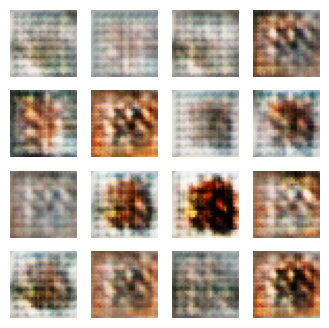

Time for epoch 321 is 4.336518049240112 sec
Time for epoch 322 is 3.507965087890625 sec
Time for epoch 323 is 3.6630101203918457 sec
Time for epoch 324 is 3.5947837829589844 sec
Time for epoch 325 is 3.643064022064209 sec
Time for epoch 326 is 3.6502726078033447 sec
Time for epoch 327 is 3.653151035308838 sec
Time for epoch 328 is 3.6433935165405273 sec
Time for epoch 329 is 3.6508116722106934 sec
Time for epoch 330 is 3.693603754043579 sec
Time for epoch 331 is 3.6068363189697266 sec
Time for epoch 332 is 3.6476402282714844 sec
Time for epoch 333 is 3.6277987957000732 sec
Time for epoch 334 is 3.650752305984497 sec
Time for epoch 335 is 3.643354892730713 sec
Time for epoch 336 is 3.6495566368103027 sec
Time for epoch 337 is 3.6575493812561035 sec
Time for epoch 338 is 3.6500768661499023 sec
Time for epoch 339 is 3.6397545337677 sec
Time for epoch 340 is 3.646104574203491 sec


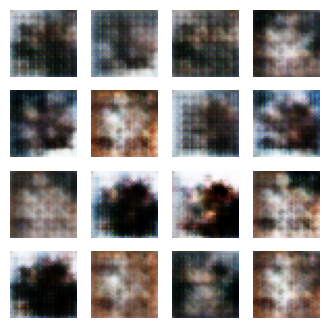

Time for epoch 341 is 4.304494380950928 sec
Time for epoch 342 is 3.5154707431793213 sec
Time for epoch 343 is 3.623811721801758 sec
Time for epoch 344 is 3.618952751159668 sec
Time for epoch 345 is 3.630156993865967 sec
Time for epoch 346 is 3.6185879707336426 sec
Time for epoch 347 is 3.62296986579895 sec
Time for epoch 348 is 3.6426570415496826 sec
Time for epoch 349 is 3.6473536491394043 sec
Time for epoch 350 is 3.621461868286133 sec
Time for epoch 351 is 3.6238555908203125 sec
Time for epoch 352 is 3.626760721206665 sec
Time for epoch 353 is 3.646775484085083 sec
Time for epoch 354 is 3.625969648361206 sec
Time for epoch 355 is 3.6412436962127686 sec
Time for epoch 356 is 3.6760990619659424 sec
Time for epoch 357 is 3.5940794944763184 sec
Time for epoch 358 is 3.6419029235839844 sec
Time for epoch 359 is 3.6249098777770996 sec
Time for epoch 360 is 3.6275558471679688 sec


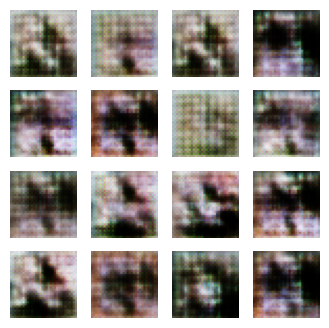

Time for epoch 361 is 4.159876108169556 sec
Time for epoch 362 is 3.50075626373291 sec
Time for epoch 363 is 3.623476982116699 sec
Time for epoch 364 is 3.6286308765411377 sec
Time for epoch 365 is 3.613863945007324 sec
Time for epoch 366 is 3.6215076446533203 sec
Time for epoch 367 is 3.645120620727539 sec
Time for epoch 368 is 3.6202802658081055 sec
Time for epoch 369 is 3.624204158782959 sec
Time for epoch 370 is 3.6415247917175293 sec
Time for epoch 371 is 3.667032480239868 sec
Time for epoch 372 is 3.5929412841796875 sec
Time for epoch 373 is 3.624321460723877 sec
Time for epoch 374 is 3.624460220336914 sec
Time for epoch 375 is 3.623288869857788 sec
Time for epoch 376 is 3.637744903564453 sec
Time for epoch 377 is 3.6445789337158203 sec
Time for epoch 378 is 3.621995687484741 sec
Time for epoch 379 is 3.6420626640319824 sec
Time for epoch 380 is 3.6241300106048584 sec


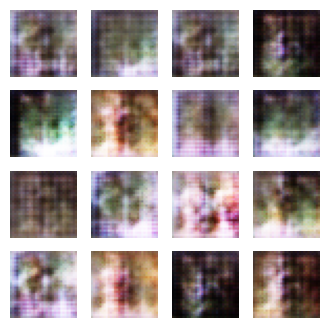

Time for epoch 381 is 4.153274297714233 sec
Time for epoch 382 is 3.5251660346984863 sec
Time for epoch 383 is 3.5932397842407227 sec
Time for epoch 384 is 3.6198058128356934 sec
Time for epoch 385 is 3.621177911758423 sec
Time for epoch 386 is 3.647265911102295 sec
Time for epoch 387 is 3.6218817234039307 sec
Time for epoch 388 is 3.6277694702148438 sec
Time for epoch 389 is 3.625246047973633 sec
Time for epoch 390 is 3.647645950317383 sec
Time for epoch 391 is 3.6238996982574463 sec
Time for epoch 392 is 3.6414685249328613 sec
Time for epoch 393 is 3.635773181915283 sec
Time for epoch 394 is 3.673724412918091 sec
Time for epoch 395 is 3.6023061275482178 sec
Time for epoch 396 is 3.6334779262542725 sec
Time for epoch 397 is 3.649737596511841 sec
Time for epoch 398 is 3.6498732566833496 sec
Time for epoch 399 is 3.648787021636963 sec
Time for epoch 400 is 3.6479437351226807 sec


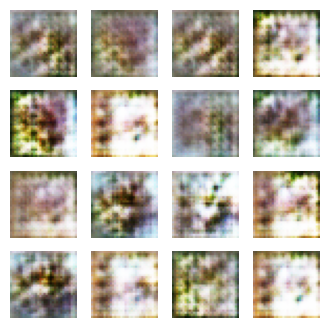

Time for epoch 401 is 4.731185674667358 sec
Time for epoch 402 is 3.489685297012329 sec
Time for epoch 403 is 3.6611521244049072 sec
Time for epoch 404 is 3.6069869995117188 sec
Time for epoch 405 is 3.645176410675049 sec
Time for epoch 406 is 3.626013994216919 sec
Time for epoch 407 is 3.6440694332122803 sec
Time for epoch 408 is 3.64951491355896 sec
Time for epoch 409 is 3.641507148742676 sec
Time for epoch 410 is 3.6559128761291504 sec
Time for epoch 411 is 3.6584558486938477 sec
Time for epoch 412 is 3.689409017562866 sec
Time for epoch 413 is 3.620476484298706 sec
Time for epoch 414 is 3.6485376358032227 sec
Time for epoch 415 is 3.665626049041748 sec
Time for epoch 416 is 3.665632963180542 sec
Time for epoch 417 is 3.6540064811706543 sec
Time for epoch 418 is 3.6623728275299072 sec
Time for epoch 419 is 3.6685760021209717 sec
Time for epoch 420 is 3.661046028137207 sec


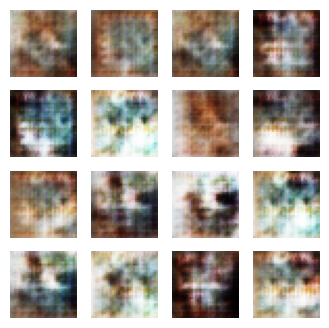

Time for epoch 421 is 4.2014758586883545 sec
Time for epoch 422 is 3.518423080444336 sec
Time for epoch 423 is 3.6531786918640137 sec
Time for epoch 424 is 3.646050453186035 sec
Time for epoch 425 is 3.6468088626861572 sec
Time for epoch 426 is 3.6489341259002686 sec
Time for epoch 427 is 3.6845037937164307 sec
Time for epoch 428 is 3.6257357597351074 sec
Time for epoch 429 is 3.6602823734283447 sec
Time for epoch 430 is 3.662526845932007 sec
Time for epoch 431 is 3.641767740249634 sec
Time for epoch 432 is 3.6476564407348633 sec
Time for epoch 433 is 3.6540260314941406 sec
Time for epoch 434 is 3.6486048698425293 sec
Time for epoch 435 is 3.6517152786254883 sec
Time for epoch 436 is 3.651235818862915 sec
Time for epoch 437 is 3.6479954719543457 sec
Time for epoch 438 is 3.6535520553588867 sec
Time for epoch 439 is 3.6465506553649902 sec
Time for epoch 440 is 3.6705100536346436 sec


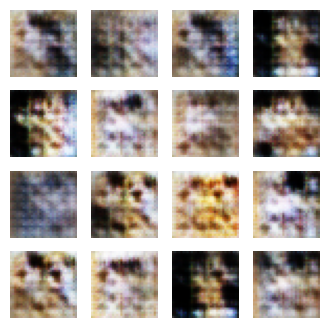

Time for epoch 441 is 4.298786401748657 sec
Time for epoch 442 is 3.5040881633758545 sec
Time for epoch 443 is 3.6051998138427734 sec
Time for epoch 444 is 3.631000518798828 sec
Time for epoch 445 is 3.6584482192993164 sec
Time for epoch 446 is 3.593036651611328 sec
Time for epoch 447 is 3.626861810684204 sec
Time for epoch 448 is 3.6366348266601562 sec
Time for epoch 449 is 3.6249260902404785 sec
Time for epoch 450 is 3.6177656650543213 sec
Time for epoch 451 is 3.6037824153900146 sec
Time for epoch 452 is 3.6252529621124268 sec
Time for epoch 453 is 3.6045525074005127 sec
Time for epoch 454 is 3.6258749961853027 sec
Time for epoch 455 is 3.6377980709075928 sec
Time for epoch 456 is 3.656836748123169 sec
Time for epoch 457 is 3.5897319316864014 sec
Time for epoch 458 is 3.643089532852173 sec
Time for epoch 459 is 3.6435024738311768 sec
Time for epoch 460 is 3.6293723583221436 sec


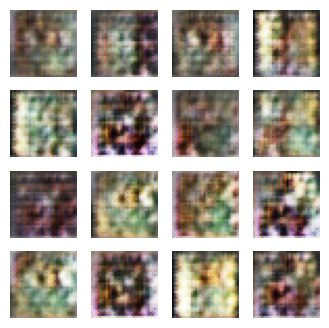

Time for epoch 461 is 4.148458003997803 sec
Time for epoch 462 is 3.479914426803589 sec
Time for epoch 463 is 3.6263816356658936 sec
Time for epoch 464 is 3.621593713760376 sec
Time for epoch 465 is 3.6244547367095947 sec
Time for epoch 466 is 3.6214516162872314 sec
Time for epoch 467 is 3.6256375312805176 sec
Time for epoch 468 is 3.620448589324951 sec
Time for epoch 469 is 3.6230766773223877 sec
Time for epoch 470 is 3.616223096847534 sec
Time for epoch 471 is 3.608253240585327 sec
Time for epoch 472 is 3.6244964599609375 sec
Time for epoch 473 is 3.6191325187683105 sec
Time for epoch 474 is 3.62111234664917 sec
Time for epoch 475 is 3.623305320739746 sec
Time for epoch 476 is 3.615833282470703 sec
Time for epoch 477 is 3.6201705932617188 sec
Time for epoch 478 is 3.622462272644043 sec
Time for epoch 479 is 3.622220993041992 sec
Time for epoch 480 is 3.6235368251800537 sec


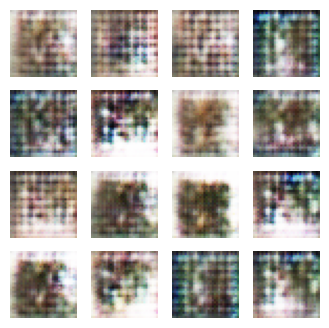

Time for epoch 481 is 4.437830448150635 sec
Time for epoch 482 is 3.5135297775268555 sec
Time for epoch 483 is 3.590109348297119 sec
Time for epoch 484 is 3.6217713356018066 sec
Time for epoch 485 is 3.6212384700775146 sec
Time for epoch 486 is 3.6253104209899902 sec
Time for epoch 487 is 3.619828939437866 sec
Time for epoch 488 is 3.6212918758392334 sec
Time for epoch 489 is 3.658275604248047 sec
Time for epoch 490 is 3.607600688934326 sec
Time for epoch 491 is 3.622203826904297 sec
Time for epoch 492 is 3.609752893447876 sec
Time for epoch 493 is 3.640831470489502 sec
Time for epoch 494 is 3.6426801681518555 sec
Time for epoch 495 is 3.6373770236968994 sec
Time for epoch 496 is 3.652994155883789 sec
Time for epoch 497 is 3.6471664905548096 sec
Time for epoch 498 is 3.646615743637085 sec
Time for epoch 499 is 3.6485607624053955 sec
Time for epoch 500 is 3.6627674102783203 sec


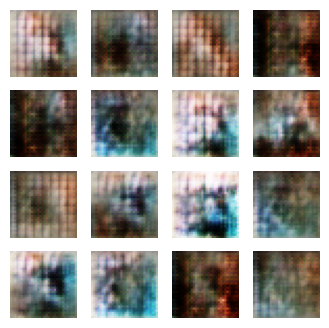

Time for epoch 501 is 4.2078187465667725 sec
Time for epoch 502 is 3.5107810497283936 sec
Time for epoch 503 is 3.658402681350708 sec
Time for epoch 504 is 3.6948275566101074 sec
Time for epoch 505 is 3.623922109603882 sec
Time for epoch 506 is 3.66477108001709 sec
Time for epoch 507 is 3.6602323055267334 sec
Time for epoch 508 is 3.6601712703704834 sec
Time for epoch 509 is 3.6609060764312744 sec
Time for epoch 510 is 3.6597347259521484 sec
Time for epoch 511 is 3.6589837074279785 sec
Time for epoch 512 is 3.651768445968628 sec
Time for epoch 513 is 3.6051368713378906 sec
Time for epoch 514 is 3.6182093620300293 sec
Time for epoch 515 is 3.677985191345215 sec
Time for epoch 516 is 3.6119377613067627 sec
Time for epoch 517 is 3.6342275142669678 sec
Time for epoch 518 is 3.6400105953216553 sec
Time for epoch 519 is 3.649744749069214 sec
Time for epoch 520 is 3.6350746154785156 sec


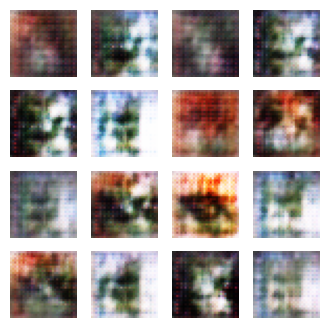

Time for epoch 521 is 4.193955898284912 sec
Time for epoch 522 is 3.500256299972534 sec
Time for epoch 523 is 3.638902187347412 sec
Time for epoch 524 is 3.646242141723633 sec
Time for epoch 525 is 3.645686149597168 sec
Time for epoch 526 is 3.6521220207214355 sec
Time for epoch 527 is 3.6546974182128906 sec
Time for epoch 528 is 3.644864082336426 sec
Time for epoch 529 is 3.642610788345337 sec
Time for epoch 530 is 3.64685320854187 sec
Time for epoch 531 is 3.6429038047790527 sec
Time for epoch 532 is 3.6462512016296387 sec
Time for epoch 533 is 3.6638591289520264 sec
Time for epoch 534 is 3.647207260131836 sec
Time for epoch 535 is 3.64632511138916 sec
Time for epoch 536 is 3.662153720855713 sec
Time for epoch 537 is 3.683701992034912 sec
Time for epoch 538 is 3.6227259635925293 sec
Time for epoch 539 is 3.6586365699768066 sec
Time for epoch 540 is 3.6583411693573 sec


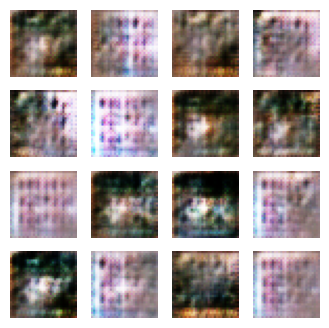

Time for epoch 541 is 4.419956922531128 sec
Time for epoch 542 is 3.4870378971099854 sec
Time for epoch 543 is 3.624946355819702 sec
Time for epoch 544 is 3.6445119380950928 sec
Time for epoch 545 is 3.6459286212921143 sec
Time for epoch 546 is 3.6501643657684326 sec
Time for epoch 547 is 3.6599514484405518 sec
Time for epoch 548 is 3.6929478645324707 sec
Time for epoch 549 is 3.605884313583374 sec
Time for epoch 550 is 3.650604009628296 sec
Time for epoch 551 is 3.6561033725738525 sec
Time for epoch 552 is 3.6554160118103027 sec
Time for epoch 553 is 3.6552207469940186 sec
Time for epoch 554 is 3.646693468093872 sec
Time for epoch 555 is 3.646920680999756 sec
Time for epoch 556 is 3.6484057903289795 sec
Time for epoch 557 is 3.6608831882476807 sec
Time for epoch 558 is 3.651040554046631 sec
Time for epoch 559 is 3.662381172180176 sec
Time for epoch 560 is 3.658810615539551 sec


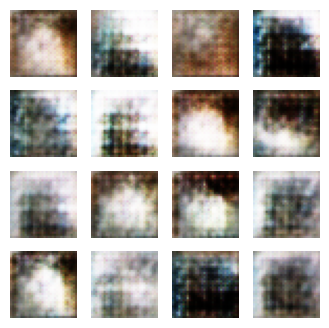

Time for epoch 561 is 4.187278985977173 sec
Time for epoch 562 is 3.514580011367798 sec
Time for epoch 563 is 3.654292106628418 sec
Time for epoch 564 is 3.643925666809082 sec
Time for epoch 565 is 3.63877010345459 sec
Time for epoch 566 is 3.672835111618042 sec
Time for epoch 567 is 3.62310791015625 sec
Time for epoch 568 is 3.643740653991699 sec
Time for epoch 569 is 3.641700029373169 sec
Time for epoch 570 is 3.6433866024017334 sec
Time for epoch 571 is 3.6375081539154053 sec
Time for epoch 572 is 3.6331136226654053 sec
Time for epoch 573 is 3.625138521194458 sec
Time for epoch 574 is 3.6707406044006348 sec
Time for epoch 575 is 3.6088051795959473 sec
Time for epoch 576 is 3.6354992389678955 sec
Time for epoch 577 is 3.642754554748535 sec
Time for epoch 578 is 3.6389918327331543 sec
Time for epoch 579 is 3.6472179889678955 sec
Time for epoch 580 is 3.624823570251465 sec


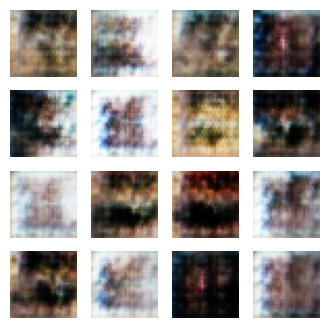

Time for epoch 581 is 4.7115318775177 sec
Time for epoch 582 is 3.499990701675415 sec
Time for epoch 583 is 3.6385443210601807 sec
Time for epoch 584 is 3.6222610473632812 sec
Time for epoch 585 is 3.6450350284576416 sec
Time for epoch 586 is 3.6223294734954834 sec
Time for epoch 587 is 3.6164069175720215 sec
Time for epoch 588 is 3.622081995010376 sec
Time for epoch 589 is 3.658130407333374 sec
Time for epoch 590 is 3.609819173812866 sec
Time for epoch 591 is 3.6275177001953125 sec
Time for epoch 592 is 3.6268491744995117 sec
Time for epoch 593 is 3.623628854751587 sec
Time for epoch 594 is 3.622465133666992 sec
Time for epoch 595 is 3.6216254234313965 sec
Time for epoch 596 is 3.625535726547241 sec
Time for epoch 597 is 3.6200215816497803 sec
Time for epoch 598 is 3.6203203201293945 sec
Time for epoch 599 is 3.628615617752075 sec
Time for epoch 600 is 3.647707462310791 sec


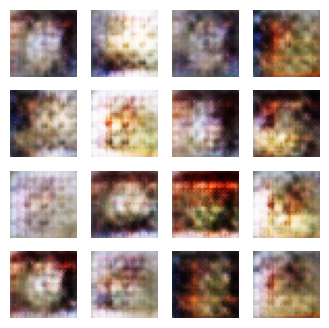

Time for epoch 601 is 4.160721778869629 sec
Time for epoch 602 is 3.4729244709014893 sec
Time for epoch 603 is 3.660210609436035 sec
Time for epoch 604 is 3.60566782951355 sec
Time for epoch 605 is 3.6283769607543945 sec
Time for epoch 606 is 3.642028331756592 sec
Time for epoch 607 is 3.6784303188323975 sec
Time for epoch 608 is 3.591090679168701 sec
Time for epoch 609 is 3.628279685974121 sec
Time for epoch 610 is 3.628202438354492 sec
Time for epoch 611 is 3.630526542663574 sec
Time for epoch 612 is 3.641963005065918 sec
Time for epoch 613 is 3.6467607021331787 sec
Time for epoch 614 is 3.639187812805176 sec
Time for epoch 615 is 3.644996404647827 sec
Time for epoch 616 is 3.628413200378418 sec
Time for epoch 617 is 3.655194044113159 sec
Time for epoch 618 is 3.6473989486694336 sec
Time for epoch 619 is 3.6416690349578857 sec
Time for epoch 620 is 3.643159866333008 sec


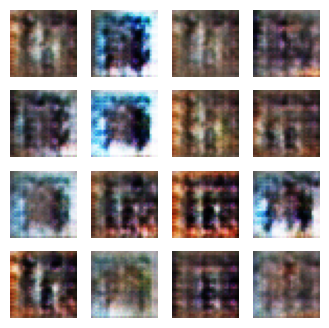

Time for epoch 621 is 4.179619789123535 sec
Time for epoch 622 is 3.5443074703216553 sec
Time for epoch 623 is 3.617112874984741 sec
Time for epoch 624 is 3.6526784896850586 sec
Time for epoch 625 is 3.643779754638672 sec
Time for epoch 626 is 3.6800901889801025 sec
Time for epoch 627 is 3.5956554412841797 sec
Time for epoch 628 is 3.676361560821533 sec
Time for epoch 629 is 3.609138250350952 sec
Time for epoch 630 is 3.6574814319610596 sec
Time for epoch 631 is 3.6454529762268066 sec
Time for epoch 632 is 3.644622325897217 sec
Time for epoch 633 is 3.644909143447876 sec
Time for epoch 634 is 3.6409847736358643 sec
Time for epoch 635 is 3.639009952545166 sec
Time for epoch 636 is 3.645967960357666 sec
Time for epoch 637 is 3.648165225982666 sec
Time for epoch 638 is 3.6339707374572754 sec
Time for epoch 639 is 3.6316909790039062 sec
Time for epoch 640 is 3.6418333053588867 sec


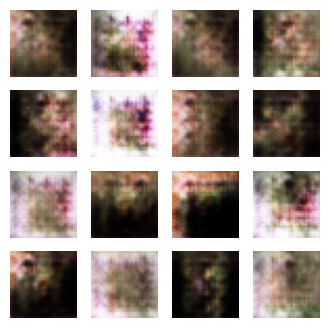

Time for epoch 641 is 4.18544864654541 sec
Time for epoch 642 is 3.507652759552002 sec
Time for epoch 643 is 3.6339643001556396 sec
Time for epoch 644 is 3.636577844619751 sec
Time for epoch 645 is 3.6253881454467773 sec
Time for epoch 646 is 3.622545003890991 sec
Time for epoch 647 is 3.6444437503814697 sec
Time for epoch 648 is 3.6421940326690674 sec
Time for epoch 649 is 3.6436235904693604 sec
Time for epoch 650 is 3.648615598678589 sec
Time for epoch 651 is 3.6602065563201904 sec
Time for epoch 652 is 3.611062526702881 sec
Time for epoch 653 is 3.6211531162261963 sec
Time for epoch 654 is 3.6091723442077637 sec
Time for epoch 655 is 3.634692907333374 sec
Time for epoch 656 is 3.6244113445281982 sec
Time for epoch 657 is 3.6429831981658936 sec
Time for epoch 658 is 3.6250216960906982 sec
Time for epoch 659 is 3.6238598823547363 sec
Time for epoch 660 is 3.6406290531158447 sec


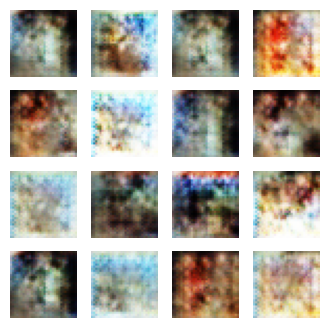

Time for epoch 661 is 4.142819166183472 sec
Time for epoch 662 is 3.5081443786621094 sec
Time for epoch 663 is 3.6206696033477783 sec
Time for epoch 664 is 3.626291275024414 sec
Time for epoch 665 is 3.627993583679199 sec
Time for epoch 666 is 3.6462061405181885 sec
Time for epoch 667 is 3.62553334236145 sec
Time for epoch 668 is 3.619962215423584 sec
Time for epoch 669 is 3.6437602043151855 sec
Time for epoch 670 is 3.624593734741211 sec
Time for epoch 671 is 3.6404972076416016 sec
Time for epoch 672 is 3.6365890502929688 sec
Time for epoch 673 is 5.102550745010376 sec
Time for epoch 674 is 3.4910290241241455 sec
Time for epoch 675 is 3.6212193965911865 sec
Time for epoch 676 is 3.622426748275757 sec
Time for epoch 677 is 3.626005172729492 sec
Time for epoch 678 is 3.63348650932312 sec
Time for epoch 679 is 3.6303629875183105 sec
Time for epoch 680 is 3.6310126781463623 sec


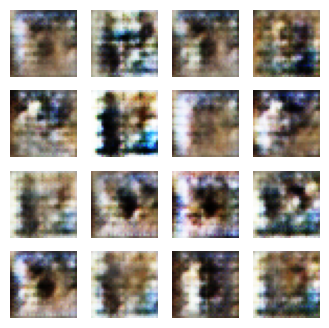

Time for epoch 681 is 4.340498685836792 sec
Time for epoch 682 is 3.509364366531372 sec
Time for epoch 683 is 3.6264586448669434 sec
Time for epoch 684 is 3.626851797103882 sec
Time for epoch 685 is 3.6236422061920166 sec
Time for epoch 686 is 3.6237661838531494 sec
Time for epoch 687 is 3.6411244869232178 sec
Time for epoch 688 is 3.631121873855591 sec
Time for epoch 689 is 3.6369733810424805 sec
Time for epoch 690 is 3.643019437789917 sec
Time for epoch 691 is 3.685438871383667 sec
Time for epoch 692 is 3.607172727584839 sec
Time for epoch 693 is 3.641442060470581 sec
Time for epoch 694 is 3.6471893787384033 sec
Time for epoch 695 is 3.661867141723633 sec
Time for epoch 696 is 3.6427323818206787 sec
Time for epoch 697 is 3.6487200260162354 sec
Time for epoch 698 is 3.654642343521118 sec
Time for epoch 699 is 3.6498653888702393 sec
Time for epoch 700 is 3.6492252349853516 sec


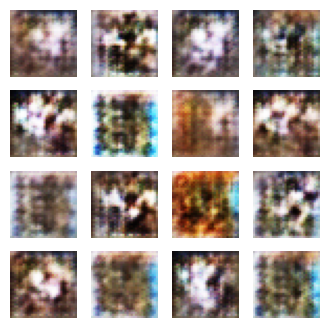

Time for epoch 701 is 4.197836637496948 sec
Time for epoch 702 is 3.508911609649658 sec
Time for epoch 703 is 3.633497953414917 sec
Time for epoch 704 is 3.6339664459228516 sec
Time for epoch 705 is 3.6360204219818115 sec
Time for epoch 706 is 3.6435327529907227 sec
Time for epoch 707 is 3.6214394569396973 sec
Time for epoch 708 is 3.6388978958129883 sec
Time for epoch 709 is 3.629359483718872 sec
Time for epoch 710 is 3.6218678951263428 sec
Time for epoch 711 is 3.6178078651428223 sec
Time for epoch 712 is 3.6465554237365723 sec
Time for epoch 713 is 3.6572988033294678 sec
Time for epoch 714 is 3.5914082527160645 sec
Time for epoch 715 is 3.6232666969299316 sec
Time for epoch 716 is 3.6354877948760986 sec
Time for epoch 717 is 3.660074472427368 sec
Time for epoch 718 is 3.59063720703125 sec
Time for epoch 719 is 3.6272599697113037 sec
Time for epoch 720 is 3.6220948696136475 sec


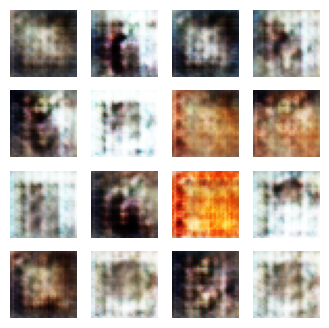

Time for epoch 721 is 4.33276629447937 sec
Time for epoch 722 is 5.101694107055664 sec
Time for epoch 723 is 3.476109743118286 sec
Time for epoch 724 is 3.6339993476867676 sec
Time for epoch 725 is 3.6261942386627197 sec
Time for epoch 726 is 3.6205132007598877 sec
Time for epoch 727 is 3.6208341121673584 sec
Time for epoch 728 is 3.6241047382354736 sec
Time for epoch 729 is 3.622417449951172 sec
Time for epoch 730 is 3.6189017295837402 sec
Time for epoch 731 is 3.62607479095459 sec
Time for epoch 732 is 3.6246302127838135 sec
Time for epoch 733 is 3.6416029930114746 sec
Time for epoch 734 is 3.638343095779419 sec
Time for epoch 735 is 3.6422958374023438 sec
Time for epoch 736 is 3.646951198577881 sec
Time for epoch 737 is 3.62568736076355 sec
Time for epoch 738 is 3.6493563652038574 sec
Time for epoch 739 is 3.6448071002960205 sec
Time for epoch 740 is 3.644974946975708 sec


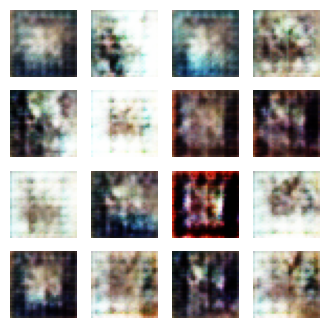

Time for epoch 741 is 4.17351222038269 sec
Time for epoch 742 is 3.5228888988494873 sec
Time for epoch 743 is 3.638823986053467 sec
Time for epoch 744 is 3.644848108291626 sec
Time for epoch 745 is 3.6468355655670166 sec
Time for epoch 746 is 3.662590503692627 sec
Time for epoch 747 is 3.6519014835357666 sec
Time for epoch 748 is 3.6504361629486084 sec
Time for epoch 749 is 3.6529364585876465 sec
Time for epoch 750 is 3.6664884090423584 sec
Time for epoch 751 is 3.6438727378845215 sec
Time for epoch 752 is 3.64764142036438 sec
Time for epoch 753 is 3.6527740955352783 sec
Time for epoch 754 is 3.684335231781006 sec
Time for epoch 755 is 3.608844518661499 sec
Time for epoch 756 is 3.6343300342559814 sec
Time for epoch 757 is 3.65165114402771 sec
Time for epoch 758 is 3.6503303050994873 sec
Time for epoch 759 is 3.646017551422119 sec
Time for epoch 760 is 3.6423184871673584 sec


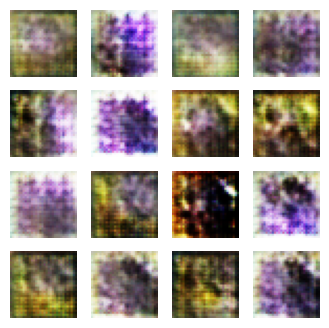

Time for epoch 761 is 4.712840795516968 sec
Time for epoch 762 is 3.4970602989196777 sec
Time for epoch 763 is 3.624742031097412 sec
Time for epoch 764 is 3.630324363708496 sec
Time for epoch 765 is 3.6371560096740723 sec
Time for epoch 766 is 3.626981019973755 sec
Time for epoch 767 is 3.644906759262085 sec
Time for epoch 768 is 3.6298906803131104 sec
Time for epoch 769 is 3.6492645740509033 sec
Time for epoch 770 is 3.6391472816467285 sec
Time for epoch 771 is 3.644057035446167 sec
Time for epoch 772 is 3.646676778793335 sec
Time for epoch 773 is 3.6310884952545166 sec
Time for epoch 774 is 3.629626512527466 sec
Time for epoch 775 is 3.6346685886383057 sec
Time for epoch 776 is 3.654000997543335 sec
Time for epoch 777 is 3.643005847930908 sec
Time for epoch 778 is 3.656095504760742 sec
Time for epoch 779 is 3.6443700790405273 sec
Time for epoch 780 is 3.651705265045166 sec


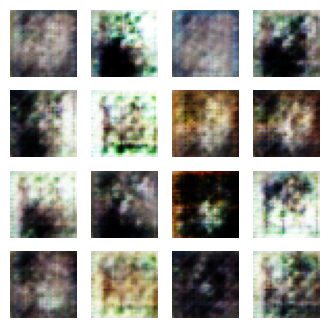

Time for epoch 781 is 4.190991640090942 sec
Time for epoch 782 is 3.5165629386901855 sec
Time for epoch 783 is 3.6799135208129883 sec
Time for epoch 784 is 3.617330551147461 sec
Time for epoch 785 is 3.635620355606079 sec
Time for epoch 786 is 3.648987293243408 sec
Time for epoch 787 is 3.677135467529297 sec
Time for epoch 788 is 3.608327627182007 sec
Time for epoch 789 is 3.630568265914917 sec
Time for epoch 790 is 3.6369173526763916 sec
Time for epoch 791 is 3.6335384845733643 sec
Time for epoch 792 is 3.6368143558502197 sec
Time for epoch 793 is 3.6468992233276367 sec
Time for epoch 794 is 3.6354596614837646 sec
Time for epoch 795 is 3.65378475189209 sec
Time for epoch 796 is 3.6519291400909424 sec
Time for epoch 797 is 3.638214349746704 sec
Time for epoch 798 is 3.6409454345703125 sec
Time for epoch 799 is 3.6450910568237305 sec
Time for epoch 800 is 3.643291473388672 sec


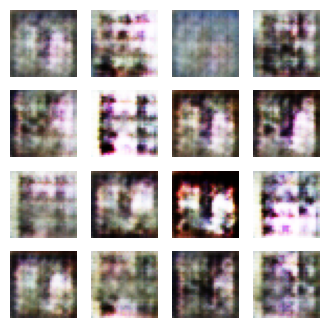

Time for epoch 801 is 4.349891185760498 sec
Time for epoch 802 is 3.494778633117676 sec
Time for epoch 803 is 3.6295082569122314 sec
Time for epoch 804 is 3.6464293003082275 sec
Time for epoch 805 is 3.6435160636901855 sec
Time for epoch 806 is 3.6436727046966553 sec
Time for epoch 807 is 3.653311252593994 sec
Time for epoch 808 is 3.6330440044403076 sec
Time for epoch 809 is 3.6588568687438965 sec
Time for epoch 810 is 3.6455039978027344 sec
Time for epoch 811 is 3.6453075408935547 sec
Time for epoch 812 is 3.672781229019165 sec
Time for epoch 813 is 3.623849868774414 sec
Time for epoch 814 is 3.6548972129821777 sec
Time for epoch 815 is 3.6650993824005127 sec
Time for epoch 816 is 3.690413475036621 sec
Time for epoch 817 is 3.625730276107788 sec
Time for epoch 818 is 3.6681466102600098 sec
Time for epoch 819 is 3.663783073425293 sec
Time for epoch 820 is 3.672137975692749 sec


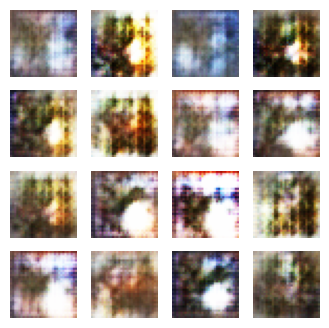

Time for epoch 821 is 4.176970481872559 sec
Time for epoch 822 is 3.5133135318756104 sec
Time for epoch 823 is 3.6851279735565186 sec
Time for epoch 824 is 3.6066362857818604 sec
Time for epoch 825 is 3.646411895751953 sec
Time for epoch 826 is 3.6375107765197754 sec
Time for epoch 827 is 3.6435344219207764 sec
Time for epoch 828 is 3.642057180404663 sec
Time for epoch 829 is 3.6192731857299805 sec
Time for epoch 830 is 3.641446590423584 sec
Time for epoch 831 is 3.631255626678467 sec
Time for epoch 832 is 3.6427743434906006 sec
Time for epoch 833 is 3.6456286907196045 sec
Time for epoch 834 is 3.62264084815979 sec
Time for epoch 835 is 3.623326063156128 sec
Time for epoch 836 is 3.623188018798828 sec
Time for epoch 837 is 3.645822286605835 sec
Time for epoch 838 is 3.6340067386627197 sec
Time for epoch 839 is 3.632781505584717 sec
Time for epoch 840 is 3.6210734844207764 sec


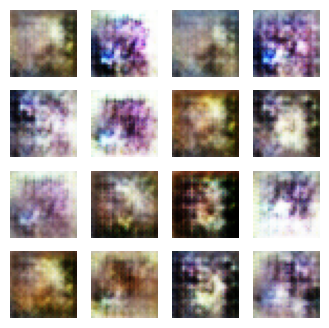

Time for epoch 841 is 4.441792011260986 sec
Time for epoch 842 is 3.488783597946167 sec
Time for epoch 843 is 3.616672992706299 sec
Time for epoch 844 is 3.6223318576812744 sec
Time for epoch 845 is 3.6224701404571533 sec
Time for epoch 846 is 3.6258175373077393 sec
Time for epoch 847 is 3.6236045360565186 sec
Time for epoch 848 is 3.626253604888916 sec
Time for epoch 849 is 3.6608853340148926 sec
Time for epoch 850 is 3.624849796295166 sec
Time for epoch 851 is 3.589707136154175 sec
Time for epoch 852 is 3.623532295227051 sec
Time for epoch 853 is 3.6581051349639893 sec
Time for epoch 854 is 3.5874016284942627 sec
Time for epoch 855 is 3.61838436126709 sec
Time for epoch 856 is 3.623650550842285 sec
Time for epoch 857 is 3.6602795124053955 sec
Time for epoch 858 is 3.582559823989868 sec
Time for epoch 859 is 3.6250202655792236 sec
Time for epoch 860 is 3.623687982559204 sec


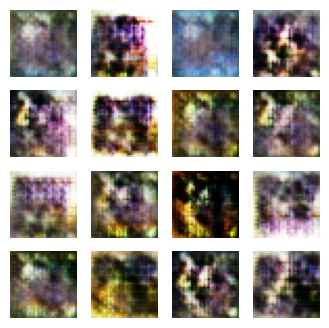

Time for epoch 861 is 4.213097333908081 sec
Time for epoch 862 is 3.49556565284729 sec
Time for epoch 863 is 3.622440814971924 sec
Time for epoch 864 is 3.6233975887298584 sec
Time for epoch 865 is 3.6392104625701904 sec
Time for epoch 866 is 3.630173683166504 sec
Time for epoch 867 is 3.6263554096221924 sec
Time for epoch 868 is 3.644268035888672 sec
Time for epoch 869 is 3.6279399394989014 sec
Time for epoch 870 is 3.618189811706543 sec
Time for epoch 871 is 3.6259326934814453 sec
Time for epoch 872 is 3.622283935546875 sec
Time for epoch 873 is 3.6219165325164795 sec
Time for epoch 874 is 3.6218700408935547 sec
Time for epoch 875 is 3.6252734661102295 sec
Time for epoch 876 is 3.6204934120178223 sec
Time for epoch 877 is 3.6248269081115723 sec
Time for epoch 878 is 3.63991117477417 sec
Time for epoch 879 is 3.614354133605957 sec
Time for epoch 880 is 3.628929615020752 sec


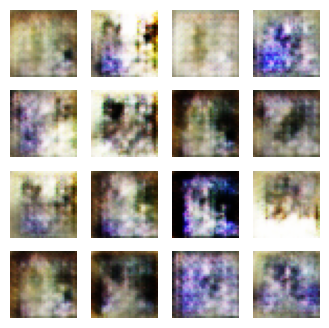

Time for epoch 881 is 4.144851207733154 sec
Time for epoch 882 is 3.5035135746002197 sec
Time for epoch 883 is 3.6274847984313965 sec
Time for epoch 884 is 3.6227612495422363 sec
Time for epoch 885 is 3.626220941543579 sec
Time for epoch 886 is 3.6266837120056152 sec
Time for epoch 887 is 3.6222965717315674 sec
Time for epoch 888 is 3.6234359741210938 sec
Time for epoch 889 is 3.628969192504883 sec
Time for epoch 890 is 3.627368927001953 sec
Time for epoch 891 is 3.633945941925049 sec
Time for epoch 892 is 3.6207988262176514 sec
Time for epoch 893 is 3.6221134662628174 sec
Time for epoch 894 is 3.6420958042144775 sec
Time for epoch 895 is 3.623826265335083 sec
Time for epoch 896 is 3.6421260833740234 sec
Time for epoch 897 is 3.621856212615967 sec
Time for epoch 898 is 3.6342625617980957 sec
Time for epoch 899 is 3.6331493854522705 sec
Time for epoch 900 is 3.6231167316436768 sec


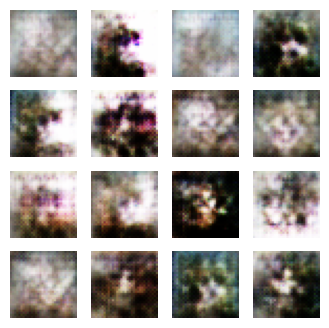

Time for epoch 901 is 4.363367795944214 sec
Time for epoch 902 is 3.506162405014038 sec
Time for epoch 903 is 3.624300241470337 sec
Time for epoch 904 is 3.6271584033966064 sec
Time for epoch 905 is 3.6251468658447266 sec
Time for epoch 906 is 3.6238725185394287 sec
Time for epoch 907 is 3.6232757568359375 sec
Time for epoch 908 is 3.643062114715576 sec
Time for epoch 909 is 3.621866226196289 sec
Time for epoch 910 is 3.622514486312866 sec
Time for epoch 911 is 3.622591733932495 sec
Time for epoch 912 is 3.6248562335968018 sec
Time for epoch 913 is 3.6329715251922607 sec
Time for epoch 914 is 3.6324384212493896 sec
Time for epoch 915 is 3.6414260864257812 sec
Time for epoch 916 is 3.673398494720459 sec
Time for epoch 917 is 3.609204053878784 sec
Time for epoch 918 is 3.6416776180267334 sec
Time for epoch 919 is 3.625443458557129 sec
Time for epoch 920 is 3.626178741455078 sec


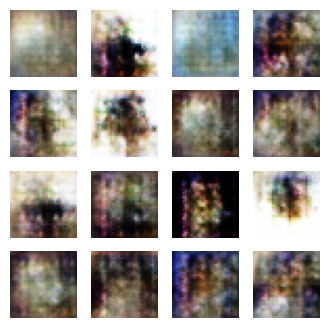

Time for epoch 921 is 4.150816440582275 sec
Time for epoch 922 is 3.5207645893096924 sec
Time for epoch 923 is 3.6325056552886963 sec
Time for epoch 924 is 3.6187498569488525 sec
Time for epoch 925 is 3.625142812728882 sec
Time for epoch 926 is 3.6429502964019775 sec
Time for epoch 927 is 3.6467034816741943 sec
Time for epoch 928 is 3.63848876953125 sec
Time for epoch 929 is 3.6325154304504395 sec
Time for epoch 930 is 3.6494648456573486 sec
Time for epoch 931 is 3.6544525623321533 sec
Time for epoch 932 is 3.647855520248413 sec
Time for epoch 933 is 3.6539738178253174 sec
Time for epoch 934 is 3.676541566848755 sec
Time for epoch 935 is 3.611891031265259 sec
Time for epoch 936 is 3.6420693397521973 sec
Time for epoch 937 is 3.649503231048584 sec
Time for epoch 938 is 3.6448569297790527 sec
Time for epoch 939 is 3.675919532775879 sec
Time for epoch 940 is 3.595693349838257 sec


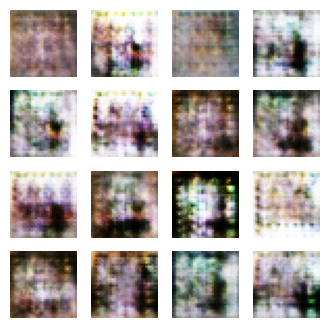

Time for epoch 941 is 4.498994588851929 sec
Time for epoch 942 is 3.5064566135406494 sec
Time for epoch 943 is 3.6316049098968506 sec
Time for epoch 944 is 3.6211674213409424 sec
Time for epoch 945 is 3.6255366802215576 sec
Time for epoch 946 is 3.6216399669647217 sec
Time for epoch 947 is 3.6224679946899414 sec
Time for epoch 948 is 3.6333608627319336 sec
Time for epoch 949 is 3.636307716369629 sec
Time for epoch 950 is 3.639657497406006 sec
Time for epoch 951 is 3.632308006286621 sec
Time for epoch 952 is 3.6304891109466553 sec
Time for epoch 953 is 3.6264560222625732 sec
Time for epoch 954 is 3.6189534664154053 sec
Time for epoch 955 is 3.62054705619812 sec
Time for epoch 956 is 3.6442105770111084 sec
Time for epoch 957 is 3.622079372406006 sec
Time for epoch 958 is 3.6267943382263184 sec
Time for epoch 959 is 3.6433966159820557 sec
Time for epoch 960 is 3.628633737564087 sec


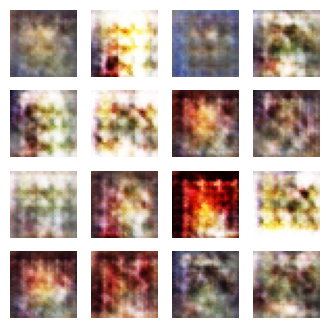

Time for epoch 961 is 4.147232532501221 sec
Time for epoch 962 is 3.4822113513946533 sec
Time for epoch 963 is 3.622028350830078 sec
Time for epoch 964 is 5.103872776031494 sec
Time for epoch 965 is 3.477442979812622 sec
Time for epoch 966 is 3.632828712463379 sec
Time for epoch 967 is 3.6568496227264404 sec
Time for epoch 968 is 3.5870630741119385 sec
Time for epoch 969 is 3.6242103576660156 sec
Time for epoch 970 is 3.629716157913208 sec
Time for epoch 971 is 3.639068603515625 sec
Time for epoch 972 is 3.6402580738067627 sec
Time for epoch 973 is 3.6526761054992676 sec
Time for epoch 974 is 3.6588542461395264 sec
Time for epoch 975 is 3.659538984298706 sec
Time for epoch 976 is 3.637500047683716 sec
Time for epoch 977 is 3.638805627822876 sec
Time for epoch 978 is 3.6465768814086914 sec
Time for epoch 979 is 3.6217472553253174 sec
Time for epoch 980 is 3.625729560852051 sec


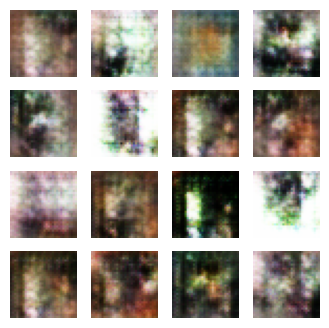

Time for epoch 981 is 4.149248838424683 sec
Time for epoch 982 is 3.5538434982299805 sec
Time for epoch 983 is 3.586470365524292 sec
Time for epoch 984 is 3.624169111251831 sec
Time for epoch 985 is 3.6196353435516357 sec
Time for epoch 986 is 3.6225643157958984 sec
Time for epoch 987 is 3.6221508979797363 sec
Time for epoch 988 is 3.621981143951416 sec
Time for epoch 989 is 3.6250503063201904 sec
Time for epoch 990 is 3.6152873039245605 sec
Time for epoch 991 is 3.620609998703003 sec
Time for epoch 992 is 3.6209824085235596 sec
Time for epoch 993 is 3.6228604316711426 sec
Time for epoch 994 is 3.6246349811553955 sec
Time for epoch 995 is 3.6242175102233887 sec
Time for epoch 996 is 3.6264820098876953 sec
Time for epoch 997 is 3.6314046382904053 sec
Time for epoch 998 is 3.6217732429504395 sec
Time for epoch 999 is 3.6216540336608887 sec
Time for epoch 1000 is 3.620993137359619 sec


In [35]:
train(train_dataset, 1000)

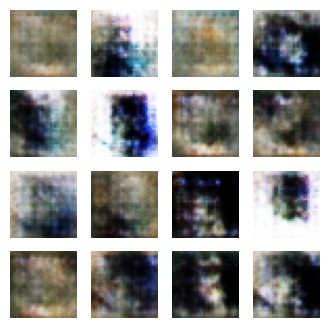

Time for epoch 1 is 3.975310802459717 sec
Time for epoch 2 is 3.4200501441955566 sec
Time for epoch 3 is 3.6056017875671387 sec
Time for epoch 4 is 3.6344432830810547 sec
Time for epoch 5 is 3.6534407138824463 sec
Time for epoch 6 is 3.691912889480591 sec
Time for epoch 7 is 3.7507922649383545 sec
Time for epoch 8 is 3.7823498249053955 sec
Time for epoch 9 is 3.8194148540496826 sec
Time for epoch 10 is 3.825345039367676 sec
Time for epoch 11 is 3.8144967555999756 sec
Time for epoch 12 is 3.7929255962371826 sec
Time for epoch 13 is 3.677605152130127 sec
Time for epoch 14 is 3.68308162689209 sec
Time for epoch 15 is 3.64333176612854 sec
Time for epoch 16 is 3.61942982673645 sec
Time for epoch 17 is 3.606290817260742 sec
Time for epoch 18 is 3.599622964859009 sec
Time for epoch 19 is 3.593043088912964 sec
Time for epoch 20 is 3.5820703506469727 sec


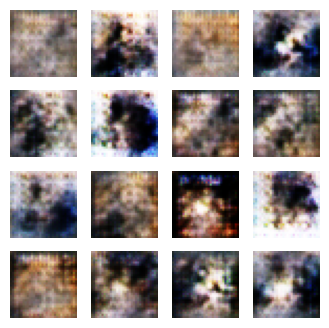

Time for epoch 21 is 4.099586486816406 sec
Time for epoch 22 is 3.443270683288574 sec
Time for epoch 23 is 3.580150842666626 sec
Time for epoch 24 is 3.5869224071502686 sec
Time for epoch 25 is 3.604858636856079 sec
Time for epoch 26 is 3.614985227584839 sec
Time for epoch 27 is 3.6290268898010254 sec
Time for epoch 28 is 3.6398704051971436 sec
Time for epoch 29 is 3.6463403701782227 sec
Time for epoch 30 is 3.6898996829986572 sec
Time for epoch 31 is 3.63689923286438 sec
Time for epoch 32 is 3.6818153858184814 sec
Time for epoch 33 is 3.687195301055908 sec
Time for epoch 34 is 3.6848273277282715 sec
Time for epoch 35 is 3.6953442096710205 sec
Time for epoch 36 is 3.6899962425231934 sec
Time for epoch 37 is 3.669008731842041 sec
Time for epoch 38 is 3.6786398887634277 sec
Time for epoch 39 is 3.648900270462036 sec
Time for epoch 40 is 3.6618499755859375 sec


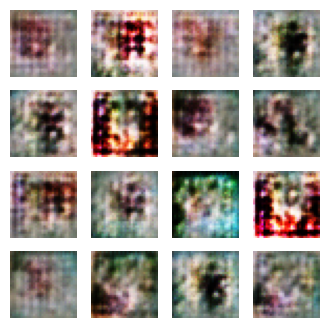

Time for epoch 41 is 4.336327314376831 sec
Time for epoch 42 is 3.486135244369507 sec
Time for epoch 43 is 3.6225085258483887 sec
Time for epoch 44 is 3.6299021244049072 sec
Time for epoch 45 is 3.6210358142852783 sec
Time for epoch 46 is 3.6233108043670654 sec
Time for epoch 47 is 3.618093729019165 sec
Time for epoch 48 is 3.6276936531066895 sec
Time for epoch 49 is 3.6220340728759766 sec
Time for epoch 50 is 3.622516632080078 sec
Time for epoch 51 is 3.6571271419525146 sec
Time for epoch 52 is 3.588982343673706 sec
Time for epoch 53 is 3.6237690448760986 sec
Time for epoch 54 is 3.633927345275879 sec
Time for epoch 55 is 3.6526801586151123 sec
Time for epoch 56 is 3.633584976196289 sec
Time for epoch 57 is 3.649094343185425 sec
Time for epoch 58 is 3.650202512741089 sec
Time for epoch 59 is 3.6893463134765625 sec
Time for epoch 60 is 3.6114749908447266 sec


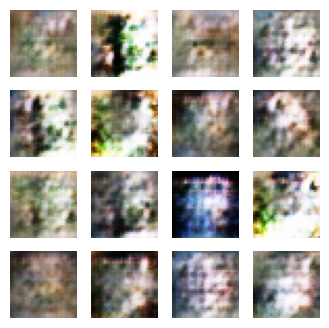

Time for epoch 61 is 4.193477630615234 sec
Time for epoch 62 is 3.5096566677093506 sec
Time for epoch 63 is 3.6494083404541016 sec
Time for epoch 64 is 3.6485090255737305 sec
Time for epoch 65 is 3.656625509262085 sec
Time for epoch 66 is 3.6559665203094482 sec
Time for epoch 67 is 3.658769369125366 sec
Time for epoch 68 is 3.6593124866485596 sec
Time for epoch 69 is 3.66145920753479 sec
Time for epoch 70 is 3.653879404067993 sec
Time for epoch 71 is 3.6517913341522217 sec
Time for epoch 72 is 3.6589977741241455 sec
Time for epoch 73 is 3.6853435039520264 sec
Time for epoch 74 is 3.621227741241455 sec
Time for epoch 75 is 3.646350622177124 sec
Time for epoch 76 is 3.650463342666626 sec
Time for epoch 77 is 3.657055616378784 sec
Time for epoch 78 is 3.6480934619903564 sec
Time for epoch 79 is 3.656256914138794 sec
Time for epoch 80 is 3.650447368621826 sec


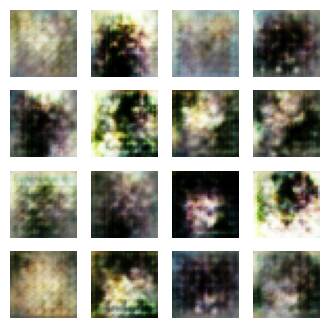

Time for epoch 81 is 4.252633333206177 sec
Time for epoch 82 is 3.502760648727417 sec
Time for epoch 83 is 3.6372427940368652 sec
Time for epoch 84 is 3.642038106918335 sec
Time for epoch 85 is 3.6473774909973145 sec
Time for epoch 86 is 3.6366660594940186 sec
Time for epoch 87 is 3.645373582839966 sec
Time for epoch 88 is 3.647663116455078 sec
Time for epoch 89 is 3.6522388458251953 sec
Time for epoch 90 is 3.6424992084503174 sec
Time for epoch 91 is 3.6395492553710938 sec
Time for epoch 92 is 3.6496009826660156 sec
Time for epoch 93 is 3.6465697288513184 sec
Time for epoch 94 is 3.651447057723999 sec
Time for epoch 95 is 3.649664878845215 sec
Time for epoch 96 is 3.6379799842834473 sec
Time for epoch 97 is 3.626021385192871 sec
Time for epoch 98 is 3.645256280899048 sec
Time for epoch 99 is 3.6309781074523926 sec
Time for epoch 100 is 3.627971887588501 sec


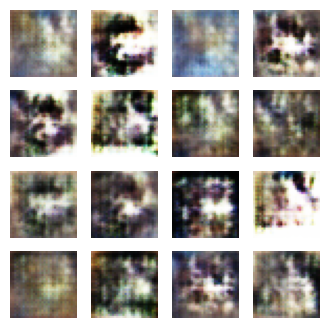

Time for epoch 101 is 4.1501195430755615 sec
Time for epoch 102 is 3.496643304824829 sec
Time for epoch 103 is 3.6497974395751953 sec
Time for epoch 104 is 3.6234569549560547 sec
Time for epoch 105 is 3.6492042541503906 sec
Time for epoch 106 is 5.1025779247283936 sec
Time for epoch 107 is 3.490121841430664 sec
Time for epoch 108 is 3.623414993286133 sec
Time for epoch 109 is 3.6331331729888916 sec
Time for epoch 110 is 3.6467483043670654 sec
Time for epoch 111 is 3.6475250720977783 sec
Time for epoch 112 is 3.655156373977661 sec
Time for epoch 113 is 3.6560113430023193 sec
Time for epoch 114 is 3.654392957687378 sec
Time for epoch 115 is 3.6669998168945312 sec
Time for epoch 116 is 3.6414244174957275 sec
Time for epoch 117 is 3.648881673812866 sec
Time for epoch 118 is 3.6553492546081543 sec
Time for epoch 119 is 3.6617558002471924 sec
Time for epoch 120 is 3.6615495681762695 sec


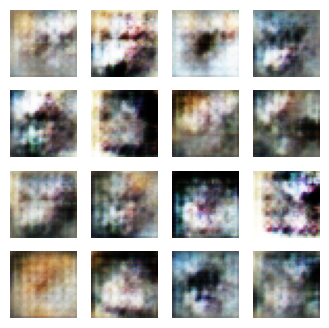

Time for epoch 121 is 4.483619689941406 sec
Time for epoch 122 is 3.500523805618286 sec
Time for epoch 123 is 3.638718843460083 sec
Time for epoch 124 is 3.6496641635894775 sec
Time for epoch 125 is 3.649446487426758 sec
Time for epoch 126 is 3.6415016651153564 sec
Time for epoch 127 is 3.6388680934906006 sec
Time for epoch 128 is 3.641782760620117 sec
Time for epoch 129 is 3.6315832138061523 sec
Time for epoch 130 is 3.6384689807891846 sec
Time for epoch 131 is 3.645969867706299 sec
Time for epoch 132 is 3.6380202770233154 sec
Time for epoch 133 is 3.6423637866973877 sec
Time for epoch 134 is 3.6290853023529053 sec
Time for epoch 135 is 3.6504123210906982 sec
Time for epoch 136 is 3.6277284622192383 sec
Time for epoch 137 is 3.6229782104492188 sec
Time for epoch 138 is 3.6300735473632812 sec
Time for epoch 139 is 5.1020667552948 sec
Time for epoch 140 is 3.4855682849884033 sec


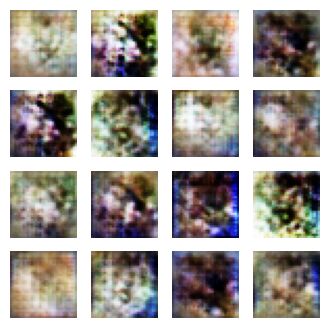

Time for epoch 141 is 4.149322748184204 sec
Time for epoch 142 is 3.4948487281799316 sec
Time for epoch 143 is 3.6167197227478027 sec
Time for epoch 144 is 3.625368118286133 sec
Time for epoch 145 is 3.6216418743133545 sec
Time for epoch 146 is 3.6593875885009766 sec
Time for epoch 147 is 3.5908617973327637 sec
Time for epoch 148 is 3.6295111179351807 sec
Time for epoch 149 is 3.6373798847198486 sec
Time for epoch 150 is 3.620739221572876 sec
Time for epoch 151 is 3.624950408935547 sec
Time for epoch 152 is 3.641817808151245 sec
Time for epoch 153 is 3.6453137397766113 sec
Time for epoch 154 is 3.639434576034546 sec
Time for epoch 155 is 3.643392562866211 sec
Time for epoch 156 is 3.6472983360290527 sec
Time for epoch 157 is 3.6526477336883545 sec
Time for epoch 158 is 3.653116464614868 sec
Time for epoch 159 is 3.6457865238189697 sec
Time for epoch 160 is 3.642836332321167 sec


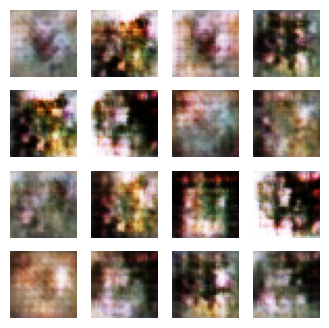

Time for epoch 161 is 4.179690837860107 sec
Time for epoch 162 is 3.5100038051605225 sec
Time for epoch 163 is 3.64353346824646 sec
Time for epoch 164 is 3.6749491691589355 sec
Time for epoch 165 is 3.6078529357910156 sec
Time for epoch 166 is 3.643188238143921 sec
Time for epoch 167 is 3.6454813480377197 sec
Time for epoch 168 is 3.671765089035034 sec
Time for epoch 169 is 3.5640296936035156 sec
Time for epoch 170 is 3.6563141345977783 sec
Time for epoch 171 is 3.628108024597168 sec
Time for epoch 172 is 3.6465094089508057 sec
Time for epoch 173 is 3.632122278213501 sec
Time for epoch 174 is 3.6285347938537598 sec
Time for epoch 175 is 3.6392180919647217 sec
Time for epoch 176 is 3.6327576637268066 sec
Time for epoch 177 is 3.6409287452697754 sec
Time for epoch 178 is 3.6504619121551514 sec
Time for epoch 179 is 3.6487133502960205 sec
Time for epoch 180 is 3.6233232021331787 sec


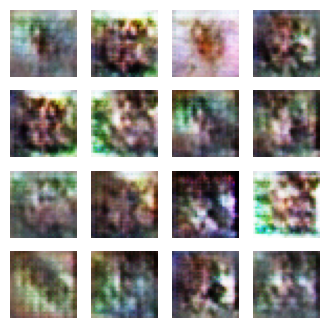

Time for epoch 181 is 4.171267509460449 sec
Time for epoch 182 is 3.495163679122925 sec
Time for epoch 183 is 3.6237633228302 sec
Time for epoch 184 is 3.6209774017333984 sec
Time for epoch 185 is 3.6256256103515625 sec
Time for epoch 186 is 3.6246564388275146 sec
Time for epoch 187 is 3.619729995727539 sec
Time for epoch 188 is 3.624997138977051 sec
Time for epoch 189 is 3.6449973583221436 sec
Time for epoch 190 is 3.626040458679199 sec
Time for epoch 191 is 3.6233508586883545 sec
Time for epoch 192 is 3.624006509780884 sec
Time for epoch 193 is 3.625744581222534 sec
Time for epoch 194 is 3.6245603561401367 sec
Time for epoch 195 is 3.6257059574127197 sec
Time for epoch 196 is 3.638331651687622 sec
Time for epoch 197 is 3.627946615219116 sec
Time for epoch 198 is 3.626696825027466 sec
Time for epoch 199 is 3.6350367069244385 sec
Time for epoch 200 is 3.6371912956237793 sec


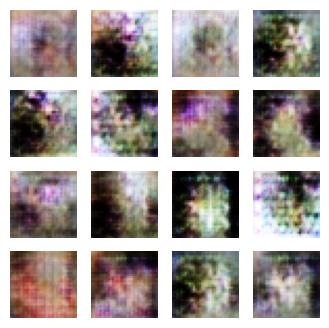

Time for epoch 201 is 4.692260265350342 sec
Time for epoch 202 is 3.503404140472412 sec
Time for epoch 203 is 3.6185803413391113 sec
Time for epoch 204 is 3.622135639190674 sec
Time for epoch 205 is 3.6578054428100586 sec
Time for epoch 206 is 3.5864081382751465 sec
Time for epoch 207 is 3.6235158443450928 sec
Time for epoch 208 is 3.6261022090911865 sec
Time for epoch 209 is 3.6243762969970703 sec
Time for epoch 210 is 3.6270010471343994 sec
Time for epoch 211 is 3.645023822784424 sec
Time for epoch 212 is 3.624420404434204 sec
Time for epoch 213 is 3.6195242404937744 sec
Time for epoch 214 is 3.6210811138153076 sec
Time for epoch 215 is 3.6211421489715576 sec
Time for epoch 216 is 3.6336441040039062 sec
Time for epoch 217 is 3.6318933963775635 sec
Time for epoch 218 is 3.642540216445923 sec
Time for epoch 219 is 3.6230671405792236 sec
Time for epoch 220 is 3.623509168624878 sec


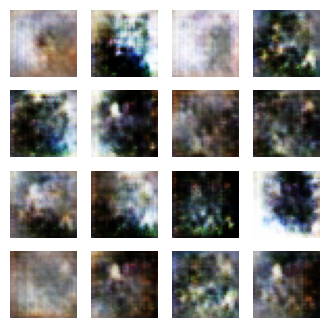

Time for epoch 221 is 4.170779705047607 sec
Time for epoch 222 is 3.497798442840576 sec
Time for epoch 223 is 3.6245148181915283 sec
Time for epoch 224 is 3.6401612758636475 sec
Time for epoch 225 is 3.6250205039978027 sec
Time for epoch 226 is 3.6224076747894287 sec
Time for epoch 227 is 3.6258156299591064 sec
Time for epoch 228 is 3.621734142303467 sec
Time for epoch 229 is 3.625113010406494 sec
Time for epoch 230 is 3.6428945064544678 sec
Time for epoch 231 is 3.617748975753784 sec
Time for epoch 232 is 3.623610258102417 sec
Time for epoch 233 is 3.62139630317688 sec
Time for epoch 234 is 3.6473894119262695 sec
Time for epoch 235 is 3.6211321353912354 sec
Time for epoch 236 is 3.6210474967956543 sec
Time for epoch 237 is 3.6240997314453125 sec
Time for epoch 238 is 3.6268606185913086 sec
Time for epoch 239 is 3.617241621017456 sec
Time for epoch 240 is 3.6269748210906982 sec


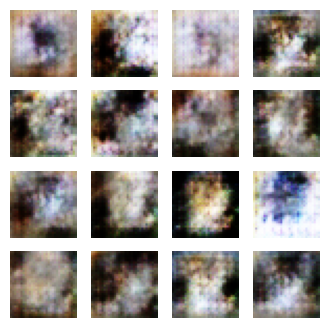

Time for epoch 241 is 4.173432111740112 sec
Time for epoch 242 is 3.5077147483825684 sec
Time for epoch 243 is 3.6229145526885986 sec
Time for epoch 244 is 3.624917507171631 sec
Time for epoch 245 is 3.6285696029663086 sec
Time for epoch 246 is 3.6242740154266357 sec
Time for epoch 247 is 3.6276793479919434 sec
Time for epoch 248 is 3.62599778175354 sec
Time for epoch 249 is 3.6438450813293457 sec
Time for epoch 250 is 3.641030788421631 sec
Time for epoch 251 is 3.638984441757202 sec
Time for epoch 252 is 3.6453981399536133 sec
Time for epoch 253 is 3.6529247760772705 sec
Time for epoch 254 is 5.101872444152832 sec
Time for epoch 255 is 3.4769017696380615 sec
Time for epoch 256 is 3.6281116008758545 sec
Time for epoch 257 is 3.6398122310638428 sec
Time for epoch 258 is 3.637190341949463 sec
Time for epoch 259 is 3.6358346939086914 sec
Time for epoch 260 is 3.647887945175171 sec


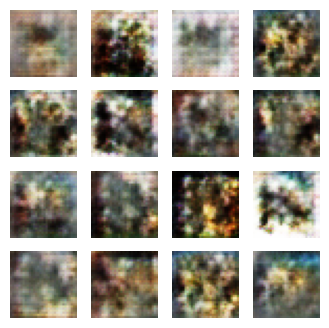

Time for epoch 261 is 4.182768106460571 sec
Time for epoch 262 is 3.504507541656494 sec
Time for epoch 263 is 3.647634506225586 sec
Time for epoch 264 is 3.630383253097534 sec
Time for epoch 265 is 3.6507132053375244 sec
Time for epoch 266 is 5.102506875991821 sec
Time for epoch 267 is 3.5022785663604736 sec
Time for epoch 268 is 3.6325154304504395 sec
Time for epoch 269 is 3.664584159851074 sec
Time for epoch 270 is 3.6512091159820557 sec
Time for epoch 271 is 3.6480164527893066 sec
Time for epoch 272 is 3.6587424278259277 sec
Time for epoch 273 is 3.6543288230895996 sec
Time for epoch 274 is 3.6685683727264404 sec
Time for epoch 275 is 3.6564443111419678 sec
Time for epoch 276 is 3.656797409057617 sec
Time for epoch 277 is 3.6517021656036377 sec
Time for epoch 278 is 3.6821489334106445 sec
Time for epoch 279 is 3.6047253608703613 sec
Time for epoch 280 is 3.6499831676483154 sec


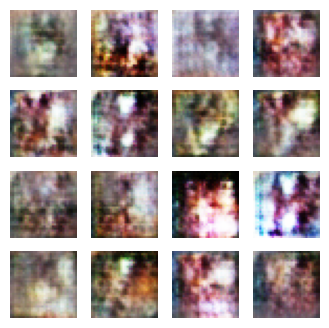

Time for epoch 281 is 5.6722540855407715 sec
Time for epoch 282 is 3.5365328788757324 sec
Time for epoch 283 is 3.6277148723602295 sec
Time for epoch 284 is 3.6257119178771973 sec
Time for epoch 285 is 3.6200854778289795 sec
Time for epoch 286 is 3.620400905609131 sec
Time for epoch 287 is 3.621412754058838 sec
Time for epoch 288 is 3.6248958110809326 sec
Time for epoch 289 is 3.6178736686706543 sec
Time for epoch 290 is 3.6286051273345947 sec
Time for epoch 291 is 3.6691293716430664 sec
Time for epoch 292 is 3.592597723007202 sec
Time for epoch 293 is 3.6366302967071533 sec
Time for epoch 294 is 3.631450891494751 sec
Time for epoch 295 is 3.6446635723114014 sec
Time for epoch 296 is 3.6224546432495117 sec
Time for epoch 297 is 3.622584581375122 sec
Time for epoch 298 is 3.624168634414673 sec
Time for epoch 299 is 3.627258062362671 sec
Time for epoch 300 is 3.62272310256958 sec


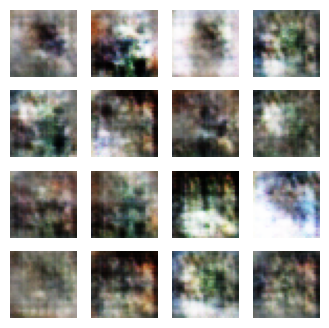

Time for epoch 301 is 4.480314254760742 sec
Time for epoch 302 is 3.506110191345215 sec
Time for epoch 303 is 3.6557111740112305 sec
Time for epoch 304 is 3.6083152294158936 sec
Time for epoch 305 is 3.625033378601074 sec
Time for epoch 306 is 3.626075029373169 sec
Time for epoch 307 is 3.6226041316986084 sec
Time for epoch 308 is 3.6223673820495605 sec
Time for epoch 309 is 3.6212282180786133 sec
Time for epoch 310 is 3.628373622894287 sec
Time for epoch 311 is 3.6396303176879883 sec
Time for epoch 312 is 3.6200106143951416 sec
Time for epoch 313 is 3.6440486907958984 sec
Time for epoch 314 is 3.6428749561309814 sec
Time for epoch 315 is 3.639338493347168 sec
Time for epoch 316 is 3.6248490810394287 sec
Time for epoch 317 is 3.6249282360076904 sec
Time for epoch 318 is 3.629981517791748 sec
Time for epoch 319 is 3.644789218902588 sec
Time for epoch 320 is 3.623868942260742 sec


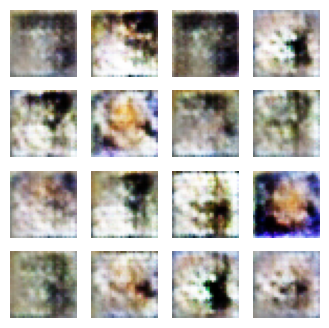

Time for epoch 321 is 4.325030088424683 sec
Time for epoch 322 is 3.4871132373809814 sec
Time for epoch 323 is 3.6214988231658936 sec
Time for epoch 324 is 3.61946702003479 sec
Time for epoch 325 is 3.6331992149353027 sec
Time for epoch 326 is 3.6501238346099854 sec
Time for epoch 327 is 3.6351943016052246 sec
Time for epoch 328 is 3.644683837890625 sec
Time for epoch 329 is 3.6824402809143066 sec
Time for epoch 330 is 3.5956828594207764 sec
Time for epoch 331 is 3.644329786300659 sec
Time for epoch 332 is 3.6767687797546387 sec
Time for epoch 333 is 3.609127998352051 sec
Time for epoch 334 is 3.641000509262085 sec
Time for epoch 335 is 3.646129846572876 sec
Time for epoch 336 is 3.649940252304077 sec
Time for epoch 337 is 3.6466732025146484 sec
Time for epoch 338 is 3.64581036567688 sec
Time for epoch 339 is 3.6505606174468994 sec
Time for epoch 340 is 3.6625611782073975 sec


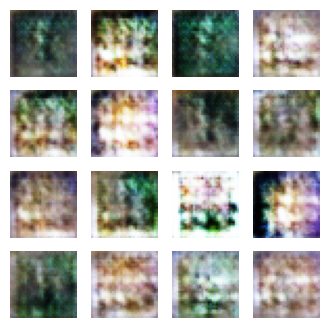

Time for epoch 341 is 4.188222169876099 sec
Time for epoch 342 is 3.5186057090759277 sec
Time for epoch 343 is 3.6803348064422607 sec
Time for epoch 344 is 3.6190640926361084 sec
Time for epoch 345 is 3.645321846008301 sec
Time for epoch 346 is 3.642946720123291 sec
Time for epoch 347 is 3.6454014778137207 sec
Time for epoch 348 is 3.64508318901062 sec
Time for epoch 349 is 3.654667377471924 sec
Time for epoch 350 is 3.647911548614502 sec
Time for epoch 351 is 3.652507781982422 sec
Time for epoch 352 is 3.6514129638671875 sec
Time for epoch 353 is 3.6476001739501953 sec
Time for epoch 354 is 3.64741587638855 sec
Time for epoch 355 is 3.641489267349243 sec
Time for epoch 356 is 3.634666681289673 sec
Time for epoch 357 is 3.644934892654419 sec
Time for epoch 358 is 3.646369695663452 sec
Time for epoch 359 is 3.645716905593872 sec
Time for epoch 360 is 3.644160747528076 sec


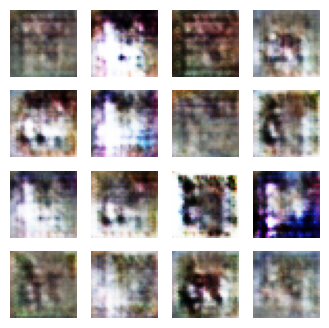

Time for epoch 361 is 4.183542490005493 sec
Time for epoch 362 is 3.5127179622650146 sec
Time for epoch 363 is 3.6302080154418945 sec
Time for epoch 364 is 3.634145975112915 sec
Time for epoch 365 is 3.6421620845794678 sec
Time for epoch 366 is 3.648677110671997 sec
Time for epoch 367 is 3.648324966430664 sec
Time for epoch 368 is 3.6490261554718018 sec
Time for epoch 369 is 3.6515555381774902 sec
Time for epoch 370 is 3.6539366245269775 sec
Time for epoch 371 is 3.6470701694488525 sec
Time for epoch 372 is 3.6477718353271484 sec
Time for epoch 373 is 3.655573606491089 sec
Time for epoch 374 is 3.647484064102173 sec
Time for epoch 375 is 3.6566102504730225 sec
Time for epoch 376 is 3.648499011993408 sec
Time for epoch 377 is 3.6684837341308594 sec
Time for epoch 378 is 3.6541287899017334 sec
Time for epoch 379 is 3.645260810852051 sec
Time for epoch 380 is 3.663363218307495 sec


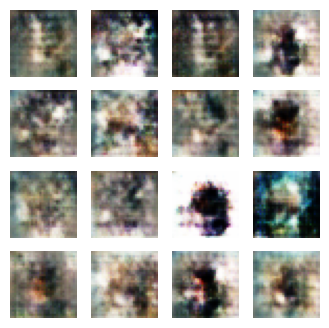

Time for epoch 381 is 4.163060426712036 sec
Time for epoch 382 is 3.507025957107544 sec
Time for epoch 383 is 3.641620635986328 sec
Time for epoch 384 is 3.682049512863159 sec
Time for epoch 385 is 3.6103556156158447 sec
Time for epoch 386 is 3.63765549659729 sec
Time for epoch 387 is 3.644460439682007 sec
Time for epoch 388 is 3.672952175140381 sec
Time for epoch 389 is 3.6114673614501953 sec
Time for epoch 390 is 3.6442337036132812 sec
Time for epoch 391 is 3.6465446949005127 sec
Time for epoch 392 is 3.6269688606262207 sec
Time for epoch 393 is 3.629030227661133 sec
Time for epoch 394 is 3.6321637630462646 sec
Time for epoch 395 is 3.657078504562378 sec
Time for epoch 396 is 3.628455877304077 sec
Time for epoch 397 is 3.6559066772460938 sec
Time for epoch 398 is 3.642688274383545 sec
Time for epoch 399 is 5.102910041809082 sec
Time for epoch 400 is 3.485553503036499 sec


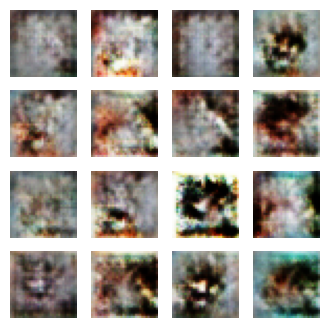

Time for epoch 401 is 4.323864459991455 sec
Time for epoch 402 is 3.484140396118164 sec
Time for epoch 403 is 3.620213270187378 sec
Time for epoch 404 is 3.623107433319092 sec
Time for epoch 405 is 3.6270992755889893 sec
Time for epoch 406 is 3.621548891067505 sec
Time for epoch 407 is 3.629680871963501 sec
Time for epoch 408 is 3.653327226638794 sec
Time for epoch 409 is 3.642029047012329 sec
Time for epoch 410 is 3.6392247676849365 sec
Time for epoch 411 is 3.6444242000579834 sec
Time for epoch 412 is 3.633709669113159 sec
Time for epoch 413 is 3.6601476669311523 sec
Time for epoch 414 is 3.6403191089630127 sec
Time for epoch 415 is 3.6448514461517334 sec
Time for epoch 416 is 3.6509811878204346 sec
Time for epoch 417 is 3.660606861114502 sec
Time for epoch 418 is 3.6413915157318115 sec
Time for epoch 419 is 3.64825701713562 sec
Time for epoch 420 is 3.6622211933135986 sec


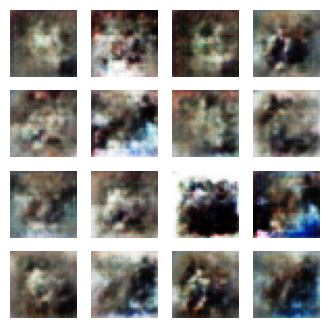

Time for epoch 421 is 4.171409845352173 sec
Time for epoch 422 is 3.509108543395996 sec
Time for epoch 423 is 3.658583402633667 sec
Time for epoch 424 is 3.644660711288452 sec
Time for epoch 425 is 3.640256881713867 sec
Time for epoch 426 is 3.646388530731201 sec
Time for epoch 427 is 3.64951229095459 sec
Time for epoch 428 is 3.6391656398773193 sec
Time for epoch 429 is 3.6457061767578125 sec
Time for epoch 430 is 3.652836322784424 sec
Time for epoch 431 is 3.6470959186553955 sec
Time for epoch 432 is 3.6433606147766113 sec
Time for epoch 433 is 3.6472859382629395 sec
Time for epoch 434 is 3.6546578407287598 sec
Time for epoch 435 is 3.6556601524353027 sec
Time for epoch 436 is 3.6524341106414795 sec
Time for epoch 437 is 3.651348114013672 sec
Time for epoch 438 is 3.6553750038146973 sec
Time for epoch 439 is 3.650926351547241 sec
Time for epoch 440 is 3.6484432220458984 sec


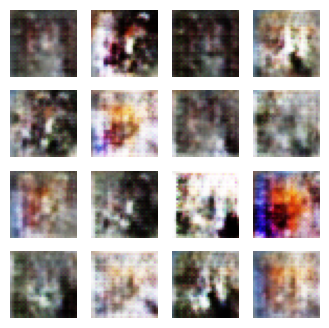

Time for epoch 441 is 4.197178602218628 sec
Time for epoch 442 is 3.4889729022979736 sec
Time for epoch 443 is 3.619262456893921 sec
Time for epoch 444 is 3.6465201377868652 sec
Time for epoch 445 is 3.6330366134643555 sec
Time for epoch 446 is 3.6976585388183594 sec
Time for epoch 447 is 3.620877504348755 sec
Time for epoch 448 is 3.6530215740203857 sec
Time for epoch 449 is 3.6439013481140137 sec
Time for epoch 450 is 3.6966466903686523 sec
Time for epoch 451 is 3.615492343902588 sec
Time for epoch 452 is 3.6601145267486572 sec
Time for epoch 453 is 3.650907039642334 sec
Time for epoch 454 is 3.628514051437378 sec
Time for epoch 455 is 3.6451237201690674 sec
Time for epoch 456 is 3.6532344818115234 sec
Time for epoch 457 is 3.645009756088257 sec
Time for epoch 458 is 3.6330959796905518 sec
Time for epoch 459 is 3.6318628787994385 sec
Time for epoch 460 is 3.641381025314331 sec


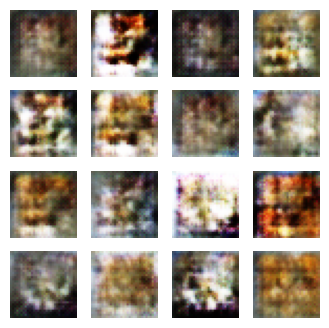

Time for epoch 461 is 4.237340927124023 sec
Time for epoch 462 is 3.508497714996338 sec
Time for epoch 463 is 3.625016927719116 sec
Time for epoch 464 is 3.630474805831909 sec
Time for epoch 465 is 3.6207308769226074 sec
Time for epoch 466 is 3.6278672218322754 sec
Time for epoch 467 is 3.6264472007751465 sec
Time for epoch 468 is 3.6246073246002197 sec
Time for epoch 469 is 3.6201744079589844 sec
Time for epoch 470 is 3.618056058883667 sec
Time for epoch 471 is 3.622770071029663 sec
Time for epoch 472 is 3.6229889392852783 sec
Time for epoch 473 is 5.10338020324707 sec
Time for epoch 474 is 3.474701166152954 sec
Time for epoch 475 is 3.633666753768921 sec
Time for epoch 476 is 3.6205368041992188 sec
Time for epoch 477 is 3.6213126182556152 sec
Time for epoch 478 is 3.622997760772705 sec
Time for epoch 479 is 3.6264917850494385 sec
Time for epoch 480 is 3.6399528980255127 sec


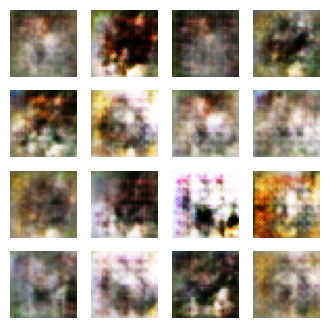

Time for epoch 481 is 4.423828840255737 sec
Time for epoch 482 is 3.520116090774536 sec
Time for epoch 483 is 3.653111457824707 sec
Time for epoch 484 is 3.6445038318634033 sec
Time for epoch 485 is 3.653789758682251 sec
Time for epoch 486 is 3.682382583618164 sec
Time for epoch 487 is 3.6246371269226074 sec
Time for epoch 488 is 3.6527259349823 sec
Time for epoch 489 is 3.6415796279907227 sec
Time for epoch 490 is 3.622741460800171 sec
Time for epoch 491 is 3.646759271621704 sec
Time for epoch 492 is 3.6588051319122314 sec
Time for epoch 493 is 3.6768791675567627 sec
Time for epoch 494 is 3.612645387649536 sec
Time for epoch 495 is 3.659454822540283 sec
Time for epoch 496 is 3.6433324813842773 sec
Time for epoch 497 is 3.674823045730591 sec
Time for epoch 498 is 3.615091562271118 sec
Time for epoch 499 is 3.6538548469543457 sec
Time for epoch 500 is 3.6262810230255127 sec


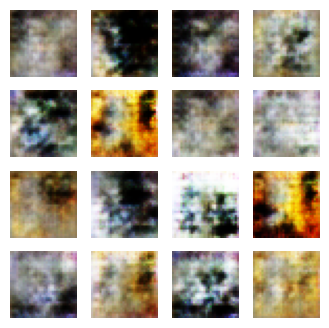

Time for epoch 501 is 4.3673694133758545 sec
Time for epoch 502 is 3.510014533996582 sec
Time for epoch 503 is 3.6284561157226562 sec
Time for epoch 504 is 3.6274776458740234 sec
Time for epoch 505 is 3.6416432857513428 sec
Time for epoch 506 is 3.6422295570373535 sec
Time for epoch 507 is 3.6412668228149414 sec
Time for epoch 508 is 3.64530611038208 sec
Time for epoch 509 is 3.640443801879883 sec
Time for epoch 510 is 3.6407830715179443 sec
Time for epoch 511 is 3.64202618598938 sec
Time for epoch 512 is 3.6802899837493896 sec
Time for epoch 513 is 3.6011159420013428 sec
Time for epoch 514 is 3.653951406478882 sec
Time for epoch 515 is 5.102925777435303 sec
Time for epoch 516 is 3.496131658554077 sec
Time for epoch 517 is 3.633094549179077 sec
Time for epoch 518 is 3.6596808433532715 sec
Time for epoch 519 is 3.592515468597412 sec
Time for epoch 520 is 3.623014211654663 sec


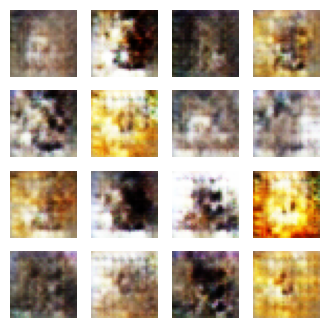

Time for epoch 521 is 4.142976760864258 sec
Time for epoch 522 is 3.492267608642578 sec
Time for epoch 523 is 3.6413748264312744 sec
Time for epoch 524 is 3.6233808994293213 sec
Time for epoch 525 is 3.624788999557495 sec
Time for epoch 526 is 3.631514072418213 sec
Time for epoch 527 is 3.6470947265625 sec
Time for epoch 528 is 3.647615909576416 sec
Time for epoch 529 is 3.651181697845459 sec
Time for epoch 530 is 3.6588709354400635 sec
Time for epoch 531 is 3.6473312377929688 sec
Time for epoch 532 is 3.664811134338379 sec
Time for epoch 533 is 3.6546733379364014 sec
Time for epoch 534 is 3.654600143432617 sec
Time for epoch 535 is 3.65023136138916 sec
Time for epoch 536 is 3.6483569145202637 sec
Time for epoch 537 is 3.678511142730713 sec
Time for epoch 538 is 3.619229316711426 sec
Time for epoch 539 is 3.6489741802215576 sec
Time for epoch 540 is 3.6440250873565674 sec


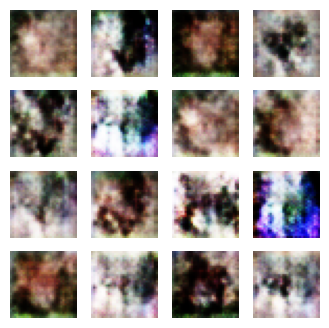

Time for epoch 541 is 4.169092416763306 sec
Time for epoch 542 is 3.520378828048706 sec
Time for epoch 543 is 3.6489133834838867 sec
Time for epoch 544 is 3.6378135681152344 sec
Time for epoch 545 is 3.640748977661133 sec
Time for epoch 546 is 3.6231255531311035 sec
Time for epoch 547 is 3.6240203380584717 sec
Time for epoch 548 is 3.644946336746216 sec
Time for epoch 549 is 3.619565010070801 sec
Time for epoch 550 is 3.6224355697631836 sec
Time for epoch 551 is 3.6241626739501953 sec
Time for epoch 552 is 3.625220537185669 sec
Time for epoch 553 is 3.6412999629974365 sec
Time for epoch 554 is 3.625797748565674 sec
Time for epoch 555 is 3.6245038509368896 sec
Time for epoch 556 is 3.62221360206604 sec
Time for epoch 557 is 3.6259446144104004 sec
Time for epoch 558 is 3.6429877281188965 sec
Time for epoch 559 is 3.6643731594085693 sec
Time for epoch 560 is 3.5841591358184814 sec


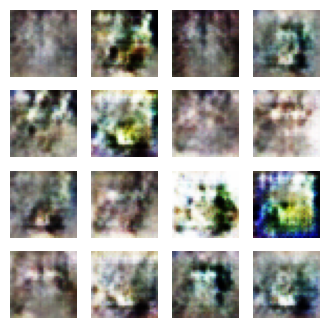

Time for epoch 561 is 4.445026397705078 sec
Time for epoch 562 is 3.487959146499634 sec
Time for epoch 563 is 3.619098663330078 sec
Time for epoch 564 is 3.6235129833221436 sec
Time for epoch 565 is 3.6216022968292236 sec
Time for epoch 566 is 3.6269938945770264 sec
Time for epoch 567 is 3.6346137523651123 sec
Time for epoch 568 is 3.624528408050537 sec
Time for epoch 569 is 3.6228272914886475 sec
Time for epoch 570 is 3.6539649963378906 sec
Time for epoch 571 is 3.5855517387390137 sec
Time for epoch 572 is 3.6207706928253174 sec
Time for epoch 573 is 3.6264286041259766 sec
Time for epoch 574 is 3.661480188369751 sec
Time for epoch 575 is 3.611461877822876 sec
Time for epoch 576 is 3.6243326663970947 sec
Time for epoch 577 is 3.6501240730285645 sec
Time for epoch 578 is 3.6309423446655273 sec
Time for epoch 579 is 3.6343741416931152 sec
Time for epoch 580 is 3.6225666999816895 sec


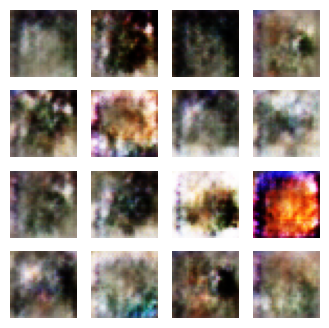

Time for epoch 581 is 4.362540006637573 sec
Time for epoch 582 is 3.5035250186920166 sec
Time for epoch 583 is 3.6421594619750977 sec
Time for epoch 584 is 3.6243083477020264 sec
Time for epoch 585 is 3.6248855590820312 sec
Time for epoch 586 is 3.619067430496216 sec
Time for epoch 587 is 3.644380569458008 sec
Time for epoch 588 is 3.6269354820251465 sec
Time for epoch 589 is 3.6223580837249756 sec
Time for epoch 590 is 3.6227023601531982 sec
Time for epoch 591 is 3.6294000148773193 sec
Time for epoch 592 is 3.6432864665985107 sec
Time for epoch 593 is 3.642035722732544 sec
Time for epoch 594 is 3.6436188220977783 sec
Time for epoch 595 is 3.628384828567505 sec
Time for epoch 596 is 3.646416187286377 sec
Time for epoch 597 is 3.6369874477386475 sec
Time for epoch 598 is 3.638869047164917 sec
Time for epoch 599 is 3.682741403579712 sec
Time for epoch 600 is 3.614325761795044 sec


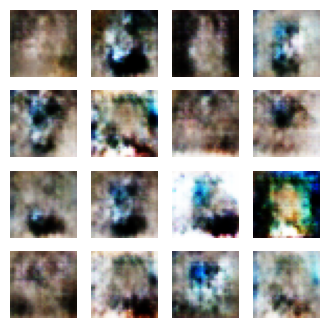

Time for epoch 601 is 4.1515398025512695 sec
Time for epoch 602 is 3.4981205463409424 sec
Time for epoch 603 is 3.624325752258301 sec
Time for epoch 604 is 3.6393883228302 sec
Time for epoch 605 is 3.6411149501800537 sec
Time for epoch 606 is 3.6272616386413574 sec
Time for epoch 607 is 3.6567277908325195 sec
Time for epoch 608 is 3.643049955368042 sec
Time for epoch 609 is 3.6327126026153564 sec
Time for epoch 610 is 3.645174503326416 sec
Time for epoch 611 is 3.642455577850342 sec
Time for epoch 612 is 3.6436779499053955 sec
Time for epoch 613 is 3.6412558555603027 sec
Time for epoch 614 is 3.671109676361084 sec
Time for epoch 615 is 3.60905122756958 sec
Time for epoch 616 is 3.6439414024353027 sec
Time for epoch 617 is 3.647789239883423 sec
Time for epoch 618 is 3.6585583686828613 sec
Time for epoch 619 is 3.636411428451538 sec
Time for epoch 620 is 3.653374671936035 sec


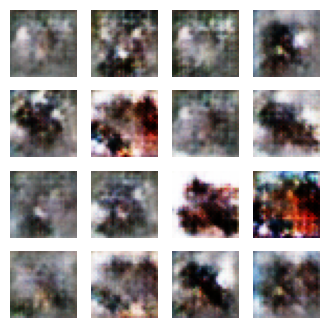

Time for epoch 621 is 4.380358457565308 sec
Time for epoch 622 is 3.5137805938720703 sec
Time for epoch 623 is 3.6470203399658203 sec
Time for epoch 624 is 3.6445858478546143 sec
Time for epoch 625 is 3.648169755935669 sec
Time for epoch 626 is 3.651329755783081 sec
Time for epoch 627 is 3.6513383388519287 sec
Time for epoch 628 is 3.643130302429199 sec
Time for epoch 629 is 3.6537957191467285 sec
Time for epoch 630 is 3.649827718734741 sec
Time for epoch 631 is 3.6590421199798584 sec
Time for epoch 632 is 3.645664691925049 sec
Time for epoch 633 is 3.652920722961426 sec
Time for epoch 634 is 3.6655795574188232 sec
Time for epoch 635 is 3.6558690071105957 sec
Time for epoch 636 is 3.665304183959961 sec
Time for epoch 637 is 3.660130500793457 sec
Time for epoch 638 is 3.647010326385498 sec
Time for epoch 639 is 3.6613802909851074 sec
Time for epoch 640 is 3.6559829711914062 sec


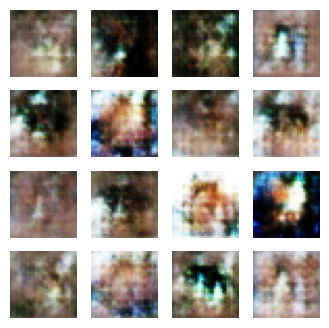

Time for epoch 641 is 4.192933082580566 sec
Time for epoch 642 is 3.5207362174987793 sec
Time for epoch 643 is 5.102768182754517 sec
Time for epoch 644 is 3.489607095718384 sec
Time for epoch 645 is 3.641035556793213 sec
Time for epoch 646 is 3.6456243991851807 sec
Time for epoch 647 is 3.6293416023254395 sec
Time for epoch 648 is 3.6259448528289795 sec
Time for epoch 649 is 3.626500368118286 sec
Time for epoch 650 is 3.648041009902954 sec
Time for epoch 651 is 3.643503189086914 sec
Time for epoch 652 is 3.6587164402008057 sec
Time for epoch 653 is 3.648714303970337 sec
Time for epoch 654 is 3.6555023193359375 sec
Time for epoch 655 is 3.6382508277893066 sec
Time for epoch 656 is 3.656890630722046 sec
Time for epoch 657 is 3.6605069637298584 sec
Time for epoch 658 is 3.683450222015381 sec
Time for epoch 659 is 3.6201934814453125 sec
Time for epoch 660 is 3.6468091011047363 sec


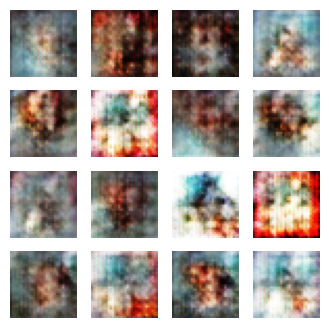

Time for epoch 661 is 4.766798734664917 sec
Time for epoch 662 is 3.521548271179199 sec
Time for epoch 663 is 3.6303906440734863 sec
Time for epoch 664 is 3.63741135597229 sec
Time for epoch 665 is 3.644094228744507 sec
Time for epoch 666 is 3.6428449153900146 sec
Time for epoch 667 is 3.6522955894470215 sec
Time for epoch 668 is 3.6357524394989014 sec
Time for epoch 669 is 3.6581242084503174 sec
Time for epoch 670 is 3.6581342220306396 sec
Time for epoch 671 is 3.6573355197906494 sec
Time for epoch 672 is 3.6890265941619873 sec
Time for epoch 673 is 3.628649950027466 sec
Time for epoch 674 is 3.6429531574249268 sec
Time for epoch 675 is 3.6247177124023438 sec
Time for epoch 676 is 3.6567304134368896 sec
Time for epoch 677 is 3.6572341918945312 sec
Time for epoch 678 is 3.658230781555176 sec
Time for epoch 679 is 3.6625657081604004 sec
Time for epoch 680 is 3.644566774368286 sec


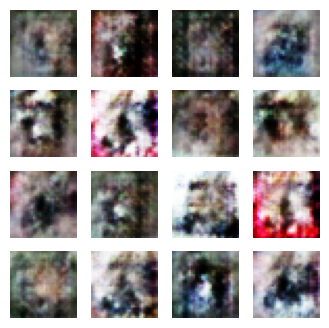

Time for epoch 681 is 4.17194938659668 sec
Time for epoch 682 is 3.508362054824829 sec
Time for epoch 683 is 3.6414096355438232 sec
Time for epoch 684 is 3.6531972885131836 sec
Time for epoch 685 is 3.650233745574951 sec
Time for epoch 686 is 3.648773193359375 sec
Time for epoch 687 is 3.6632490158081055 sec
Time for epoch 688 is 3.652906656265259 sec
Time for epoch 689 is 3.655310869216919 sec
Time for epoch 690 is 3.6469497680664062 sec
Time for epoch 691 is 3.6583852767944336 sec
Time for epoch 692 is 3.6434741020202637 sec
Time for epoch 693 is 3.648587703704834 sec
Time for epoch 694 is 3.6558759212493896 sec
Time for epoch 695 is 3.6492514610290527 sec
Time for epoch 696 is 3.659738540649414 sec
Time for epoch 697 is 3.66401743888855 sec
Time for epoch 698 is 3.666184663772583 sec
Time for epoch 699 is 3.6592562198638916 sec
Time for epoch 700 is 3.653404951095581 sec


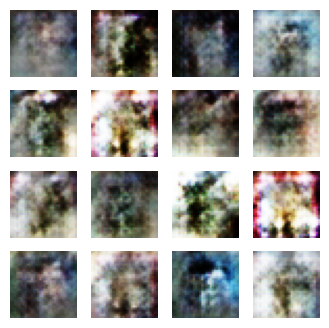

Time for epoch 701 is 4.319655895233154 sec
Time for epoch 702 is 3.509765863418579 sec
Time for epoch 703 is 3.6292049884796143 sec
Time for epoch 704 is 3.6594185829162598 sec
Time for epoch 705 is 3.650400161743164 sec
Time for epoch 706 is 3.6435205936431885 sec
Time for epoch 707 is 3.6457135677337646 sec
Time for epoch 708 is 5.102866888046265 sec
Time for epoch 709 is 3.4810993671417236 sec
Time for epoch 710 is 3.6256041526794434 sec
Time for epoch 711 is 3.6417949199676514 sec
Time for epoch 712 is 3.642853260040283 sec
Time for epoch 713 is 3.651439666748047 sec
Time for epoch 714 is 3.654654026031494 sec
Time for epoch 715 is 3.650357723236084 sec
Time for epoch 716 is 3.6894803047180176 sec
Time for epoch 717 is 3.628063201904297 sec
Time for epoch 718 is 3.655390977859497 sec
Time for epoch 719 is 3.6680917739868164 sec
Time for epoch 720 is 3.6048033237457275 sec


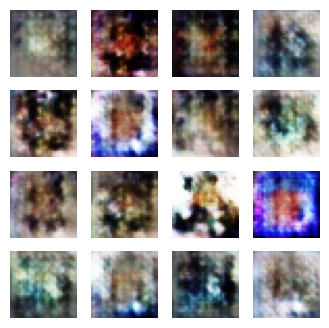

Time for epoch 721 is 4.131143569946289 sec
Time for epoch 722 is 3.5361571311950684 sec
Time for epoch 723 is 3.65502667427063 sec
Time for epoch 724 is 3.6545557975769043 sec
Time for epoch 725 is 3.6591501235961914 sec
Time for epoch 726 is 3.6563608646392822 sec
Time for epoch 727 is 3.6897501945495605 sec
Time for epoch 728 is 3.624735116958618 sec
Time for epoch 729 is 3.6463139057159424 sec
Time for epoch 730 is 3.6631686687469482 sec
Time for epoch 731 is 3.6471920013427734 sec
Time for epoch 732 is 3.6626384258270264 sec
Time for epoch 733 is 3.6560423374176025 sec
Time for epoch 734 is 3.64719295501709 sec
Time for epoch 735 is 3.646010160446167 sec
Time for epoch 736 is 3.658820152282715 sec
Time for epoch 737 is 3.652215003967285 sec
Time for epoch 738 is 3.6480088233947754 sec
Time for epoch 739 is 3.6560959815979004 sec
Time for epoch 740 is 3.6513404846191406 sec


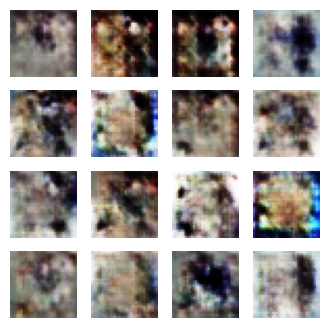

Time for epoch 741 is 4.371170997619629 sec
Time for epoch 742 is 3.5062453746795654 sec
Time for epoch 743 is 3.6408257484436035 sec
Time for epoch 744 is 3.6389784812927246 sec
Time for epoch 745 is 3.6552340984344482 sec
Time for epoch 746 is 3.6550943851470947 sec
Time for epoch 747 is 3.644443988800049 sec
Time for epoch 748 is 3.6420962810516357 sec
Time for epoch 749 is 3.642610549926758 sec
Time for epoch 750 is 3.6419472694396973 sec
Time for epoch 751 is 3.6484739780426025 sec
Time for epoch 752 is 3.656193494796753 sec
Time for epoch 753 is 3.647226333618164 sec
Time for epoch 754 is 3.6553220748901367 sec
Time for epoch 755 is 3.648237705230713 sec
Time for epoch 756 is 3.649362564086914 sec
Time for epoch 757 is 3.6348421573638916 sec
Time for epoch 758 is 3.6502654552459717 sec
Time for epoch 759 is 3.6523778438568115 sec
Time for epoch 760 is 3.680133819580078 sec


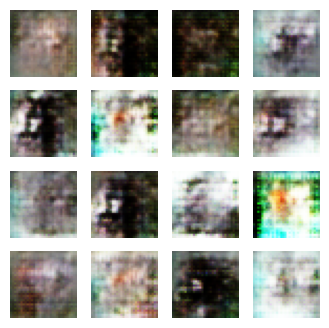

Time for epoch 761 is 4.3111631870269775 sec
Time for epoch 762 is 3.492100954055786 sec
Time for epoch 763 is 3.651160478591919 sec
Time for epoch 764 is 3.646026849746704 sec
Time for epoch 765 is 3.6421475410461426 sec
Time for epoch 766 is 3.6480157375335693 sec
Time for epoch 767 is 3.7060446739196777 sec
Time for epoch 768 is 3.6233911514282227 sec
Time for epoch 769 is 3.6671504974365234 sec
Time for epoch 770 is 3.6570632457733154 sec
Time for epoch 771 is 3.667360305786133 sec
Time for epoch 772 is 3.64044451713562 sec
Time for epoch 773 is 3.655257225036621 sec
Time for epoch 774 is 3.666491985321045 sec
Time for epoch 775 is 3.6556947231292725 sec
Time for epoch 776 is 3.6618611812591553 sec
Time for epoch 777 is 3.652348756790161 sec
Time for epoch 778 is 3.69393253326416 sec
Time for epoch 779 is 3.61934494972229 sec
Time for epoch 780 is 3.66243577003479 sec


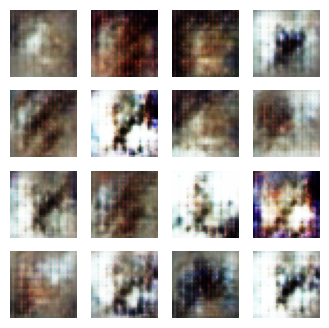

Time for epoch 781 is 4.1951904296875 sec
Time for epoch 782 is 3.5109353065490723 sec
Time for epoch 783 is 3.637766122817993 sec
Time for epoch 784 is 3.6514041423797607 sec
Time for epoch 785 is 3.6625945568084717 sec
Time for epoch 786 is 3.6390457153320312 sec
Time for epoch 787 is 3.644031524658203 sec
Time for epoch 788 is 3.6405134201049805 sec
Time for epoch 789 is 3.6461875438690186 sec
Time for epoch 790 is 3.6556451320648193 sec
Time for epoch 791 is 3.6469411849975586 sec
Time for epoch 792 is 3.65289568901062 sec
Time for epoch 793 is 3.654287099838257 sec
Time for epoch 794 is 3.6238656044006348 sec
Time for epoch 795 is 3.6374664306640625 sec
Time for epoch 796 is 3.674128770828247 sec
Time for epoch 797 is 3.619252920150757 sec
Time for epoch 798 is 3.657397508621216 sec
Time for epoch 799 is 3.650757074356079 sec
Time for epoch 800 is 3.649218797683716 sec


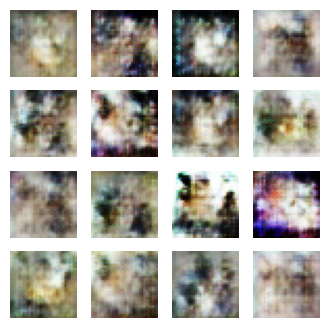

Time for epoch 801 is 4.1945037841796875 sec
Time for epoch 802 is 3.5080173015594482 sec
Time for epoch 803 is 3.652036190032959 sec
Time for epoch 804 is 3.65014910697937 sec
Time for epoch 805 is 3.637895345687866 sec
Time for epoch 806 is 3.6427760124206543 sec
Time for epoch 807 is 3.6391756534576416 sec
Time for epoch 808 is 3.6483707427978516 sec
Time for epoch 809 is 3.6440682411193848 sec
Time for epoch 810 is 3.6407322883605957 sec
Time for epoch 811 is 3.6467125415802 sec
Time for epoch 812 is 3.6463334560394287 sec
Time for epoch 813 is 3.647653102874756 sec
Time for epoch 814 is 3.6461341381073 sec
Time for epoch 815 is 3.6502041816711426 sec
Time for epoch 816 is 3.6440229415893555 sec
Time for epoch 817 is 3.6527743339538574 sec
Time for epoch 818 is 3.6568024158477783 sec
Time for epoch 819 is 3.6571743488311768 sec
Time for epoch 820 is 3.6466867923736572 sec


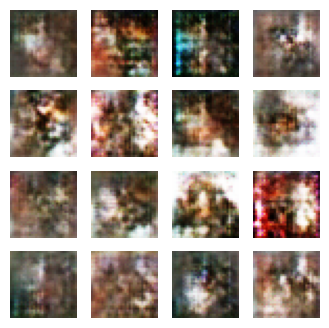

Time for epoch 821 is 4.185041189193726 sec
Time for epoch 822 is 3.5118000507354736 sec
Time for epoch 823 is 3.643439292907715 sec
Time for epoch 824 is 3.6582698822021484 sec
Time for epoch 825 is 3.644057273864746 sec
Time for epoch 826 is 3.6773953437805176 sec
Time for epoch 827 is 3.60941743850708 sec
Time for epoch 828 is 3.6523993015289307 sec
Time for epoch 829 is 3.653024911880493 sec
Time for epoch 830 is 3.6440463066101074 sec
Time for epoch 831 is 3.641042470932007 sec
Time for epoch 832 is 3.6523115634918213 sec
Time for epoch 833 is 3.640490770339966 sec
Time for epoch 834 is 3.655499219894409 sec
Time for epoch 835 is 3.6509947776794434 sec
Time for epoch 836 is 3.6559884548187256 sec
Time for epoch 837 is 3.6505813598632812 sec
Time for epoch 838 is 3.655974864959717 sec
Time for epoch 839 is 3.644460678100586 sec
Time for epoch 840 is 3.642538547515869 sec


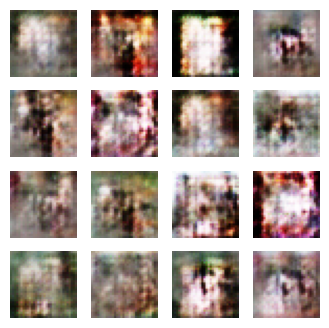

Time for epoch 841 is 4.470057010650635 sec
Time for epoch 842 is 3.5017848014831543 sec
Time for epoch 843 is 3.625053644180298 sec
Time for epoch 844 is 3.6460633277893066 sec
Time for epoch 845 is 3.6421284675598145 sec
Time for epoch 846 is 3.6261894702911377 sec
Time for epoch 847 is 3.641509771347046 sec
Time for epoch 848 is 3.651676893234253 sec
Time for epoch 849 is 3.641282320022583 sec
Time for epoch 850 is 3.623234987258911 sec
Time for epoch 851 is 3.648796319961548 sec
Time for epoch 852 is 3.644115447998047 sec
Time for epoch 853 is 3.6412782669067383 sec
Time for epoch 854 is 3.644104480743408 sec
Time for epoch 855 is 3.64250111579895 sec
Time for epoch 856 is 3.6311352252960205 sec
Time for epoch 857 is 3.653872013092041 sec
Time for epoch 858 is 3.645395040512085 sec
Time for epoch 859 is 3.6473469734191895 sec
Time for epoch 860 is 3.646466016769409 sec


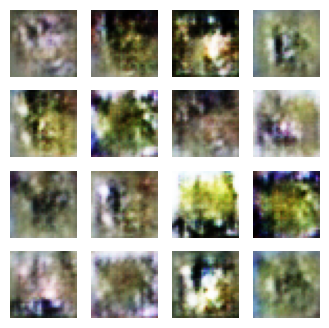

Time for epoch 861 is 4.166255235671997 sec
Time for epoch 862 is 3.5277514457702637 sec
Time for epoch 863 is 3.5992748737335205 sec
Time for epoch 864 is 3.644455909729004 sec
Time for epoch 865 is 3.6351797580718994 sec
Time for epoch 866 is 3.6432442665100098 sec
Time for epoch 867 is 3.628598690032959 sec
Time for epoch 868 is 3.6461448669433594 sec
Time for epoch 869 is 3.647814989089966 sec
Time for epoch 870 is 3.6394102573394775 sec
Time for epoch 871 is 3.6505067348480225 sec
Time for epoch 872 is 3.644486427307129 sec
Time for epoch 873 is 3.6462457180023193 sec
Time for epoch 874 is 3.6621451377868652 sec
Time for epoch 875 is 3.6560301780700684 sec
Time for epoch 876 is 3.6456046104431152 sec
Time for epoch 877 is 3.64808988571167 sec
Time for epoch 878 is 3.6542234420776367 sec
Time for epoch 879 is 3.6450693607330322 sec
Time for epoch 880 is 3.6445438861846924 sec


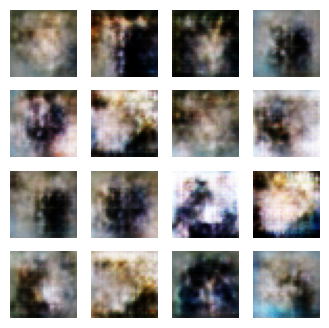

Time for epoch 881 is 4.376611948013306 sec
Time for epoch 882 is 3.5073249340057373 sec
Time for epoch 883 is 3.6495025157928467 sec
Time for epoch 884 is 3.6442010402679443 sec
Time for epoch 885 is 3.6463191509246826 sec
Time for epoch 886 is 3.644400119781494 sec
Time for epoch 887 is 3.646888494491577 sec
Time for epoch 888 is 3.6346511840820312 sec
Time for epoch 889 is 3.6573097705841064 sec
Time for epoch 890 is 3.6493144035339355 sec
Time for epoch 891 is 3.657047986984253 sec
Time for epoch 892 is 3.677760124206543 sec
Time for epoch 893 is 3.607611894607544 sec
Time for epoch 894 is 3.6542727947235107 sec
Time for epoch 895 is 3.6537699699401855 sec
Time for epoch 896 is 3.647204875946045 sec
Time for epoch 897 is 3.65696120262146 sec
Time for epoch 898 is 3.645860433578491 sec
Time for epoch 899 is 3.6506693363189697 sec
Time for epoch 900 is 3.6562771797180176 sec


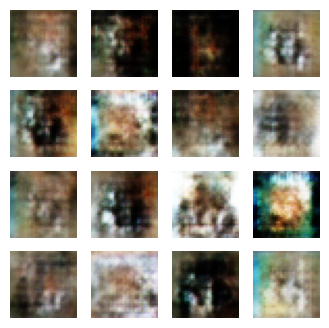

Time for epoch 901 is 4.164438486099243 sec
Time for epoch 902 is 3.5112030506134033 sec
Time for epoch 903 is 3.637451171875 sec
Time for epoch 904 is 3.637575626373291 sec
Time for epoch 905 is 3.632878303527832 sec
Time for epoch 906 is 3.6440510749816895 sec
Time for epoch 907 is 3.648895263671875 sec
Time for epoch 908 is 3.642305374145508 sec
Time for epoch 909 is 3.653452157974243 sec
Time for epoch 910 is 3.655992269515991 sec
Time for epoch 911 is 3.635612726211548 sec
Time for epoch 912 is 3.642500877380371 sec
Time for epoch 913 is 3.6427161693573 sec
Time for epoch 914 is 3.638793706893921 sec
Time for epoch 915 is 3.6299917697906494 sec
Time for epoch 916 is 3.646815061569214 sec
Time for epoch 917 is 3.6445679664611816 sec
Time for epoch 918 is 3.646366596221924 sec
Time for epoch 919 is 3.642751693725586 sec
Time for epoch 920 is 3.6364188194274902 sec


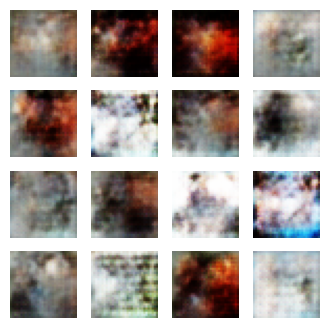

Time for epoch 921 is 4.662935018539429 sec
Time for epoch 922 is 3.4902918338775635 sec
Time for epoch 923 is 3.631941556930542 sec
Time for epoch 924 is 3.6544699668884277 sec
Time for epoch 925 is 3.598391532897949 sec
Time for epoch 926 is 3.64005446434021 sec
Time for epoch 927 is 3.6227033138275146 sec
Time for epoch 928 is 3.64076828956604 sec
Time for epoch 929 is 3.627178192138672 sec
Time for epoch 930 is 3.6220126152038574 sec
Time for epoch 931 is 3.643099069595337 sec
Time for epoch 932 is 3.628432273864746 sec
Time for epoch 933 is 3.63645601272583 sec
Time for epoch 934 is 3.6426610946655273 sec
Time for epoch 935 is 3.626312494277954 sec
Time for epoch 936 is 3.675178289413452 sec
Time for epoch 937 is 3.6046860218048096 sec
Time for epoch 938 is 3.6232099533081055 sec
Time for epoch 939 is 3.624631404876709 sec
Time for epoch 940 is 3.630213737487793 sec


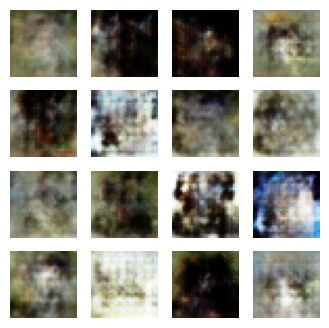

Time for epoch 941 is 4.143950939178467 sec
Time for epoch 942 is 3.507507801055908 sec
Time for epoch 943 is 3.6311850547790527 sec
Time for epoch 944 is 3.6243104934692383 sec
Time for epoch 945 is 3.636146306991577 sec
Time for epoch 946 is 3.641185760498047 sec
Time for epoch 947 is 3.6349830627441406 sec
Time for epoch 948 is 3.638967752456665 sec
Time for epoch 949 is 3.6386284828186035 sec
Time for epoch 950 is 3.647599697113037 sec
Time for epoch 951 is 3.6456198692321777 sec
Time for epoch 952 is 3.6197404861450195 sec
Time for epoch 953 is 3.6431171894073486 sec
Time for epoch 954 is 5.102534055709839 sec
Time for epoch 955 is 3.48958683013916 sec
Time for epoch 956 is 3.6197216510772705 sec
Time for epoch 957 is 3.623835563659668 sec
Time for epoch 958 is 3.635803461074829 sec
Time for epoch 959 is 3.6381072998046875 sec
Time for epoch 960 is 3.6240859031677246 sec


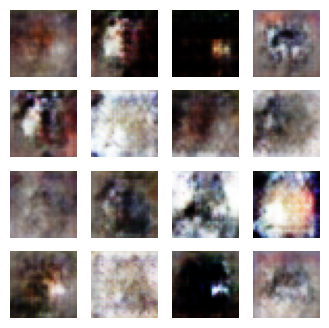

Time for epoch 961 is 4.330835819244385 sec
Time for epoch 962 is 3.50661563873291 sec
Time for epoch 963 is 3.6432783603668213 sec
Time for epoch 964 is 3.6404342651367188 sec
Time for epoch 965 is 3.6463844776153564 sec
Time for epoch 966 is 3.6467318534851074 sec
Time for epoch 967 is 3.6605427265167236 sec
Time for epoch 968 is 3.6531333923339844 sec
Time for epoch 969 is 3.655501365661621 sec
Time for epoch 970 is 3.6467013359069824 sec
Time for epoch 971 is 3.6652936935424805 sec
Time for epoch 972 is 3.660862684249878 sec
Time for epoch 973 is 3.659869909286499 sec
Time for epoch 974 is 3.6449294090270996 sec
Time for epoch 975 is 3.661604166030884 sec
Time for epoch 976 is 3.6475043296813965 sec
Time for epoch 977 is 3.62571382522583 sec
Time for epoch 978 is 3.644850492477417 sec
Time for epoch 979 is 3.626497507095337 sec
Time for epoch 980 is 3.631347894668579 sec


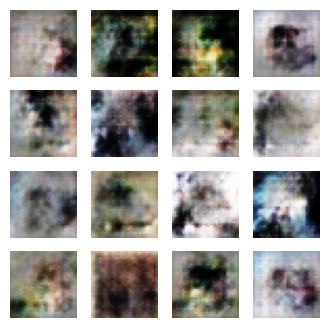

Time for epoch 981 is 4.15507173538208 sec
Time for epoch 982 is 3.511380672454834 sec
Time for epoch 983 is 3.6257879734039307 sec
Time for epoch 984 is 3.6385650634765625 sec
Time for epoch 985 is 3.6410765647888184 sec
Time for epoch 986 is 3.62064528465271 sec
Time for epoch 987 is 3.623483180999756 sec
Time for epoch 988 is 3.6193690299987793 sec
Time for epoch 989 is 3.6199190616607666 sec
Time for epoch 990 is 3.6220240592956543 sec
Time for epoch 991 is 3.626599073410034 sec
Time for epoch 992 is 3.6182851791381836 sec
Time for epoch 993 is 3.6210498809814453 sec
Time for epoch 994 is 3.623974084854126 sec
Time for epoch 995 is 3.619094133377075 sec
Time for epoch 996 is 3.6277525424957275 sec
Time for epoch 997 is 3.6242456436157227 sec
Time for epoch 998 is 3.6546425819396973 sec
Time for epoch 999 is 3.59224271774292 sec
Time for epoch 1000 is 3.6208834648132324 sec


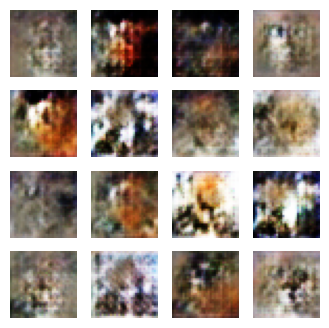

Time for epoch 1001 is 4.140007972717285 sec
Time for epoch 1002 is 3.484227418899536 sec
Time for epoch 1003 is 3.621706962585449 sec
Time for epoch 1004 is 3.6226606369018555 sec
Time for epoch 1005 is 3.624569892883301 sec
Time for epoch 1006 is 3.6186351776123047 sec
Time for epoch 1007 is 3.6217076778411865 sec
Time for epoch 1008 is 3.624603748321533 sec
Time for epoch 1009 is 3.6183247566223145 sec
Time for epoch 1010 is 3.6195077896118164 sec
Time for epoch 1011 is 3.6235735416412354 sec
Time for epoch 1012 is 3.622084617614746 sec
Time for epoch 1013 is 3.6276133060455322 sec
Time for epoch 1014 is 3.630143165588379 sec
Time for epoch 1015 is 3.6400601863861084 sec
Time for epoch 1016 is 3.6313936710357666 sec
Time for epoch 1017 is 3.635437250137329 sec
Time for epoch 1018 is 3.6555871963500977 sec
Time for epoch 1019 is 3.6544227600097656 sec
Time for epoch 1020 is 3.68881893157959 sec


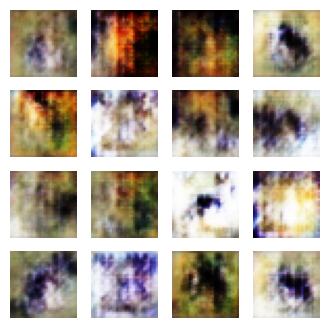

Time for epoch 1021 is 4.447909832000732 sec
Time for epoch 1022 is 3.5235633850097656 sec
Time for epoch 1023 is 3.6440250873565674 sec
Time for epoch 1024 is 3.6472420692443848 sec
Time for epoch 1025 is 3.638915538787842 sec
Time for epoch 1026 is 3.6530306339263916 sec
Time for epoch 1027 is 3.664722204208374 sec
Time for epoch 1028 is 3.662449836730957 sec
Time for epoch 1029 is 3.670579433441162 sec
Time for epoch 1030 is 3.667151927947998 sec
Time for epoch 1031 is 3.6906278133392334 sec
Time for epoch 1032 is 3.623159408569336 sec
Time for epoch 1033 is 3.6489083766937256 sec
Time for epoch 1034 is 3.6431455612182617 sec
Time for epoch 1035 is 3.6497042179107666 sec
Time for epoch 1036 is 3.642528772354126 sec
Time for epoch 1037 is 3.6451570987701416 sec
Time for epoch 1038 is 3.6457576751708984 sec
Time for epoch 1039 is 3.6401894092559814 sec
Time for epoch 1040 is 3.6340136528015137 sec


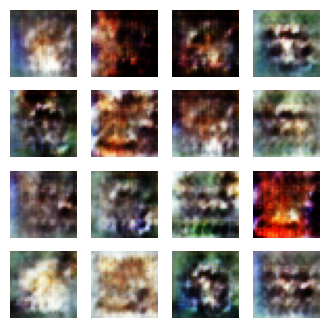

Time for epoch 1041 is 4.156237602233887 sec
Time for epoch 1042 is 3.486346483230591 sec
Time for epoch 1043 is 3.6196112632751465 sec
Time for epoch 1044 is 3.6425092220306396 sec
Time for epoch 1045 is 3.620697021484375 sec
Time for epoch 1046 is 3.624727725982666 sec
Time for epoch 1047 is 3.6202340126037598 sec
Time for epoch 1048 is 3.6295254230499268 sec
Time for epoch 1049 is 3.638622283935547 sec
Time for epoch 1050 is 3.6212284564971924 sec
Time for epoch 1051 is 3.6249122619628906 sec
Time for epoch 1052 is 3.6250336170196533 sec
Time for epoch 1053 is 3.6484551429748535 sec
Time for epoch 1054 is 3.6265478134155273 sec
Time for epoch 1055 is 3.6474008560180664 sec
Time for epoch 1056 is 3.6385996341705322 sec
Time for epoch 1057 is 3.6831862926483154 sec
Time for epoch 1058 is 3.6016602516174316 sec
Time for epoch 1059 is 3.6223678588867188 sec
Time for epoch 1060 is 3.6237735748291016 sec


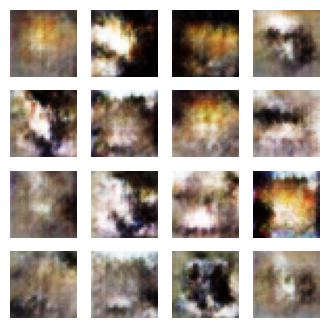

Time for epoch 1061 is 4.155073881149292 sec
Time for epoch 1062 is 3.512721538543701 sec
Time for epoch 1063 is 3.6246726512908936 sec
Time for epoch 1064 is 3.6426098346710205 sec
Time for epoch 1065 is 3.612717628479004 sec
Time for epoch 1066 is 3.63358998298645 sec
Time for epoch 1067 is 3.6259777545928955 sec
Time for epoch 1068 is 3.623422145843506 sec
Time for epoch 1069 is 3.6226298809051514 sec
Time for epoch 1070 is 3.623465061187744 sec
Time for epoch 1071 is 3.6261417865753174 sec
Time for epoch 1072 is 3.6472055912017822 sec
Time for epoch 1073 is 3.6206440925598145 sec
Time for epoch 1074 is 3.639084577560425 sec
Time for epoch 1075 is 3.630103588104248 sec
Time for epoch 1076 is 3.673905611038208 sec
Time for epoch 1077 is 3.608067512512207 sec
Time for epoch 1078 is 3.625168800354004 sec
Time for epoch 1079 is 3.6245360374450684 sec
Time for epoch 1080 is 3.6387064456939697 sec


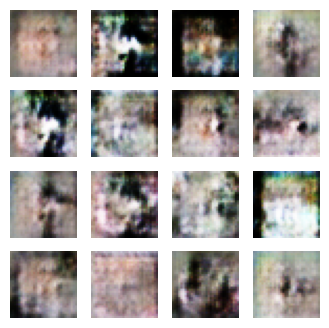

Time for epoch 1081 is 4.169348478317261 sec
Time for epoch 1082 is 3.5003092288970947 sec
Time for epoch 1083 is 3.641406297683716 sec
Time for epoch 1084 is 3.6218881607055664 sec
Time for epoch 1085 is 3.620584726333618 sec
Time for epoch 1086 is 5.102065801620483 sec
Time for epoch 1087 is 3.4910032749176025 sec
Time for epoch 1088 is 3.6371994018554688 sec
Time for epoch 1089 is 3.6262266635894775 sec
Time for epoch 1090 is 3.624016284942627 sec
Time for epoch 1091 is 3.6262645721435547 sec
Time for epoch 1092 is 3.6429343223571777 sec
Time for epoch 1093 is 3.6224446296691895 sec
Time for epoch 1094 is 3.6309127807617188 sec
Time for epoch 1095 is 3.656357765197754 sec
Time for epoch 1096 is 3.6023707389831543 sec
Time for epoch 1097 is 3.6273601055145264 sec
Time for epoch 1098 is 3.623638868331909 sec
Time for epoch 1099 is 3.6490557193756104 sec
Time for epoch 1100 is 3.6490414142608643 sec


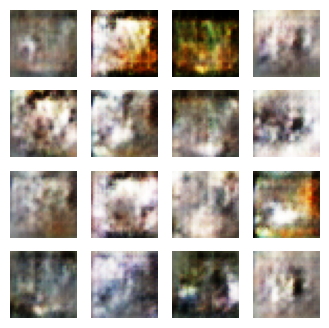

Time for epoch 1101 is 4.177958726882935 sec
Time for epoch 1102 is 3.505016565322876 sec
Time for epoch 1103 is 3.6549887657165527 sec
Time for epoch 1104 is 3.6464812755584717 sec
Time for epoch 1105 is 3.6443798542022705 sec
Time for epoch 1106 is 3.6527280807495117 sec
Time for epoch 1107 is 3.6860339641571045 sec
Time for epoch 1108 is 3.623298406600952 sec
Time for epoch 1109 is 3.657888889312744 sec
Time for epoch 1110 is 3.6629507541656494 sec
Time for epoch 1111 is 3.696962833404541 sec
Time for epoch 1112 is 3.634246349334717 sec
Time for epoch 1113 is 3.662222385406494 sec
Time for epoch 1114 is 3.6645469665527344 sec
Time for epoch 1115 is 3.6587417125701904 sec
Time for epoch 1116 is 3.65779447555542 sec
Time for epoch 1117 is 3.6566855907440186 sec
Time for epoch 1118 is 3.6306862831115723 sec
Time for epoch 1119 is 3.65710186958313 sec
Time for epoch 1120 is 3.639124631881714 sec


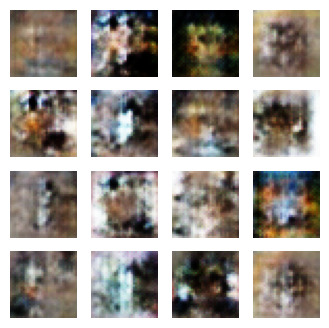

Time for epoch 1121 is 4.317275047302246 sec
Time for epoch 1122 is 3.5065717697143555 sec
Time for epoch 1123 is 3.6271698474884033 sec
Time for epoch 1124 is 3.626682758331299 sec
Time for epoch 1125 is 3.62603497505188 sec
Time for epoch 1126 is 3.6287994384765625 sec
Time for epoch 1127 is 3.6258575916290283 sec
Time for epoch 1128 is 3.643611192703247 sec
Time for epoch 1129 is 3.6444995403289795 sec
Time for epoch 1130 is 3.6854610443115234 sec
Time for epoch 1131 is 3.618706703186035 sec
Time for epoch 1132 is 3.640089511871338 sec
Time for epoch 1133 is 3.645390510559082 sec
Time for epoch 1134 is 3.6473655700683594 sec
Time for epoch 1135 is 3.6367721557617188 sec
Time for epoch 1136 is 3.6417958736419678 sec
Time for epoch 1137 is 3.6473429203033447 sec
Time for epoch 1138 is 3.641834259033203 sec
Time for epoch 1139 is 3.6419243812561035 sec
Time for epoch 1140 is 3.6457605361938477 sec


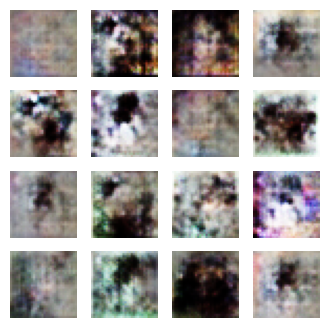

Time for epoch 1141 is 4.374862194061279 sec
Time for epoch 1142 is 3.5024125576019287 sec
Time for epoch 1143 is 3.6359047889709473 sec
Time for epoch 1144 is 3.6361701488494873 sec
Time for epoch 1145 is 3.61875319480896 sec
Time for epoch 1146 is 3.6285877227783203 sec
Time for epoch 1147 is 3.641648530960083 sec
Time for epoch 1148 is 3.657186508178711 sec
Time for epoch 1149 is 3.6086597442626953 sec
Time for epoch 1150 is 3.635315418243408 sec
Time for epoch 1151 is 3.6482245922088623 sec
Time for epoch 1152 is 3.634164571762085 sec
Time for epoch 1153 is 3.6401689052581787 sec
Time for epoch 1154 is 3.6215291023254395 sec
Time for epoch 1155 is 3.6415371894836426 sec
Time for epoch 1156 is 3.642516851425171 sec
Time for epoch 1157 is 3.6450634002685547 sec
Time for epoch 1158 is 3.6439356803894043 sec
Time for epoch 1159 is 3.6768627166748047 sec
Time for epoch 1160 is 3.609065055847168 sec


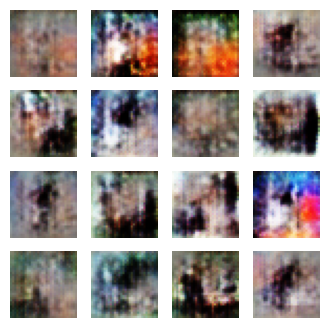

Time for epoch 1161 is 4.163219928741455 sec
Time for epoch 1162 is 3.5133118629455566 sec
Time for epoch 1163 is 3.633796453475952 sec
Time for epoch 1164 is 3.620309591293335 sec
Time for epoch 1165 is 3.6449379920959473 sec
Time for epoch 1166 is 3.6402413845062256 sec
Time for epoch 1167 is 3.6449897289276123 sec
Time for epoch 1168 is 3.6392271518707275 sec
Time for epoch 1169 is 3.6419572830200195 sec
Time for epoch 1170 is 3.639279365539551 sec
Time for epoch 1171 is 3.65165638923645 sec
Time for epoch 1172 is 3.618089437484741 sec
Time for epoch 1173 is 3.6326446533203125 sec
Time for epoch 1174 is 3.6684234142303467 sec
Time for epoch 1175 is 3.596269369125366 sec
Time for epoch 1176 is 3.6376595497131348 sec
Time for epoch 1177 is 3.626847743988037 sec
Time for epoch 1178 is 3.6429901123046875 sec
Time for epoch 1179 is 3.623687505722046 sec
Time for epoch 1180 is 3.623826265335083 sec


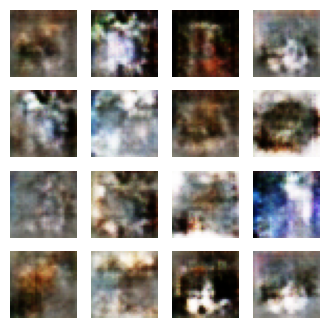

Time for epoch 1181 is 4.2998316287994385 sec
Time for epoch 1182 is 3.497070550918579 sec
Time for epoch 1183 is 3.6262006759643555 sec
Time for epoch 1184 is 3.621392011642456 sec
Time for epoch 1185 is 3.6262059211730957 sec
Time for epoch 1186 is 3.620154857635498 sec
Time for epoch 1187 is 3.621964693069458 sec
Time for epoch 1188 is 3.6241366863250732 sec
Time for epoch 1189 is 3.6241860389709473 sec
Time for epoch 1190 is 3.6231417655944824 sec
Time for epoch 1191 is 3.6225247383117676 sec
Time for epoch 1192 is 3.626279354095459 sec
Time for epoch 1193 is 3.6368539333343506 sec
Time for epoch 1194 is 3.643744468688965 sec
Time for epoch 1195 is 3.622450590133667 sec
Time for epoch 1196 is 3.6436359882354736 sec
Time for epoch 1197 is 3.6236166954040527 sec
Time for epoch 1198 is 3.6250500679016113 sec
Time for epoch 1199 is 3.6283628940582275 sec
Time for epoch 1200 is 3.627107858657837 sec


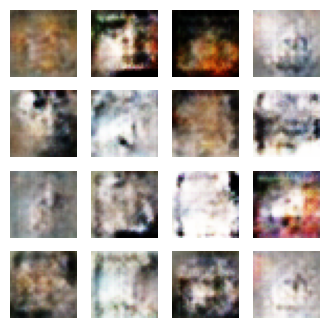

Time for epoch 1201 is 4.413398504257202 sec
Time for epoch 1202 is 3.496250867843628 sec
Time for epoch 1203 is 3.6278862953186035 sec
Time for epoch 1204 is 3.619084119796753 sec
Time for epoch 1205 is 3.6202945709228516 sec
Time for epoch 1206 is 3.6242339611053467 sec
Time for epoch 1207 is 3.622654914855957 sec
Time for epoch 1208 is 3.6326372623443604 sec
Time for epoch 1209 is 3.6296775341033936 sec
Time for epoch 1210 is 3.6221461296081543 sec
Time for epoch 1211 is 3.678189754486084 sec
Time for epoch 1212 is 3.612177848815918 sec
Time for epoch 1213 is 3.6222360134124756 sec
Time for epoch 1214 is 3.6225364208221436 sec
Time for epoch 1215 is 3.64471697807312 sec
Time for epoch 1216 is 3.6240882873535156 sec
Time for epoch 1217 is 3.6288745403289795 sec
Time for epoch 1218 is 3.6246254444122314 sec
Time for epoch 1219 is 3.6244747638702393 sec
Time for epoch 1220 is 3.6279807090759277 sec


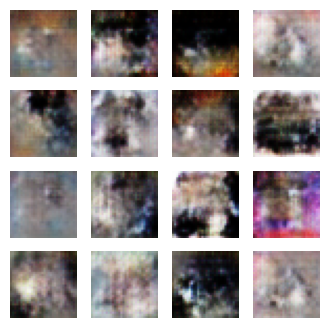

Time for epoch 1221 is 4.175768613815308 sec
Time for epoch 1222 is 3.505455255508423 sec
Time for epoch 1223 is 3.6215734481811523 sec
Time for epoch 1224 is 3.633183240890503 sec
Time for epoch 1225 is 3.633528709411621 sec
Time for epoch 1226 is 3.6451079845428467 sec
Time for epoch 1227 is 3.6183557510375977 sec
Time for epoch 1228 is 3.6440508365631104 sec
Time for epoch 1229 is 3.6791653633117676 sec
Time for epoch 1230 is 3.604853391647339 sec
Time for epoch 1231 is 3.6528170108795166 sec
Time for epoch 1232 is 3.6373841762542725 sec
Time for epoch 1233 is 3.6415257453918457 sec
Time for epoch 1234 is 3.6415905952453613 sec
Time for epoch 1235 is 3.648029327392578 sec
Time for epoch 1236 is 3.6254894733428955 sec
Time for epoch 1237 is 3.6624786853790283 sec
Time for epoch 1238 is 3.5928473472595215 sec
Time for epoch 1239 is 3.6441712379455566 sec
Time for epoch 1240 is 3.6281166076660156 sec


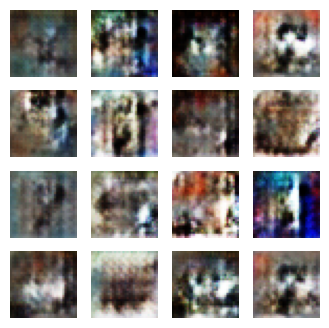

Time for epoch 1241 is 4.205564737319946 sec
Time for epoch 1242 is 3.4753928184509277 sec
Time for epoch 1243 is 3.6399035453796387 sec
Time for epoch 1244 is 3.6274824142456055 sec
Time for epoch 1245 is 3.6374945640563965 sec
Time for epoch 1246 is 3.6131303310394287 sec
Time for epoch 1247 is 3.6432993412017822 sec
Time for epoch 1248 is 3.642866611480713 sec
Time for epoch 1249 is 3.6470563411712646 sec
Time for epoch 1250 is 5.101594924926758 sec
Time for epoch 1251 is 3.4988138675689697 sec
Time for epoch 1252 is 3.6256773471832275 sec
Time for epoch 1253 is 3.625861644744873 sec
Time for epoch 1254 is 3.624345302581787 sec
Time for epoch 1255 is 3.630476474761963 sec
Time for epoch 1256 is 3.622793197631836 sec
Time for epoch 1257 is 3.643235206604004 sec
Time for epoch 1258 is 3.6450321674346924 sec
Time for epoch 1259 is 3.647975206375122 sec
Time for epoch 1260 is 3.6520144939422607 sec


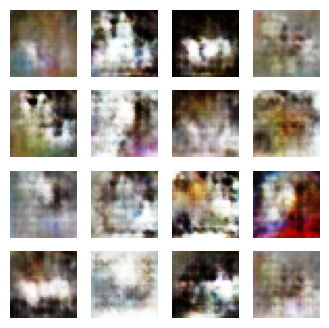

Time for epoch 1261 is 4.197101831436157 sec
Time for epoch 1262 is 3.4962539672851562 sec
Time for epoch 1263 is 3.644765853881836 sec
Time for epoch 1264 is 3.6414246559143066 sec
Time for epoch 1265 is 3.648573875427246 sec
Time for epoch 1266 is 3.6469569206237793 sec
Time for epoch 1267 is 3.648482084274292 sec
Time for epoch 1268 is 3.6446542739868164 sec
Time for epoch 1269 is 3.6479477882385254 sec
Time for epoch 1270 is 3.6763317584991455 sec
Time for epoch 1271 is 3.60978364944458 sec
Time for epoch 1272 is 3.6350977420806885 sec
Time for epoch 1273 is 3.6451408863067627 sec
Time for epoch 1274 is 3.639045000076294 sec
Time for epoch 1275 is 3.641439914703369 sec
Time for epoch 1276 is 3.653914213180542 sec
Time for epoch 1277 is 3.679947853088379 sec
Time for epoch 1278 is 3.6091885566711426 sec
Time for epoch 1279 is 3.6419901847839355 sec
Time for epoch 1280 is 3.642821788787842 sec


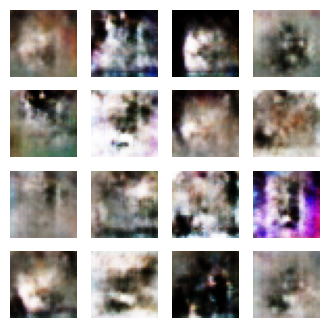

Time for epoch 1281 is 4.550253868103027 sec
Time for epoch 1282 is 3.500903606414795 sec
Time for epoch 1283 is 3.638795852661133 sec
Time for epoch 1284 is 3.6320314407348633 sec
Time for epoch 1285 is 3.640955686569214 sec
Time for epoch 1286 is 3.6439592838287354 sec
Time for epoch 1287 is 3.6228318214416504 sec
Time for epoch 1288 is 3.663389205932617 sec
Time for epoch 1289 is 3.60658597946167 sec
Time for epoch 1290 is 3.6259541511535645 sec
Time for epoch 1291 is 3.6438138484954834 sec
Time for epoch 1292 is 3.6420865058898926 sec
Time for epoch 1293 is 3.650925636291504 sec
Time for epoch 1294 is 3.642514228820801 sec
Time for epoch 1295 is 3.668503761291504 sec
Time for epoch 1296 is 3.620450258255005 sec
Time for epoch 1297 is 3.6446192264556885 sec
Time for epoch 1298 is 3.644519329071045 sec
Time for epoch 1299 is 3.6472103595733643 sec
Time for epoch 1300 is 3.639094114303589 sec


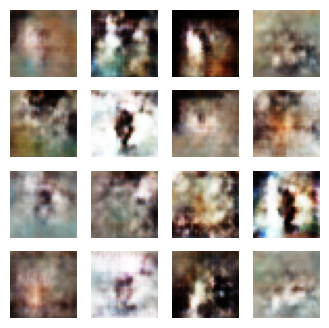

Time for epoch 1301 is 4.175312757492065 sec
Time for epoch 1302 is 3.513881206512451 sec
Time for epoch 1303 is 5.102710247039795 sec
Time for epoch 1304 is 3.485914468765259 sec
Time for epoch 1305 is 3.6216039657592773 sec
Time for epoch 1306 is 3.6585593223571777 sec
Time for epoch 1307 is 3.5895211696624756 sec
Time for epoch 1308 is 3.6299333572387695 sec
Time for epoch 1309 is 3.626605987548828 sec
Time for epoch 1310 is 3.64794659614563 sec
Time for epoch 1311 is 3.644132375717163 sec
Time for epoch 1312 is 3.64758563041687 sec
Time for epoch 1313 is 3.663154363632202 sec
Time for epoch 1314 is 3.6469764709472656 sec
Time for epoch 1315 is 3.666576862335205 sec
Time for epoch 1316 is 3.6613762378692627 sec
Time for epoch 1317 is 3.669071674346924 sec
Time for epoch 1318 is 3.651793956756592 sec
Time for epoch 1319 is 3.6568055152893066 sec
Time for epoch 1320 is 3.6594932079315186 sec


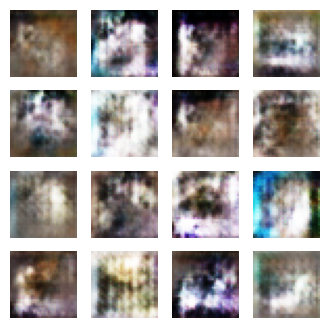

Time for epoch 1321 is 5.492560625076294 sec
Time for epoch 1322 is 3.503763198852539 sec
Time for epoch 1323 is 3.6212992668151855 sec
Time for epoch 1324 is 3.6255242824554443 sec
Time for epoch 1325 is 3.625044822692871 sec
Time for epoch 1326 is 3.6450538635253906 sec
Time for epoch 1327 is 3.625109910964966 sec
Time for epoch 1328 is 3.6536548137664795 sec
Time for epoch 1329 is 3.6392135620117188 sec
Time for epoch 1330 is 3.646315813064575 sec
Time for epoch 1331 is 3.646087408065796 sec
Time for epoch 1332 is 3.652867555618286 sec
Time for epoch 1333 is 3.656385660171509 sec
Time for epoch 1334 is 3.6594443321228027 sec
Time for epoch 1335 is 3.660550355911255 sec
Time for epoch 1336 is 3.6603689193725586 sec
Time for epoch 1337 is 3.654845714569092 sec
Time for epoch 1338 is 3.6735541820526123 sec
Time for epoch 1339 is 3.675050735473633 sec
Time for epoch 1340 is 3.6181321144104004 sec


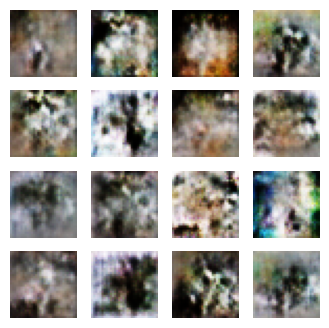

Time for epoch 1341 is 4.144964694976807 sec
Time for epoch 1342 is 3.5306942462921143 sec
Time for epoch 1343 is 3.627302408218384 sec
Time for epoch 1344 is 3.6054747104644775 sec
Time for epoch 1345 is 3.6256155967712402 sec
Time for epoch 1346 is 3.630688190460205 sec
Time for epoch 1347 is 3.621763229370117 sec
Time for epoch 1348 is 3.6251907348632812 sec
Time for epoch 1349 is 3.6225602626800537 sec
Time for epoch 1350 is 3.6191458702087402 sec
Time for epoch 1351 is 3.619382381439209 sec
Time for epoch 1352 is 3.6203012466430664 sec
Time for epoch 1353 is 3.62363862991333 sec
Time for epoch 1354 is 3.61850905418396 sec
Time for epoch 1355 is 3.621037244796753 sec
Time for epoch 1356 is 3.6179137229919434 sec
Time for epoch 1357 is 3.625784397125244 sec
Time for epoch 1358 is 3.619293212890625 sec
Time for epoch 1359 is 3.621426582336426 sec
Time for epoch 1360 is 3.6198043823242188 sec


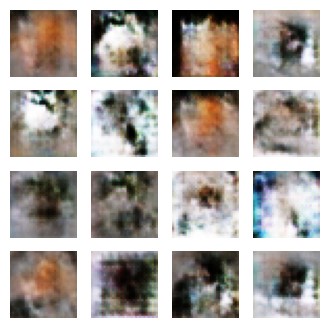

Time for epoch 1361 is 4.321436405181885 sec
Time for epoch 1362 is 3.4858126640319824 sec
Time for epoch 1363 is 3.6272337436676025 sec
Time for epoch 1364 is 3.6246960163116455 sec
Time for epoch 1365 is 3.619401693344116 sec
Time for epoch 1366 is 3.6279308795928955 sec
Time for epoch 1367 is 3.619722843170166 sec
Time for epoch 1368 is 3.6261305809020996 sec
Time for epoch 1369 is 3.619685649871826 sec
Time for epoch 1370 is 3.6205201148986816 sec
Time for epoch 1371 is 3.6217424869537354 sec
Time for epoch 1372 is 3.626297950744629 sec
Time for epoch 1373 is 3.619277238845825 sec
Time for epoch 1374 is 3.6213343143463135 sec
Time for epoch 1375 is 3.6216845512390137 sec
Time for epoch 1376 is 3.6279659271240234 sec
Time for epoch 1377 is 3.6189873218536377 sec
Time for epoch 1378 is 3.6212711334228516 sec
Time for epoch 1379 is 3.6246161460876465 sec
Time for epoch 1380 is 3.621412515640259 sec


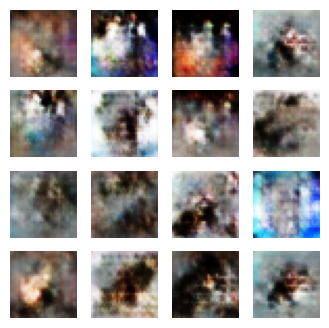

Time for epoch 1381 is 4.447890281677246 sec
Time for epoch 1382 is 3.499793529510498 sec
Time for epoch 1383 is 3.6366333961486816 sec
Time for epoch 1384 is 3.6249518394470215 sec
Time for epoch 1385 is 3.621699571609497 sec
Time for epoch 1386 is 3.6451637744903564 sec
Time for epoch 1387 is 3.646242141723633 sec
Time for epoch 1388 is 3.6365041732788086 sec
Time for epoch 1389 is 3.641608953475952 sec
Time for epoch 1390 is 3.6662285327911377 sec
Time for epoch 1391 is 3.597665548324585 sec
Time for epoch 1392 is 3.619539260864258 sec
Time for epoch 1393 is 3.6442787647247314 sec
Time for epoch 1394 is 3.6453371047973633 sec
Time for epoch 1395 is 3.644082546234131 sec
Time for epoch 1396 is 3.652047872543335 sec
Time for epoch 1397 is 3.613861322402954 sec
Time for epoch 1398 is 3.677185535430908 sec
Time for epoch 1399 is 3.5965144634246826 sec
Time for epoch 1400 is 3.6245062351226807 sec


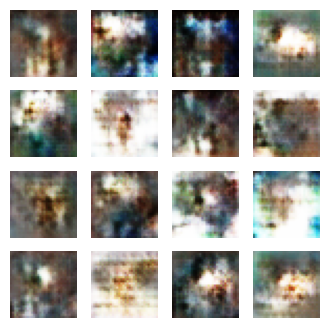

Time for epoch 1401 is 4.3351686000823975 sec
Time for epoch 1402 is 3.4997165203094482 sec
Time for epoch 1403 is 3.6257572174072266 sec
Time for epoch 1404 is 3.6328585147857666 sec
Time for epoch 1405 is 3.655109167098999 sec
Time for epoch 1406 is 3.6315195560455322 sec
Time for epoch 1407 is 3.642840623855591 sec
Time for epoch 1408 is 3.6388912200927734 sec
Time for epoch 1409 is 3.677879810333252 sec
Time for epoch 1410 is 3.593449831008911 sec
Time for epoch 1411 is 3.648773670196533 sec
Time for epoch 1412 is 3.6545822620391846 sec
Time for epoch 1413 is 3.644320249557495 sec
Time for epoch 1414 is 3.657893180847168 sec
Time for epoch 1415 is 3.6474249362945557 sec
Time for epoch 1416 is 3.665806531906128 sec
Time for epoch 1417 is 3.660705089569092 sec
Time for epoch 1418 is 3.6461522579193115 sec
Time for epoch 1419 is 3.6475844383239746 sec
Time for epoch 1420 is 3.647976875305176 sec


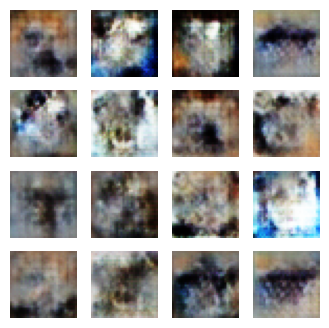

Time for epoch 1421 is 4.172292709350586 sec
Time for epoch 1422 is 3.5038235187530518 sec
Time for epoch 1423 is 3.651118755340576 sec
Time for epoch 1424 is 3.6472370624542236 sec
Time for epoch 1425 is 3.6285226345062256 sec
Time for epoch 1426 is 3.6506969928741455 sec
Time for epoch 1427 is 3.64958119392395 sec
Time for epoch 1428 is 3.642845869064331 sec
Time for epoch 1429 is 3.642308473587036 sec
Time for epoch 1430 is 3.645359516143799 sec
Time for epoch 1431 is 3.642045259475708 sec
Time for epoch 1432 is 3.644726037979126 sec
Time for epoch 1433 is 3.6341984272003174 sec
Time for epoch 1434 is 3.6501989364624023 sec
Time for epoch 1435 is 3.680375814437866 sec
Time for epoch 1436 is 3.5704174041748047 sec
Time for epoch 1437 is 3.628225326538086 sec
Time for epoch 1438 is 3.64829683303833 sec
Time for epoch 1439 is 3.639369010925293 sec
Time for epoch 1440 is 3.64082932472229 sec


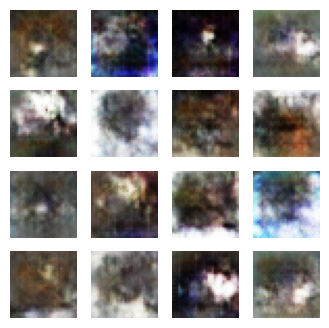

Time for epoch 1441 is 4.175605297088623 sec
Time for epoch 1442 is 3.536473274230957 sec
Time for epoch 1443 is 3.5991408824920654 sec
Time for epoch 1444 is 3.639845609664917 sec
Time for epoch 1445 is 3.6368393898010254 sec
Time for epoch 1446 is 3.645914316177368 sec
Time for epoch 1447 is 3.6367695331573486 sec
Time for epoch 1448 is 3.625375509262085 sec
Time for epoch 1449 is 3.6414132118225098 sec
Time for epoch 1450 is 3.6416077613830566 sec
Time for epoch 1451 is 3.6212704181671143 sec
Time for epoch 1452 is 3.6410303115844727 sec
Time for epoch 1453 is 3.640742540359497 sec
Time for epoch 1454 is 3.6465911865234375 sec
Time for epoch 1455 is 3.6510324478149414 sec
Time for epoch 1456 is 3.6042661666870117 sec
Time for epoch 1457 is 3.6307785511016846 sec
Time for epoch 1458 is 3.6233315467834473 sec
Time for epoch 1459 is 3.640594482421875 sec
Time for epoch 1460 is 3.6460139751434326 sec


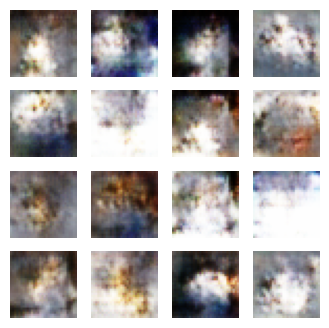

Time for epoch 1461 is 4.138505220413208 sec
Time for epoch 1462 is 3.4910194873809814 sec
Time for epoch 1463 is 3.6433348655700684 sec
Time for epoch 1464 is 3.6291351318359375 sec
Time for epoch 1465 is 3.637082576751709 sec
Time for epoch 1466 is 3.6232476234436035 sec
Time for epoch 1467 is 3.6431169509887695 sec
Time for epoch 1468 is 3.6278305053710938 sec
Time for epoch 1469 is 3.6366634368896484 sec
Time for epoch 1470 is 3.6294519901275635 sec
Time for epoch 1471 is 3.643051862716675 sec
Time for epoch 1472 is 3.661677837371826 sec
Time for epoch 1473 is 3.609386920928955 sec
Time for epoch 1474 is 3.623302698135376 sec
Time for epoch 1475 is 3.646300792694092 sec
Time for epoch 1476 is 3.6405622959136963 sec
Time for epoch 1477 is 3.6285436153411865 sec
Time for epoch 1478 is 3.6403257846832275 sec
Time for epoch 1479 is 3.649742364883423 sec
Time for epoch 1480 is 3.651892900466919 sec


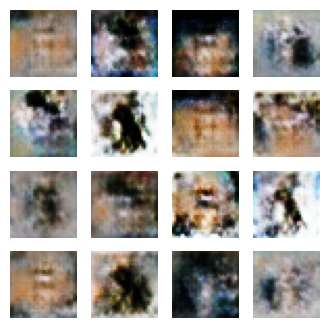

Time for epoch 1481 is 4.287789821624756 sec
Time for epoch 1482 is 3.5030083656311035 sec
Time for epoch 1483 is 3.627906560897827 sec
Time for epoch 1484 is 3.620159149169922 sec
Time for epoch 1485 is 3.6317951679229736 sec
Time for epoch 1486 is 3.684244394302368 sec
Time for epoch 1487 is 3.5981643199920654 sec
Time for epoch 1488 is 3.639683961868286 sec
Time for epoch 1489 is 3.662703275680542 sec
Time for epoch 1490 is 3.6149826049804688 sec
Time for epoch 1491 is 3.642263174057007 sec
Time for epoch 1492 is 3.626390218734741 sec
Time for epoch 1493 is 3.6268200874328613 sec
Time for epoch 1494 is 3.6354196071624756 sec
Time for epoch 1495 is 3.619523048400879 sec
Time for epoch 1496 is 3.6456961631774902 sec
Time for epoch 1497 is 3.6451237201690674 sec
Time for epoch 1498 is 3.638263702392578 sec
Time for epoch 1499 is 3.6400604248046875 sec
Time for epoch 1500 is 3.6271743774414062 sec


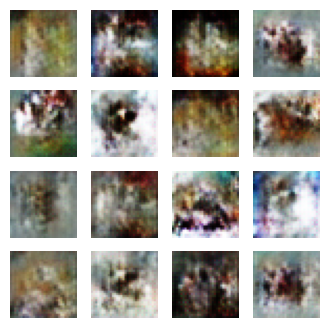

Time for epoch 1501 is 4.339954376220703 sec
Time for epoch 1502 is 3.5193042755126953 sec
Time for epoch 1503 is 3.630781412124634 sec
Time for epoch 1504 is 3.623422384262085 sec
Time for epoch 1505 is 3.6449029445648193 sec
Time for epoch 1506 is 3.6367857456207275 sec
Time for epoch 1507 is 3.641329050064087 sec
Time for epoch 1508 is 3.640737533569336 sec
Time for epoch 1509 is 3.6377432346343994 sec
Time for epoch 1510 is 3.62516713142395 sec
Time for epoch 1511 is 3.640923261642456 sec
Time for epoch 1512 is 3.636389970779419 sec
Time for epoch 1513 is 3.642089366912842 sec
Time for epoch 1514 is 3.6246540546417236 sec
Time for epoch 1515 is 3.642202138900757 sec
Time for epoch 1516 is 3.673948287963867 sec
Time for epoch 1517 is 3.6117653846740723 sec
Time for epoch 1518 is 3.649212121963501 sec
Time for epoch 1519 is 3.648003101348877 sec
Time for epoch 1520 is 3.644343614578247 sec


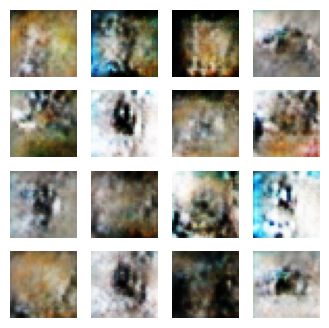

Time for epoch 1521 is 4.161970376968384 sec
Time for epoch 1522 is 3.501119375228882 sec
Time for epoch 1523 is 3.626455783843994 sec
Time for epoch 1524 is 3.6366755962371826 sec
Time for epoch 1525 is 3.6444268226623535 sec
Time for epoch 1526 is 3.6442198753356934 sec
Time for epoch 1527 is 3.6455986499786377 sec
Time for epoch 1528 is 3.6452362537384033 sec
Time for epoch 1529 is 3.6264004707336426 sec
Time for epoch 1530 is 3.62817120552063 sec
Time for epoch 1531 is 3.651395559310913 sec
Time for epoch 1532 is 3.6465115547180176 sec
Time for epoch 1533 is 3.6451849937438965 sec
Time for epoch 1534 is 3.643367052078247 sec
Time for epoch 1535 is 3.642538070678711 sec
Time for epoch 1536 is 3.6420600414276123 sec
Time for epoch 1537 is 3.641658067703247 sec
Time for epoch 1538 is 3.648050308227539 sec
Time for epoch 1539 is 3.655358076095581 sec
Time for epoch 1540 is 3.6436665058135986 sec


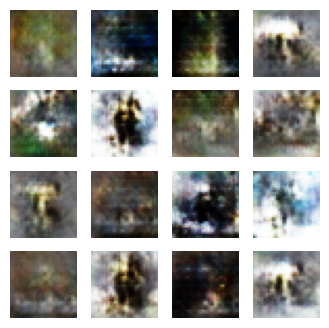

Time for epoch 1541 is 4.18353533744812 sec
Time for epoch 1542 is 3.5045604705810547 sec
Time for epoch 1543 is 3.6303772926330566 sec
Time for epoch 1544 is 3.642301559448242 sec
Time for epoch 1545 is 3.6770474910736084 sec
Time for epoch 1546 is 3.610847234725952 sec
Time for epoch 1547 is 3.624690055847168 sec
Time for epoch 1548 is 3.635685920715332 sec
Time for epoch 1549 is 3.6575229167938232 sec
Time for epoch 1550 is 3.6445720195770264 sec
Time for epoch 1551 is 3.6394097805023193 sec
Time for epoch 1552 is 3.6526877880096436 sec
Time for epoch 1553 is 3.6469013690948486 sec
Time for epoch 1554 is 3.6386735439300537 sec
Time for epoch 1555 is 3.64585280418396 sec
Time for epoch 1556 is 3.6376843452453613 sec
Time for epoch 1557 is 3.653367519378662 sec
Time for epoch 1558 is 3.634082794189453 sec
Time for epoch 1559 is 3.6524229049682617 sec
Time for epoch 1560 is 3.6525638103485107 sec


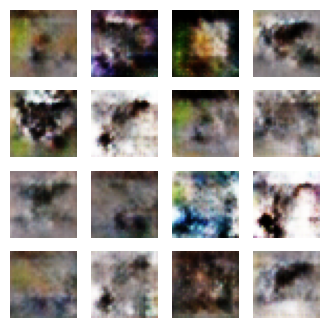

Time for epoch 1561 is 4.472645282745361 sec
Time for epoch 1562 is 3.485015630722046 sec
Time for epoch 1563 is 3.621487855911255 sec
Time for epoch 1564 is 3.6262173652648926 sec
Time for epoch 1565 is 3.6225037574768066 sec
Time for epoch 1566 is 3.6458866596221924 sec
Time for epoch 1567 is 3.627990245819092 sec
Time for epoch 1568 is 3.6247026920318604 sec
Time for epoch 1569 is 3.631107807159424 sec
Time for epoch 1570 is 3.63755202293396 sec
Time for epoch 1571 is 3.6388444900512695 sec
Time for epoch 1572 is 3.6278772354125977 sec
Time for epoch 1573 is 3.6347758769989014 sec
Time for epoch 1574 is 3.630396604537964 sec
Time for epoch 1575 is 3.6251819133758545 sec
Time for epoch 1576 is 3.6329948902130127 sec
Time for epoch 1577 is 3.628615379333496 sec
Time for epoch 1578 is 3.635981321334839 sec
Time for epoch 1579 is 3.6347010135650635 sec
Time for epoch 1580 is 3.641674280166626 sec


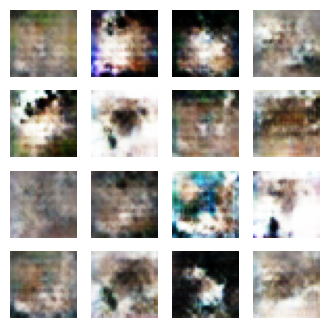

Time for epoch 1581 is 4.166086435317993 sec
Time for epoch 1582 is 3.514172077178955 sec
Time for epoch 1583 is 3.630422830581665 sec
Time for epoch 1584 is 3.6243669986724854 sec
Time for epoch 1585 is 3.624323844909668 sec
Time for epoch 1586 is 3.591853380203247 sec
Time for epoch 1587 is 3.6380040645599365 sec
Time for epoch 1588 is 3.6403074264526367 sec
Time for epoch 1589 is 3.6473593711853027 sec
Time for epoch 1590 is 3.6489460468292236 sec
Time for epoch 1591 is 3.6310360431671143 sec
Time for epoch 1592 is 3.6506118774414062 sec
Time for epoch 1593 is 3.64754319190979 sec
Time for epoch 1594 is 3.6461966037750244 sec
Time for epoch 1595 is 3.655318260192871 sec
Time for epoch 1596 is 3.6468305587768555 sec
Time for epoch 1597 is 3.6445887088775635 sec
Time for epoch 1598 is 3.6449575424194336 sec
Time for epoch 1599 is 3.6560428142547607 sec
Time for epoch 1600 is 3.651081085205078 sec


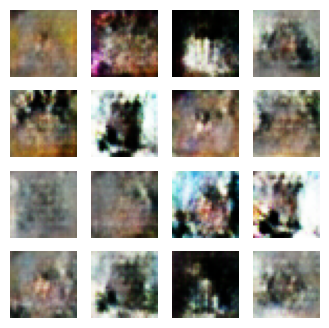

Time for epoch 1601 is 4.3333141803741455 sec
Time for epoch 1602 is 3.514829397201538 sec
Time for epoch 1603 is 3.6275699138641357 sec
Time for epoch 1604 is 3.6414177417755127 sec
Time for epoch 1605 is 3.6522653102874756 sec
Time for epoch 1606 is 3.6489319801330566 sec
Time for epoch 1607 is 3.652949333190918 sec
Time for epoch 1608 is 3.6614601612091064 sec
Time for epoch 1609 is 3.659336805343628 sec
Time for epoch 1610 is 3.6594812870025635 sec
Time for epoch 1611 is 3.6573238372802734 sec
Time for epoch 1612 is 3.6616339683532715 sec
Time for epoch 1613 is 3.645010232925415 sec
Time for epoch 1614 is 3.6433722972869873 sec
Time for epoch 1615 is 3.6457629203796387 sec
Time for epoch 1616 is 3.6339166164398193 sec
Time for epoch 1617 is 3.637580394744873 sec
Time for epoch 1618 is 3.637369155883789 sec
Time for epoch 1619 is 3.644869565963745 sec
Time for epoch 1620 is 3.640948534011841 sec


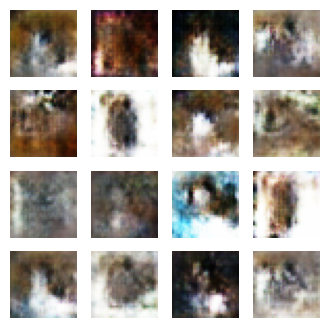

Time for epoch 1621 is 4.143064498901367 sec
Time for epoch 1622 is 3.5412259101867676 sec
Time for epoch 1623 is 3.598170042037964 sec
Time for epoch 1624 is 3.60827898979187 sec
Time for epoch 1625 is 3.618683338165283 sec
Time for epoch 1626 is 3.630110740661621 sec
Time for epoch 1627 is 3.6165552139282227 sec
Time for epoch 1628 is 3.6218101978302 sec
Time for epoch 1629 is 3.623300552368164 sec
Time for epoch 1630 is 3.6215741634368896 sec
Time for epoch 1631 is 3.586642265319824 sec
Time for epoch 1632 is 3.6237194538116455 sec
Time for epoch 1633 is 3.6236424446105957 sec
Time for epoch 1634 is 3.621551990509033 sec
Time for epoch 1635 is 3.638559103012085 sec
Time for epoch 1636 is 3.6322100162506104 sec
Time for epoch 1637 is 3.631035327911377 sec
Time for epoch 1638 is 3.6273391246795654 sec
Time for epoch 1639 is 3.6233389377593994 sec
Time for epoch 1640 is 3.6269125938415527 sec


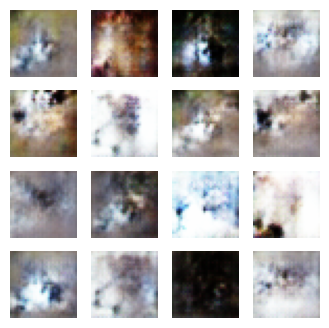

Time for epoch 1641 is 4.7013843059539795 sec
Time for epoch 1642 is 3.4945812225341797 sec
Time for epoch 1643 is 3.623394250869751 sec
Time for epoch 1644 is 3.6205875873565674 sec
Time for epoch 1645 is 3.6216518878936768 sec
Time for epoch 1646 is 3.6188406944274902 sec
Time for epoch 1647 is 3.622131824493408 sec
Time for epoch 1648 is 3.621527671813965 sec
Time for epoch 1649 is 3.6543424129486084 sec
Time for epoch 1650 is 3.588151216506958 sec
Time for epoch 1651 is 3.6224470138549805 sec
Time for epoch 1652 is 3.6238715648651123 sec
Time for epoch 1653 is 3.650691509246826 sec
Time for epoch 1654 is 3.5905158519744873 sec
Time for epoch 1655 is 3.6198644638061523 sec
Time for epoch 1656 is 3.6264045238494873 sec
Time for epoch 1657 is 3.622509002685547 sec
Time for epoch 1658 is 3.6239376068115234 sec
Time for epoch 1659 is 3.6255223751068115 sec
Time for epoch 1660 is 3.6257386207580566 sec


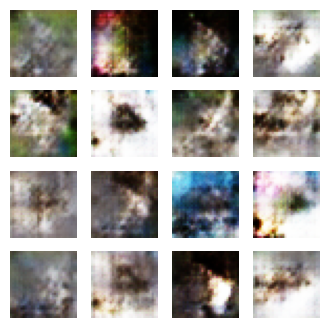

Time for epoch 1661 is 4.152036428451538 sec
Time for epoch 1662 is 3.4932069778442383 sec
Time for epoch 1663 is 3.654122829437256 sec
Time for epoch 1664 is 3.5868287086486816 sec
Time for epoch 1665 is 3.622620105743408 sec
Time for epoch 1666 is 3.6215083599090576 sec
Time for epoch 1667 is 3.6252059936523438 sec
Time for epoch 1668 is 3.6199324131011963 sec
Time for epoch 1669 is 3.625455617904663 sec
Time for epoch 1670 is 3.622586250305176 sec
Time for epoch 1671 is 3.6234254837036133 sec
Time for epoch 1672 is 3.6229186058044434 sec
Time for epoch 1673 is 3.6406424045562744 sec
Time for epoch 1674 is 3.643209457397461 sec
Time for epoch 1675 is 3.6216211318969727 sec
Time for epoch 1676 is 3.62630558013916 sec
Time for epoch 1677 is 3.6277568340301514 sec
Time for epoch 1678 is 3.6405184268951416 sec
Time for epoch 1679 is 3.6553022861480713 sec
Time for epoch 1680 is 3.6423099040985107 sec


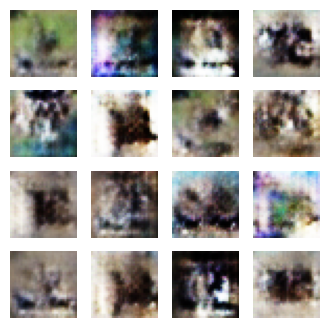

Time for epoch 1681 is 4.164327621459961 sec
Time for epoch 1682 is 3.5018815994262695 sec
Time for epoch 1683 is 3.648081064224243 sec
Time for epoch 1684 is 3.668642044067383 sec
Time for epoch 1685 is 3.6370091438293457 sec
Time for epoch 1686 is 3.6320059299468994 sec
Time for epoch 1687 is 3.6233224868774414 sec
Time for epoch 1688 is 3.6431431770324707 sec
Time for epoch 1689 is 3.6780214309692383 sec
Time for epoch 1690 is 3.592512369155884 sec
Time for epoch 1691 is 3.655982732772827 sec
Time for epoch 1692 is 3.680989980697632 sec
Time for epoch 1693 is 3.6134495735168457 sec
Time for epoch 1694 is 3.6469051837921143 sec
Time for epoch 1695 is 3.6517841815948486 sec
Time for epoch 1696 is 3.6567835807800293 sec
Time for epoch 1697 is 3.687209367752075 sec
Time for epoch 1698 is 3.6195991039276123 sec
Time for epoch 1699 is 3.6561453342437744 sec
Time for epoch 1700 is 3.658339738845825 sec


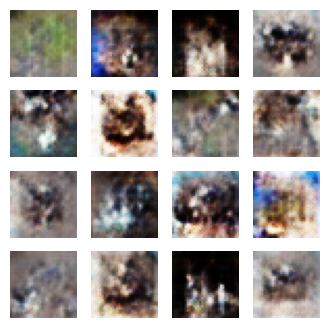

Time for epoch 1701 is 4.1926023960113525 sec
Time for epoch 1702 is 3.5217416286468506 sec
Time for epoch 1703 is 3.654454469680786 sec
Time for epoch 1704 is 3.664416551589966 sec
Time for epoch 1705 is 3.6078901290893555 sec
Time for epoch 1706 is 3.6419358253479004 sec
Time for epoch 1707 is 3.644202709197998 sec
Time for epoch 1708 is 3.6442041397094727 sec
Time for epoch 1709 is 3.6399035453796387 sec
Time for epoch 1710 is 3.640662670135498 sec
Time for epoch 1711 is 3.6266512870788574 sec
Time for epoch 1712 is 3.628671407699585 sec
Time for epoch 1713 is 3.6417880058288574 sec
Time for epoch 1714 is 3.6246488094329834 sec
Time for epoch 1715 is 3.6436498165130615 sec
Time for epoch 1716 is 3.6350255012512207 sec
Time for epoch 1717 is 3.668853521347046 sec
Time for epoch 1718 is 3.615565538406372 sec
Time for epoch 1719 is 3.674191474914551 sec
Time for epoch 1720 is 3.599935293197632 sec


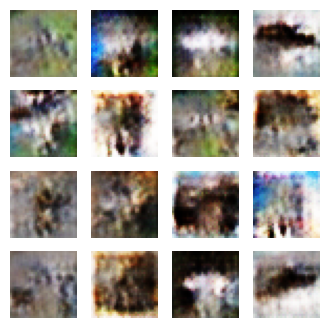

Time for epoch 1721 is 4.170568466186523 sec
Time for epoch 1722 is 3.515727996826172 sec
Time for epoch 1723 is 3.642104387283325 sec
Time for epoch 1724 is 3.6333210468292236 sec
Time for epoch 1725 is 3.621926784515381 sec
Time for epoch 1726 is 3.6311702728271484 sec
Time for epoch 1727 is 3.635970115661621 sec
Time for epoch 1728 is 3.6241703033447266 sec
Time for epoch 1729 is 3.6226344108581543 sec
Time for epoch 1730 is 3.624910354614258 sec
Time for epoch 1731 is 3.622978925704956 sec
Time for epoch 1732 is 3.6244492530822754 sec
Time for epoch 1733 is 3.645752429962158 sec
Time for epoch 1734 is 3.6227235794067383 sec
Time for epoch 1735 is 3.626607656478882 sec
Time for epoch 1736 is 3.6200828552246094 sec
Time for epoch 1737 is 3.6278786659240723 sec
Time for epoch 1738 is 3.6199450492858887 sec
Time for epoch 1739 is 3.6424670219421387 sec
Time for epoch 1740 is 3.6237239837646484 sec


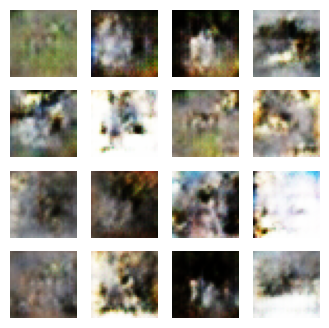

Time for epoch 1741 is 4.680791139602661 sec
Time for epoch 1742 is 3.468425750732422 sec
Time for epoch 1743 is 3.620844841003418 sec
Time for epoch 1744 is 3.621333360671997 sec
Time for epoch 1745 is 3.6213035583496094 sec
Time for epoch 1746 is 3.619173288345337 sec
Time for epoch 1747 is 3.6408441066741943 sec
Time for epoch 1748 is 3.6575980186462402 sec
Time for epoch 1749 is 3.5900676250457764 sec
Time for epoch 1750 is 3.6274049282073975 sec
Time for epoch 1751 is 3.625335931777954 sec
Time for epoch 1752 is 3.63032603263855 sec
Time for epoch 1753 is 3.6446890830993652 sec
Time for epoch 1754 is 3.64306902885437 sec
Time for epoch 1755 is 3.6441240310668945 sec
Time for epoch 1756 is 3.6449549198150635 sec
Time for epoch 1757 is 5.102006673812866 sec
Time for epoch 1758 is 3.4868178367614746 sec
Time for epoch 1759 is 3.6234796047210693 sec
Time for epoch 1760 is 3.6216464042663574 sec


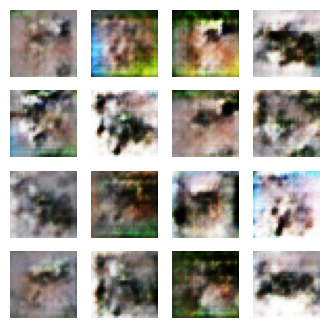

Time for epoch 1761 is 4.155511856079102 sec
Time for epoch 1762 is 5.103560209274292 sec
Time for epoch 1763 is 3.5007104873657227 sec
Time for epoch 1764 is 3.6227023601531982 sec
Time for epoch 1765 is 3.623284339904785 sec
Time for epoch 1766 is 3.658451557159424 sec
Time for epoch 1767 is 3.589170455932617 sec
Time for epoch 1768 is 3.627591133117676 sec
Time for epoch 1769 is 3.6474316120147705 sec
Time for epoch 1770 is 3.6232073307037354 sec
Time for epoch 1771 is 3.646650552749634 sec
Time for epoch 1772 is 3.6745920181274414 sec
Time for epoch 1773 is 3.6212682723999023 sec
Time for epoch 1774 is 3.6494319438934326 sec
Time for epoch 1775 is 3.6456105709075928 sec
Time for epoch 1776 is 3.647576332092285 sec
Time for epoch 1777 is 3.645893096923828 sec
Time for epoch 1778 is 3.6403040885925293 sec
Time for epoch 1779 is 3.643120527267456 sec
Time for epoch 1780 is 3.64388108253479 sec


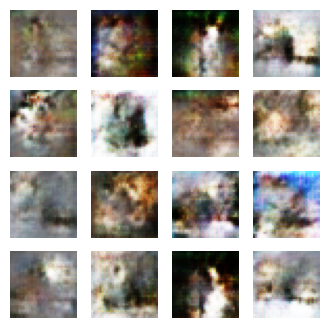

Time for epoch 1781 is 4.166329860687256 sec
Time for epoch 1782 is 3.51127290725708 sec
Time for epoch 1783 is 3.6479854583740234 sec
Time for epoch 1784 is 3.644597053527832 sec
Time for epoch 1785 is 3.6506197452545166 sec
Time for epoch 1786 is 3.597123622894287 sec
Time for epoch 1787 is 3.6360185146331787 sec
Time for epoch 1788 is 3.639639377593994 sec
Time for epoch 1789 is 3.625286102294922 sec
Time for epoch 1790 is 3.634237766265869 sec
Time for epoch 1791 is 3.6438100337982178 sec
Time for epoch 1792 is 3.6517832279205322 sec
Time for epoch 1793 is 3.641874074935913 sec
Time for epoch 1794 is 3.642854928970337 sec
Time for epoch 1795 is 3.6709845066070557 sec
Time for epoch 1796 is 3.6126511096954346 sec
Time for epoch 1797 is 3.6236183643341064 sec
Time for epoch 1798 is 3.6234536170959473 sec
Time for epoch 1799 is 3.6275992393493652 sec
Time for epoch 1800 is 3.6216583251953125 sec


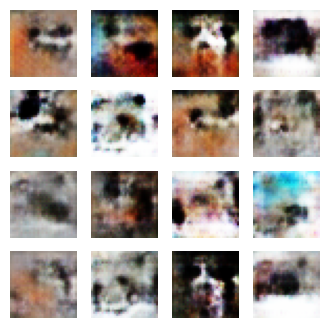

Time for epoch 1801 is 4.172365188598633 sec
Time for epoch 1802 is 3.493966579437256 sec
Time for epoch 1803 is 3.6230340003967285 sec
Time for epoch 1804 is 3.6231002807617188 sec
Time for epoch 1805 is 3.646085262298584 sec
Time for epoch 1806 is 3.6261799335479736 sec
Time for epoch 1807 is 3.620702028274536 sec
Time for epoch 1808 is 3.6267008781433105 sec
Time for epoch 1809 is 3.631648302078247 sec
Time for epoch 1810 is 3.636488199234009 sec
Time for epoch 1811 is 3.6229443550109863 sec
Time for epoch 1812 is 3.625218629837036 sec
Time for epoch 1813 is 3.636620283126831 sec
Time for epoch 1814 is 3.596742630004883 sec
Time for epoch 1815 is 3.633387327194214 sec
Time for epoch 1816 is 3.6730616092681885 sec
Time for epoch 1817 is 3.596022367477417 sec
Time for epoch 1818 is 3.6385886669158936 sec
Time for epoch 1819 is 3.6421570777893066 sec
Time for epoch 1820 is 3.631193161010742 sec


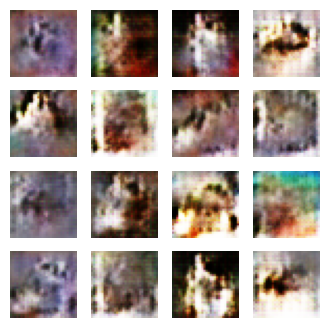

Time for epoch 1821 is 4.365731239318848 sec
Time for epoch 1822 is 3.4957659244537354 sec
Time for epoch 1823 is 3.6264591217041016 sec
Time for epoch 1824 is 3.6259076595306396 sec
Time for epoch 1825 is 3.62782621383667 sec
Time for epoch 1826 is 3.6217432022094727 sec
Time for epoch 1827 is 3.6282386779785156 sec
Time for epoch 1828 is 3.6415936946868896 sec
Time for epoch 1829 is 3.6219348907470703 sec
Time for epoch 1830 is 3.6166412830352783 sec
Time for epoch 1831 is 3.6241371631622314 sec
Time for epoch 1832 is 3.6471688747406006 sec
Time for epoch 1833 is 3.6222963333129883 sec
Time for epoch 1834 is 3.6294443607330322 sec
Time for epoch 1835 is 3.6406121253967285 sec
Time for epoch 1836 is 3.6419026851654053 sec
Time for epoch 1837 is 3.6393983364105225 sec
Time for epoch 1838 is 3.6305150985717773 sec
Time for epoch 1839 is 3.640695095062256 sec
Time for epoch 1840 is 3.6441805362701416 sec


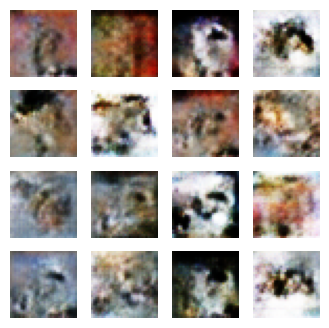

Time for epoch 1841 is 4.2886786460876465 sec
Time for epoch 1842 is 3.503567934036255 sec
Time for epoch 1843 is 3.631657361984253 sec
Time for epoch 1844 is 3.621426820755005 sec
Time for epoch 1845 is 3.6452174186706543 sec
Time for epoch 1846 is 3.6437416076660156 sec
Time for epoch 1847 is 3.6566309928894043 sec
Time for epoch 1848 is 3.5938894748687744 sec
Time for epoch 1849 is 3.6424999237060547 sec
Time for epoch 1850 is 3.675574779510498 sec
Time for epoch 1851 is 3.6240155696868896 sec
Time for epoch 1852 is 3.6099512577056885 sec
Time for epoch 1853 is 3.6443498134613037 sec
Time for epoch 1854 is 3.6486639976501465 sec
Time for epoch 1855 is 3.6447787284851074 sec
Time for epoch 1856 is 3.655327558517456 sec
Time for epoch 1857 is 3.6396210193634033 sec
Time for epoch 1858 is 3.6468536853790283 sec
Time for epoch 1859 is 3.651585340499878 sec
Time for epoch 1860 is 3.6442134380340576 sec


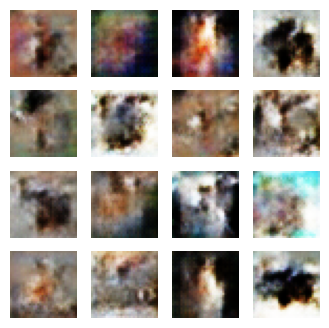

Time for epoch 1861 is 4.370184659957886 sec
Time for epoch 1862 is 3.469404458999634 sec
Time for epoch 1863 is 3.6256814002990723 sec
Time for epoch 1864 is 3.6569550037384033 sec
Time for epoch 1865 is 3.6483569145202637 sec
Time for epoch 1866 is 3.6397600173950195 sec
Time for epoch 1867 is 3.6709964275360107 sec
Time for epoch 1868 is 3.5627501010894775 sec
Time for epoch 1869 is 3.6473724842071533 sec
Time for epoch 1870 is 3.649780750274658 sec
Time for epoch 1871 is 3.6399922370910645 sec
Time for epoch 1872 is 3.642796039581299 sec
Time for epoch 1873 is 3.6461291313171387 sec
Time for epoch 1874 is 3.6364855766296387 sec
Time for epoch 1875 is 3.651301860809326 sec
Time for epoch 1876 is 3.676259994506836 sec
Time for epoch 1877 is 3.590778350830078 sec
Time for epoch 1878 is 3.6431753635406494 sec
Time for epoch 1879 is 3.6404333114624023 sec
Time for epoch 1880 is 3.649590015411377 sec


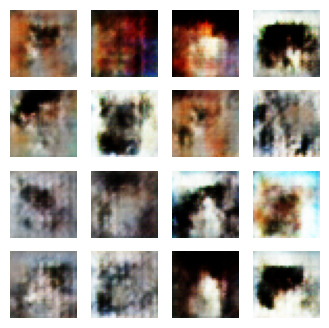

Time for epoch 1881 is 4.167140483856201 sec
Time for epoch 1882 is 3.4936115741729736 sec
Time for epoch 1883 is 3.64113712310791 sec
Time for epoch 1884 is 3.6668219566345215 sec
Time for epoch 1885 is 3.6209371089935303 sec
Time for epoch 1886 is 3.6454379558563232 sec
Time for epoch 1887 is 3.6448285579681396 sec
Time for epoch 1888 is 3.642940044403076 sec
Time for epoch 1889 is 3.6510393619537354 sec
Time for epoch 1890 is 3.6576130390167236 sec
Time for epoch 1891 is 3.65346622467041 sec
Time for epoch 1892 is 3.6536190509796143 sec
Time for epoch 1893 is 3.6534013748168945 sec
Time for epoch 1894 is 3.6522772312164307 sec
Time for epoch 1895 is 3.651362419128418 sec
Time for epoch 1896 is 3.635446548461914 sec
Time for epoch 1897 is 3.648895740509033 sec
Time for epoch 1898 is 3.651747703552246 sec
Time for epoch 1899 is 3.6686179637908936 sec
Time for epoch 1900 is 3.620347499847412 sec


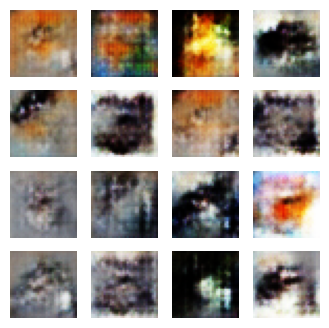

Time for epoch 1901 is 4.173751592636108 sec
Time for epoch 1902 is 3.5514214038848877 sec
Time for epoch 1903 is 3.60654878616333 sec
Time for epoch 1904 is 3.6716277599334717 sec
Time for epoch 1905 is 3.6128954887390137 sec
Time for epoch 1906 is 3.625767946243286 sec
Time for epoch 1907 is 3.6438302993774414 sec
Time for epoch 1908 is 3.66323184967041 sec
Time for epoch 1909 is 3.607351303100586 sec
Time for epoch 1910 is 3.6428744792938232 sec
Time for epoch 1911 is 3.647383213043213 sec
Time for epoch 1912 is 3.638045310974121 sec
Time for epoch 1913 is 3.6267659664154053 sec
Time for epoch 1914 is 3.6498970985412598 sec
Time for epoch 1915 is 3.638056755065918 sec
Time for epoch 1916 is 3.643145799636841 sec
Time for epoch 1917 is 3.6382930278778076 sec
Time for epoch 1918 is 3.643918991088867 sec
Time for epoch 1919 is 3.649104595184326 sec
Time for epoch 1920 is 3.6541130542755127 sec


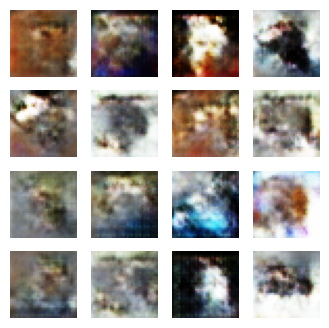

Time for epoch 1921 is 4.407871246337891 sec
Time for epoch 1922 is 3.4972176551818848 sec
Time for epoch 1923 is 3.620201826095581 sec
Time for epoch 1924 is 3.6572139263153076 sec
Time for epoch 1925 is 3.589984178543091 sec
Time for epoch 1926 is 3.620685338973999 sec
Time for epoch 1927 is 3.622509479522705 sec
Time for epoch 1928 is 3.625572443008423 sec
Time for epoch 1929 is 3.618741989135742 sec
Time for epoch 1930 is 3.6227614879608154 sec
Time for epoch 1931 is 3.625380039215088 sec
Time for epoch 1932 is 3.619197368621826 sec
Time for epoch 1933 is 3.627514362335205 sec
Time for epoch 1934 is 3.6247410774230957 sec
Time for epoch 1935 is 3.665442943572998 sec
Time for epoch 1936 is 3.589337110519409 sec
Time for epoch 1937 is 3.6239051818847656 sec
Time for epoch 1938 is 3.622551441192627 sec
Time for epoch 1939 is 3.6233713626861572 sec
Time for epoch 1940 is 3.6228508949279785 sec


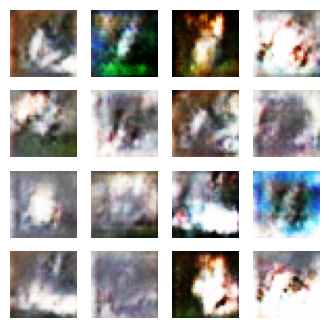

Time for epoch 1941 is 4.1389851570129395 sec
Time for epoch 1942 is 3.506354808807373 sec
Time for epoch 1943 is 3.642167806625366 sec
Time for epoch 1944 is 3.6204633712768555 sec
Time for epoch 1945 is 3.6219539642333984 sec
Time for epoch 1946 is 3.651977777481079 sec
Time for epoch 1947 is 3.5881290435791016 sec
Time for epoch 1948 is 3.624810218811035 sec
Time for epoch 1949 is 3.6219897270202637 sec
Time for epoch 1950 is 3.654986619949341 sec
Time for epoch 1951 is 3.5881540775299072 sec
Time for epoch 1952 is 3.6262128353118896 sec
Time for epoch 1953 is 3.6252903938293457 sec
Time for epoch 1954 is 3.627897262573242 sec
Time for epoch 1955 is 3.6193294525146484 sec
Time for epoch 1956 is 3.622112989425659 sec
Time for epoch 1957 is 5.1020567417144775 sec
Time for epoch 1958 is 3.48610520362854 sec
Time for epoch 1959 is 3.6242165565490723 sec
Time for epoch 1960 is 3.6239538192749023 sec


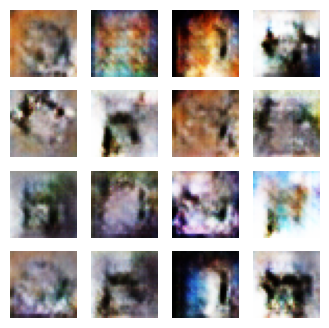

Time for epoch 1961 is 4.158646821975708 sec
Time for epoch 1962 is 3.4874956607818604 sec
Time for epoch 1963 is 3.6234514713287354 sec
Time for epoch 1964 is 3.6205742359161377 sec
Time for epoch 1965 is 3.6408674716949463 sec
Time for epoch 1966 is 3.6327030658721924 sec
Time for epoch 1967 is 3.631106376647949 sec
Time for epoch 1968 is 3.644885301589966 sec
Time for epoch 1969 is 3.624946117401123 sec
Time for epoch 1970 is 3.6452910900115967 sec
Time for epoch 1971 is 3.6296815872192383 sec
Time for epoch 1972 is 3.649235963821411 sec
Time for epoch 1973 is 3.6432929039001465 sec
Time for epoch 1974 is 3.671274185180664 sec
Time for epoch 1975 is 3.620026111602783 sec
Time for epoch 1976 is 3.6372408866882324 sec
Time for epoch 1977 is 3.641826629638672 sec
Time for epoch 1978 is 3.625088691711426 sec
Time for epoch 1979 is 3.656020164489746 sec
Time for epoch 1980 is 3.6028175354003906 sec


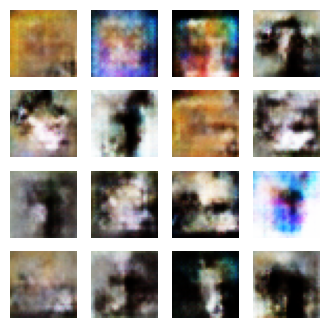

Time for epoch 1981 is 4.163800954818726 sec
Time for epoch 1982 is 3.4974801540374756 sec
Time for epoch 1983 is 3.6267292499542236 sec
Time for epoch 1984 is 3.6180062294006348 sec
Time for epoch 1985 is 3.6212317943573 sec
Time for epoch 1986 is 3.6570746898651123 sec
Time for epoch 1987 is 3.586977005004883 sec
Time for epoch 1988 is 3.6210439205169678 sec
Time for epoch 1989 is 3.596717357635498 sec
Time for epoch 1990 is 3.635383367538452 sec
Time for epoch 1991 is 3.622849464416504 sec
Time for epoch 1992 is 3.6221964359283447 sec
Time for epoch 1993 is 3.6216769218444824 sec
Time for epoch 1994 is 3.65419864654541 sec
Time for epoch 1995 is 3.5863990783691406 sec
Time for epoch 1996 is 3.6248250007629395 sec
Time for epoch 1997 is 3.6244912147521973 sec
Time for epoch 1998 is 3.6174614429473877 sec
Time for epoch 1999 is 3.6207478046417236 sec
Time for epoch 2000 is 3.6225743293762207 sec


In [36]:
train(train_dataset, 2000)